# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [2]:
!mkdir data

mkdir: cannot create directory ‘data’: File exists


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [3]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [4]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

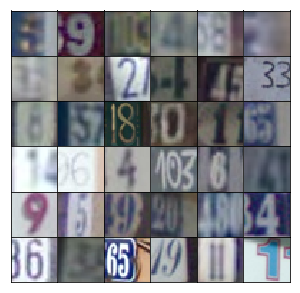

In [5]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [6]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [7]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [8]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3. 

>**Exercise:** Build the transposed convolutional network for the generator in the function below. Be sure to use leaky ReLUs on all the layers except for the last tanh layer, as well as batch normalization on all the transposed convolutional layers except the last one.

In [34]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        
        def leaky_relu(x, alpha):
            return tf.maximum(x * alpha, x)
        
        # First fully connected layer
        l1 = tf.layers.dense(z, 4*4*512)
        l1_rs = tf.reshape(l1, (-1, 4, 4, 512))
        l1_bn = tf.layers.batch_normalization(l1_rs, training=training)
        l1_ac = leaky_relu(l1_bn, alpha)
        # 4x4x512
        
        l2 = tf.layers.conv2d_transpose(l1_ac, 256, 5, strides=2, padding='same')
        l2_bn = tf.layers.batch_normalization(l2, training=training)
        l2_ac = leaky_relu(l2_bn, alpha)
        # 8x8x256
        
        l3 = tf.layers.conv2d_transpose(l2_ac, 128, 5, strides=2, padding='same')
        l3_bn = tf.layers.batch_normalization(l3, training=training)
        l3_ac = leaky_relu(l3_bn, alpha)
        # 16x16x128
        
        # Output layer, 32x32x3
        logits = tf.layers.conv2d_transpose(l3_ac, output_dim, 5, strides=2, padding='same')
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've built before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU.

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

>**Exercise:** Build the convolutional network for the discriminator. The input is a 32x32x3 images, the output is a sigmoid plus the logits. Again, use Leaky ReLU activations and batch normalization on all the layers except the first.

In [35]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        
        def leaky_relu(x, alpha):
            return tf.maximum(x * alpha, x)
        
        # Input layer is 32x32x3
        l1 = tf.layers.conv2d(x, 64, 5, strides=2, padding='same')
        l1_ac = leaky_relu(l1, alpha)
        # 16x16x64
        
        l2 = tf.layers.conv2d(l1_ac, 128, 5, strides=2, padding='same')
        l2_bn = tf.layers.batch_normalization(l2, training=True)
        l2_ac = leaky_relu(l2_bn, alpha)
        # 8x8x128
        
        l3 = tf.layers.conv2d(l2_ac, 256, 5, strides=2, padding='same')
        l3_bn = tf.layers.batch_normalization(l3, training=True)
        l3_ac = leaky_relu(l3_bn, alpha)
        
        l3_rs = tf.reshape(l3_ac, (-1, 4*4*256))
        
        logits = tf.layers.dense(l3_rs, 1)
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [36]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)*0.9))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [37]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [38]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=0.2)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [39]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [40]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

>**Exercise:** Find hyperparameters to train this GAN. The values found in the DCGAN paper work well, or you can experiment on your own. In general, you want the discriminator loss to be around 0.3, this means it is correctly classifying images as fake or real about 50% of the time.

In [47]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002
batch_size = 128
epochs = 25
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/25... Discriminator Loss: 1.5523... Generator Loss: 0.6796
Epoch 1/25... Discriminator Loss: 0.5303... Generator Loss: 2.7580
Epoch 1/25... Discriminator Loss: 0.4119... Generator Loss: 2.7416
Epoch 1/25... Discriminator Loss: 0.4188... Generator Loss: 2.9437
Epoch 1/25... Discriminator Loss: 0.4351... Generator Loss: 2.9127
Epoch 1/25... Discriminator Loss: 0.3828... Generator Loss: 3.3932
Epoch 1/25... Discriminator Loss: 0.4203... Generator Loss: 2.8974
Epoch 1/25... Discriminator Loss: 0.8787... Generator Loss: 2.4417
Epoch 1/25... Discriminator Loss: 1.0300... Generator Loss: 1.3526
Epoch 1/25... Discriminator Loss: 0.9143... Generator Loss: 1.7956


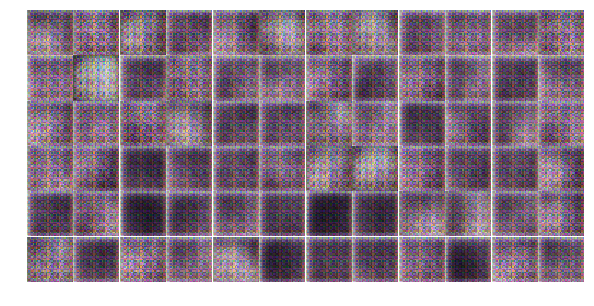

Epoch 1/25... Discriminator Loss: 0.8031... Generator Loss: 1.5893
Epoch 1/25... Discriminator Loss: 0.6152... Generator Loss: 2.0794
Epoch 1/25... Discriminator Loss: 0.7560... Generator Loss: 1.4377
Epoch 1/25... Discriminator Loss: 0.6988... Generator Loss: 2.9206
Epoch 1/25... Discriminator Loss: 0.9000... Generator Loss: 1.1881
Epoch 1/25... Discriminator Loss: 0.7033... Generator Loss: 1.4786
Epoch 1/25... Discriminator Loss: 0.5035... Generator Loss: 2.6059
Epoch 1/25... Discriminator Loss: 0.6188... Generator Loss: 2.1243
Epoch 1/25... Discriminator Loss: 0.9905... Generator Loss: 3.9789
Epoch 1/25... Discriminator Loss: 1.3578... Generator Loss: 1.7285


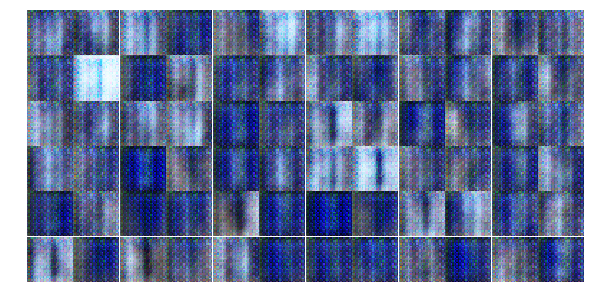

Epoch 1/25... Discriminator Loss: 1.3112... Generator Loss: 0.5542
Epoch 1/25... Discriminator Loss: 0.6646... Generator Loss: 1.6082
Epoch 1/25... Discriminator Loss: 0.5954... Generator Loss: 2.1208
Epoch 1/25... Discriminator Loss: 0.5992... Generator Loss: 1.7362
Epoch 1/25... Discriminator Loss: 0.6951... Generator Loss: 3.8820
Epoch 1/25... Discriminator Loss: 0.8563... Generator Loss: 1.5103
Epoch 1/25... Discriminator Loss: 2.1579... Generator Loss: 4.0994
Epoch 1/25... Discriminator Loss: 0.5605... Generator Loss: 2.1904
Epoch 1/25... Discriminator Loss: 0.7308... Generator Loss: 1.7297
Epoch 1/25... Discriminator Loss: 0.8018... Generator Loss: 4.6747


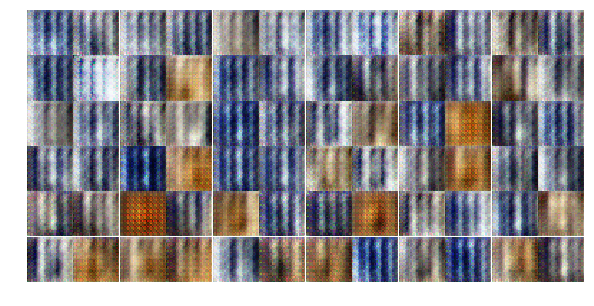

Epoch 1/25... Discriminator Loss: 1.0186... Generator Loss: 0.9542
Epoch 1/25... Discriminator Loss: 0.7972... Generator Loss: 2.2753
Epoch 1/25... Discriminator Loss: 0.7682... Generator Loss: 1.3041
Epoch 1/25... Discriminator Loss: 0.7360... Generator Loss: 2.2556
Epoch 1/25... Discriminator Loss: 0.7370... Generator Loss: 2.4434
Epoch 1/25... Discriminator Loss: 0.5036... Generator Loss: 2.7746
Epoch 1/25... Discriminator Loss: 0.9829... Generator Loss: 0.9616
Epoch 1/25... Discriminator Loss: 0.7071... Generator Loss: 1.6640
Epoch 1/25... Discriminator Loss: 0.7754... Generator Loss: 1.5647
Epoch 1/25... Discriminator Loss: 0.8222... Generator Loss: 1.6007


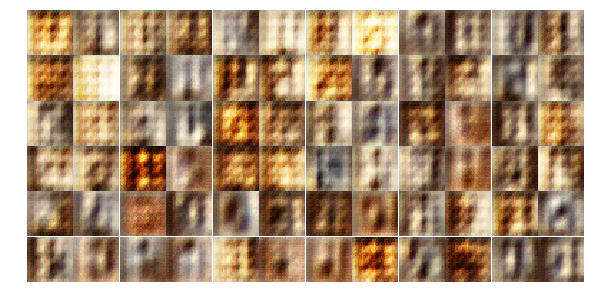

Epoch 1/25... Discriminator Loss: 0.7245... Generator Loss: 1.8992
Epoch 1/25... Discriminator Loss: 0.9451... Generator Loss: 1.7791
Epoch 1/25... Discriminator Loss: 0.7788... Generator Loss: 1.5723
Epoch 1/25... Discriminator Loss: 0.8652... Generator Loss: 1.2620
Epoch 1/25... Discriminator Loss: 0.8308... Generator Loss: 1.6256
Epoch 1/25... Discriminator Loss: 0.7642... Generator Loss: 1.6298
Epoch 1/25... Discriminator Loss: 0.6908... Generator Loss: 1.7674
Epoch 1/25... Discriminator Loss: 0.8673... Generator Loss: 1.5636
Epoch 1/25... Discriminator Loss: 0.6954... Generator Loss: 1.8901
Epoch 1/25... Discriminator Loss: 1.0138... Generator Loss: 1.2873


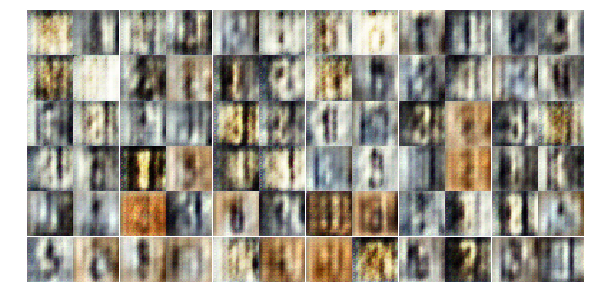

Epoch 1/25... Discriminator Loss: 0.7132... Generator Loss: 1.6682
Epoch 1/25... Discriminator Loss: 0.7675... Generator Loss: 1.8085
Epoch 1/25... Discriminator Loss: 0.7049... Generator Loss: 2.0005
Epoch 1/25... Discriminator Loss: 1.1154... Generator Loss: 1.0492
Epoch 1/25... Discriminator Loss: 0.8192... Generator Loss: 1.5923
Epoch 1/25... Discriminator Loss: 0.8725... Generator Loss: 1.3395
Epoch 1/25... Discriminator Loss: 1.1320... Generator Loss: 1.8681
Epoch 2/25... Discriminator Loss: 1.2288... Generator Loss: 1.4980
Epoch 2/25... Discriminator Loss: 0.8728... Generator Loss: 1.4178
Epoch 2/25... Discriminator Loss: 1.3949... Generator Loss: 0.7651


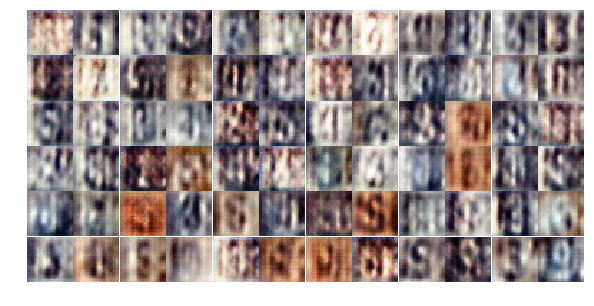

Epoch 2/25... Discriminator Loss: 1.0976... Generator Loss: 1.9955
Epoch 2/25... Discriminator Loss: 1.2989... Generator Loss: 1.6598
Epoch 2/25... Discriminator Loss: 0.8760... Generator Loss: 1.2540
Epoch 2/25... Discriminator Loss: 1.1805... Generator Loss: 0.9303
Epoch 2/25... Discriminator Loss: 0.9536... Generator Loss: 1.6161
Epoch 2/25... Discriminator Loss: 1.0929... Generator Loss: 1.1666
Epoch 2/25... Discriminator Loss: 1.1141... Generator Loss: 1.1144
Epoch 2/25... Discriminator Loss: 1.2267... Generator Loss: 0.8056
Epoch 2/25... Discriminator Loss: 0.9620... Generator Loss: 1.4775
Epoch 2/25... Discriminator Loss: 0.9349... Generator Loss: 1.4905


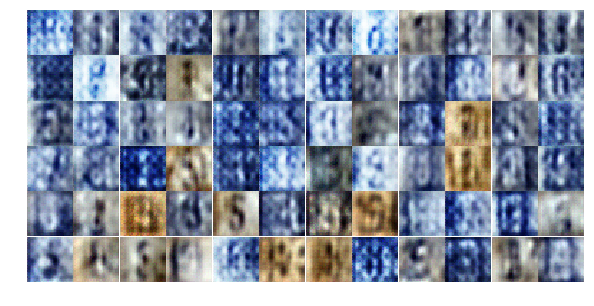

Epoch 2/25... Discriminator Loss: 0.9932... Generator Loss: 1.7838
Epoch 2/25... Discriminator Loss: 1.0930... Generator Loss: 1.7547
Epoch 2/25... Discriminator Loss: 1.3790... Generator Loss: 1.5181
Epoch 2/25... Discriminator Loss: 1.0799... Generator Loss: 1.1540
Epoch 2/25... Discriminator Loss: 1.0943... Generator Loss: 1.2674
Epoch 2/25... Discriminator Loss: 1.2027... Generator Loss: 0.8723
Epoch 2/25... Discriminator Loss: 0.9986... Generator Loss: 1.3408
Epoch 2/25... Discriminator Loss: 1.1638... Generator Loss: 0.9415
Epoch 2/25... Discriminator Loss: 1.1357... Generator Loss: 1.1405
Epoch 2/25... Discriminator Loss: 1.1284... Generator Loss: 0.9843


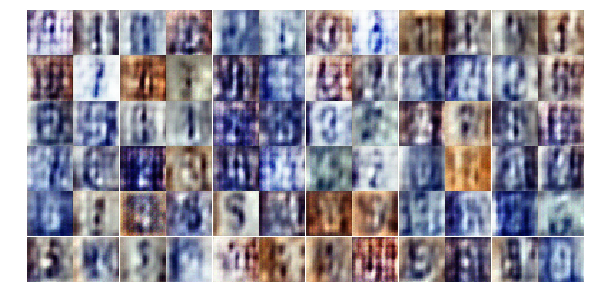

Epoch 2/25... Discriminator Loss: 1.1441... Generator Loss: 1.0948
Epoch 2/25... Discriminator Loss: 0.8927... Generator Loss: 1.4773
Epoch 2/25... Discriminator Loss: 1.0337... Generator Loss: 1.3451
Epoch 2/25... Discriminator Loss: 1.0317... Generator Loss: 1.4165
Epoch 2/25... Discriminator Loss: 1.0269... Generator Loss: 1.6933
Epoch 2/25... Discriminator Loss: 1.0656... Generator Loss: 1.0547
Epoch 2/25... Discriminator Loss: 1.1935... Generator Loss: 0.9274
Epoch 2/25... Discriminator Loss: 1.2194... Generator Loss: 0.7777
Epoch 2/25... Discriminator Loss: 1.0013... Generator Loss: 1.0756
Epoch 2/25... Discriminator Loss: 0.9035... Generator Loss: 1.4621


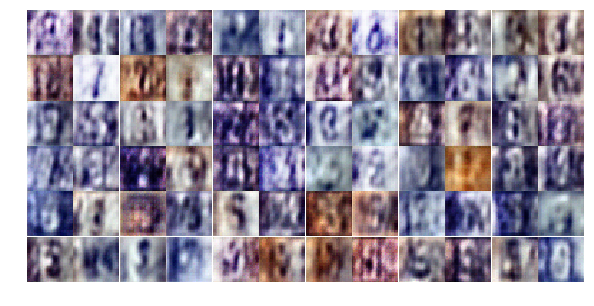

Epoch 2/25... Discriminator Loss: 0.8920... Generator Loss: 1.9053
Epoch 2/25... Discriminator Loss: 1.1592... Generator Loss: 1.1979
Epoch 2/25... Discriminator Loss: 1.3319... Generator Loss: 0.7185
Epoch 2/25... Discriminator Loss: 1.4559... Generator Loss: 0.6749
Epoch 2/25... Discriminator Loss: 1.1240... Generator Loss: 1.2258
Epoch 2/25... Discriminator Loss: 1.2888... Generator Loss: 0.8388
Epoch 2/25... Discriminator Loss: 1.1019... Generator Loss: 1.1327
Epoch 2/25... Discriminator Loss: 1.1755... Generator Loss: 1.0961
Epoch 2/25... Discriminator Loss: 1.1113... Generator Loss: 1.1524
Epoch 2/25... Discriminator Loss: 1.0644... Generator Loss: 1.2457


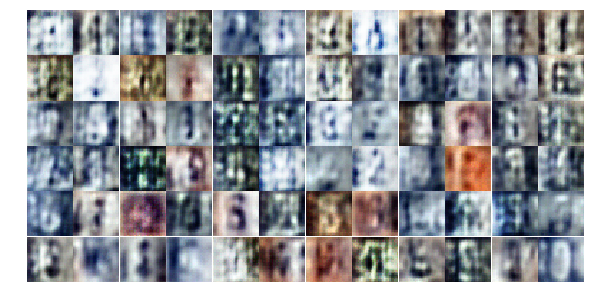

Epoch 2/25... Discriminator Loss: 0.8310... Generator Loss: 1.5937
Epoch 2/25... Discriminator Loss: 1.2602... Generator Loss: 0.9867
Epoch 2/25... Discriminator Loss: 1.0327... Generator Loss: 1.1296
Epoch 2/25... Discriminator Loss: 1.6423... Generator Loss: 0.5636
Epoch 2/25... Discriminator Loss: 0.9568... Generator Loss: 1.1415
Epoch 2/25... Discriminator Loss: 1.2880... Generator Loss: 0.7198
Epoch 2/25... Discriminator Loss: 1.0138... Generator Loss: 1.9289
Epoch 2/25... Discriminator Loss: 1.0547... Generator Loss: 2.0853
Epoch 2/25... Discriminator Loss: 0.7650... Generator Loss: 1.4668
Epoch 2/25... Discriminator Loss: 0.9504... Generator Loss: 1.4702


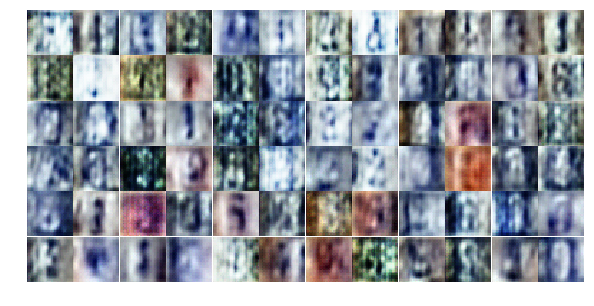

Epoch 2/25... Discriminator Loss: 0.9148... Generator Loss: 1.3142
Epoch 2/25... Discriminator Loss: 0.7493... Generator Loss: 1.4021
Epoch 2/25... Discriminator Loss: 1.1921... Generator Loss: 0.7330
Epoch 2/25... Discriminator Loss: 0.9197... Generator Loss: 1.4357
Epoch 3/25... Discriminator Loss: 1.1360... Generator Loss: 2.2819
Epoch 3/25... Discriminator Loss: 0.9820... Generator Loss: 1.2595
Epoch 3/25... Discriminator Loss: 0.8311... Generator Loss: 1.6882
Epoch 3/25... Discriminator Loss: 0.7418... Generator Loss: 1.5217
Epoch 3/25... Discriminator Loss: 1.2930... Generator Loss: 3.5100
Epoch 3/25... Discriminator Loss: 0.9061... Generator Loss: 1.1555


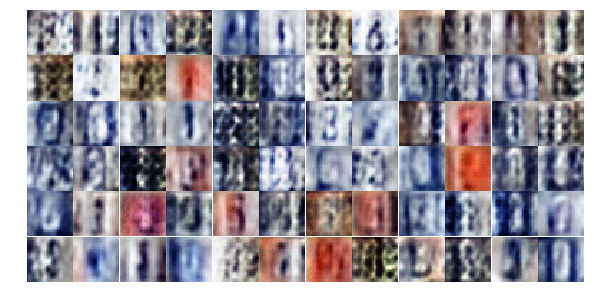

Epoch 3/25... Discriminator Loss: 0.8675... Generator Loss: 1.9715
Epoch 3/25... Discriminator Loss: 0.7982... Generator Loss: 1.5104
Epoch 3/25... Discriminator Loss: 0.9460... Generator Loss: 2.2286
Epoch 3/25... Discriminator Loss: 0.9032... Generator Loss: 1.0656
Epoch 3/25... Discriminator Loss: 1.1627... Generator Loss: 0.6924
Epoch 3/25... Discriminator Loss: 1.0997... Generator Loss: 0.7530
Epoch 3/25... Discriminator Loss: 0.5637... Generator Loss: 2.1240
Epoch 3/25... Discriminator Loss: 1.3378... Generator Loss: 0.5863
Epoch 3/25... Discriminator Loss: 1.0477... Generator Loss: 0.7928
Epoch 3/25... Discriminator Loss: 0.8263... Generator Loss: 1.2079


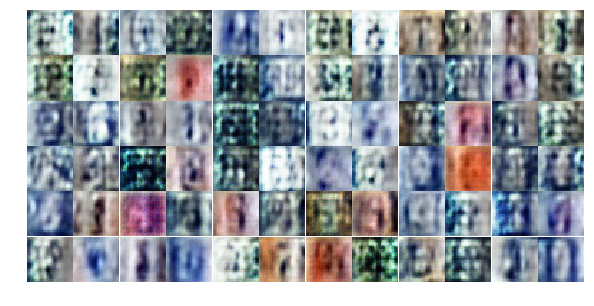

Epoch 3/25... Discriminator Loss: 0.7834... Generator Loss: 2.6943
Epoch 3/25... Discriminator Loss: 0.5940... Generator Loss: 2.2457
Epoch 3/25... Discriminator Loss: 0.7635... Generator Loss: 1.3133
Epoch 3/25... Discriminator Loss: 0.4679... Generator Loss: 2.3567
Epoch 3/25... Discriminator Loss: 0.7716... Generator Loss: 1.3731
Epoch 3/25... Discriminator Loss: 0.9779... Generator Loss: 1.5669
Epoch 3/25... Discriminator Loss: 0.7039... Generator Loss: 1.6545
Epoch 3/25... Discriminator Loss: 0.9681... Generator Loss: 1.9560
Epoch 3/25... Discriminator Loss: 0.5111... Generator Loss: 2.2900
Epoch 3/25... Discriminator Loss: 0.7364... Generator Loss: 1.3507


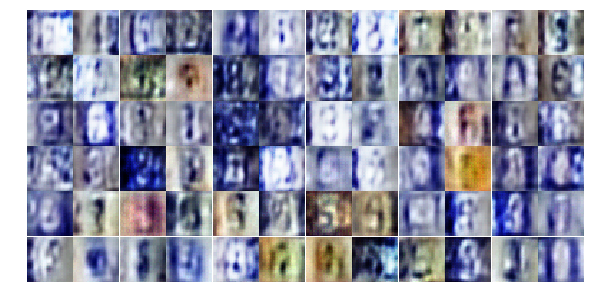

Epoch 3/25... Discriminator Loss: 0.7216... Generator Loss: 2.5065
Epoch 3/25... Discriminator Loss: 1.2308... Generator Loss: 0.6400
Epoch 3/25... Discriminator Loss: 0.6325... Generator Loss: 1.9951
Epoch 3/25... Discriminator Loss: 0.5906... Generator Loss: 1.7273
Epoch 3/25... Discriminator Loss: 0.7949... Generator Loss: 2.4148
Epoch 3/25... Discriminator Loss: 0.8236... Generator Loss: 1.5713
Epoch 3/25... Discriminator Loss: 0.9005... Generator Loss: 1.2953
Epoch 3/25... Discriminator Loss: 1.0126... Generator Loss: 3.2593
Epoch 3/25... Discriminator Loss: 0.9567... Generator Loss: 0.9388
Epoch 3/25... Discriminator Loss: 0.8573... Generator Loss: 1.0641


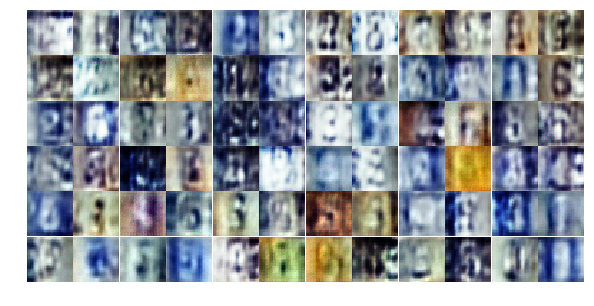

Epoch 3/25... Discriminator Loss: 1.3454... Generator Loss: 0.6034
Epoch 3/25... Discriminator Loss: 0.6214... Generator Loss: 1.8098
Epoch 3/25... Discriminator Loss: 1.1681... Generator Loss: 2.8739
Epoch 3/25... Discriminator Loss: 0.7739... Generator Loss: 1.4215
Epoch 3/25... Discriminator Loss: 1.0506... Generator Loss: 2.4636
Epoch 3/25... Discriminator Loss: 1.1327... Generator Loss: 0.7637
Epoch 3/25... Discriminator Loss: 0.7683... Generator Loss: 1.6177
Epoch 3/25... Discriminator Loss: 0.7607... Generator Loss: 1.3266
Epoch 3/25... Discriminator Loss: 0.9153... Generator Loss: 1.1011
Epoch 3/25... Discriminator Loss: 0.7139... Generator Loss: 1.5035


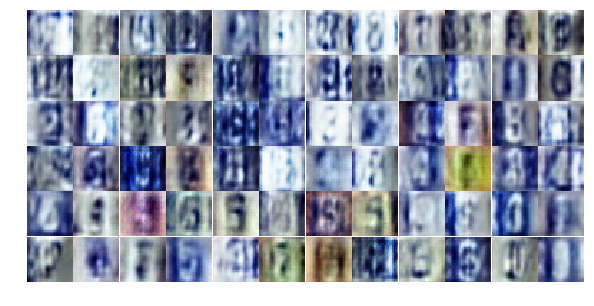

Epoch 3/25... Discriminator Loss: 1.5015... Generator Loss: 0.4607
Epoch 3/25... Discriminator Loss: 0.8522... Generator Loss: 1.1901
Epoch 3/25... Discriminator Loss: 0.7136... Generator Loss: 1.4011
Epoch 3/25... Discriminator Loss: 1.0226... Generator Loss: 0.9360
Epoch 3/25... Discriminator Loss: 0.6953... Generator Loss: 2.7511
Epoch 3/25... Discriminator Loss: 0.7346... Generator Loss: 3.6761
Epoch 3/25... Discriminator Loss: 0.8429... Generator Loss: 2.6089
Epoch 3/25... Discriminator Loss: 0.7124... Generator Loss: 1.4899
Epoch 3/25... Discriminator Loss: 0.8018... Generator Loss: 1.7700
Epoch 3/25... Discriminator Loss: 0.9383... Generator Loss: 1.1272


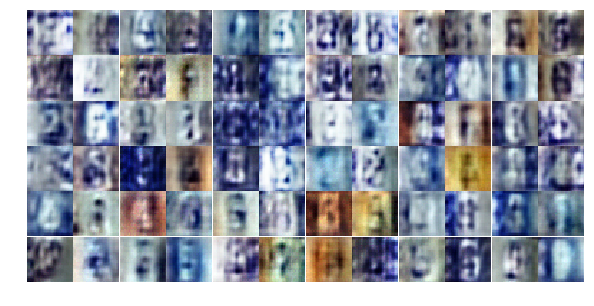

Epoch 3/25... Discriminator Loss: 0.9701... Generator Loss: 1.5304
Epoch 4/25... Discriminator Loss: 1.1984... Generator Loss: 0.7838
Epoch 4/25... Discriminator Loss: 0.7224... Generator Loss: 1.5402
Epoch 4/25... Discriminator Loss: 0.8370... Generator Loss: 1.6014
Epoch 4/25... Discriminator Loss: 0.7751... Generator Loss: 1.9154
Epoch 4/25... Discriminator Loss: 0.6975... Generator Loss: 1.5623
Epoch 4/25... Discriminator Loss: 1.1912... Generator Loss: 0.6897
Epoch 4/25... Discriminator Loss: 0.6226... Generator Loss: 1.7026
Epoch 4/25... Discriminator Loss: 1.0372... Generator Loss: 3.0376
Epoch 4/25... Discriminator Loss: 0.8127... Generator Loss: 2.2730


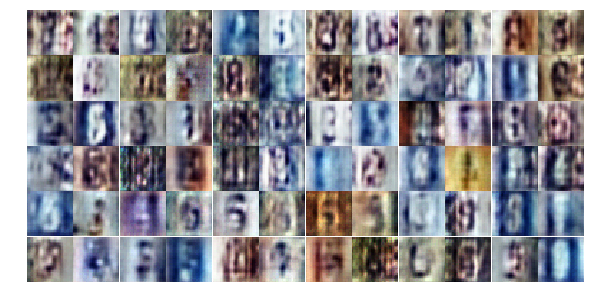

Epoch 4/25... Discriminator Loss: 0.7341... Generator Loss: 1.3740
Epoch 4/25... Discriminator Loss: 0.7788... Generator Loss: 1.7598
Epoch 4/25... Discriminator Loss: 0.8130... Generator Loss: 1.4185
Epoch 4/25... Discriminator Loss: 0.4564... Generator Loss: 3.6743
Epoch 4/25... Discriminator Loss: 1.4859... Generator Loss: 2.6596
Epoch 4/25... Discriminator Loss: 0.9160... Generator Loss: 1.0300
Epoch 4/25... Discriminator Loss: 0.5847... Generator Loss: 2.1405
Epoch 4/25... Discriminator Loss: 0.7763... Generator Loss: 1.3570
Epoch 4/25... Discriminator Loss: 0.7859... Generator Loss: 1.6250
Epoch 4/25... Discriminator Loss: 0.7777... Generator Loss: 2.8446


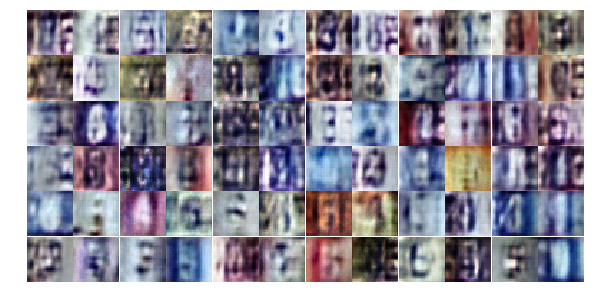

Epoch 4/25... Discriminator Loss: 1.3379... Generator Loss: 0.7048
Epoch 4/25... Discriminator Loss: 0.7878... Generator Loss: 2.5008
Epoch 4/25... Discriminator Loss: 0.6231... Generator Loss: 1.8105
Epoch 4/25... Discriminator Loss: 0.4951... Generator Loss: 2.1829
Epoch 4/25... Discriminator Loss: 1.0256... Generator Loss: 1.0437
Epoch 4/25... Discriminator Loss: 0.5799... Generator Loss: 2.2018
Epoch 4/25... Discriminator Loss: 1.1226... Generator Loss: 0.7525
Epoch 4/25... Discriminator Loss: 0.7127... Generator Loss: 1.5673
Epoch 4/25... Discriminator Loss: 0.8131... Generator Loss: 1.1730
Epoch 4/25... Discriminator Loss: 0.6283... Generator Loss: 1.8160


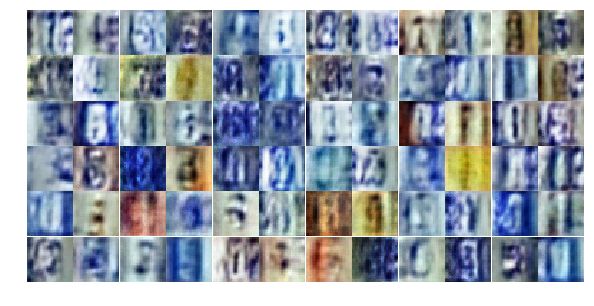

Epoch 4/25... Discriminator Loss: 0.5023... Generator Loss: 2.5173
Epoch 4/25... Discriminator Loss: 0.9728... Generator Loss: 1.8440
Epoch 4/25... Discriminator Loss: 0.7559... Generator Loss: 1.3870
Epoch 4/25... Discriminator Loss: 0.6611... Generator Loss: 1.8972
Epoch 4/25... Discriminator Loss: 0.9797... Generator Loss: 0.9153
Epoch 4/25... Discriminator Loss: 0.7748... Generator Loss: 1.1820
Epoch 4/25... Discriminator Loss: 1.0905... Generator Loss: 2.2291
Epoch 4/25... Discriminator Loss: 0.5413... Generator Loss: 2.5489
Epoch 4/25... Discriminator Loss: 0.5876... Generator Loss: 2.1585
Epoch 4/25... Discriminator Loss: 0.5134... Generator Loss: 2.2511


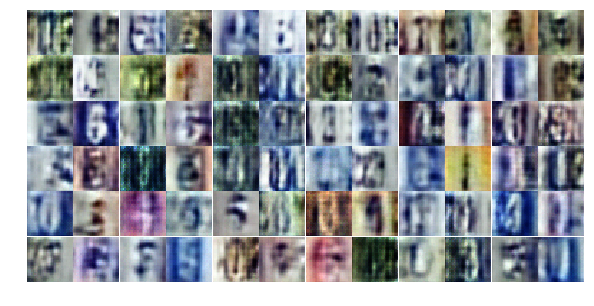

Epoch 4/25... Discriminator Loss: 0.6479... Generator Loss: 2.5868
Epoch 4/25... Discriminator Loss: 0.8597... Generator Loss: 1.0763
Epoch 4/25... Discriminator Loss: 1.2541... Generator Loss: 0.6058
Epoch 4/25... Discriminator Loss: 0.8476... Generator Loss: 1.3764
Epoch 4/25... Discriminator Loss: 0.5191... Generator Loss: 2.6066
Epoch 4/25... Discriminator Loss: 1.7932... Generator Loss: 3.9592
Epoch 4/25... Discriminator Loss: 1.0111... Generator Loss: 1.7398
Epoch 4/25... Discriminator Loss: 0.9635... Generator Loss: 1.3613
Epoch 4/25... Discriminator Loss: 0.8103... Generator Loss: 1.1905
Epoch 4/25... Discriminator Loss: 0.7641... Generator Loss: 1.5908


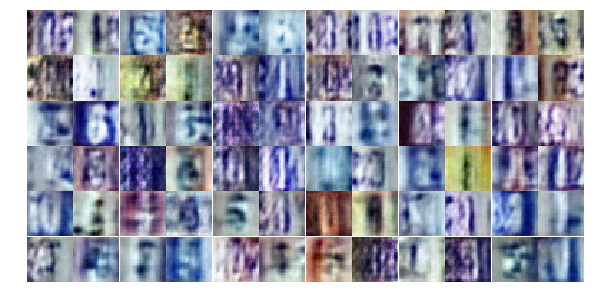

Epoch 4/25... Discriminator Loss: 0.6879... Generator Loss: 1.8036
Epoch 4/25... Discriminator Loss: 0.7497... Generator Loss: 2.0974
Epoch 4/25... Discriminator Loss: 0.8300... Generator Loss: 1.6063
Epoch 4/25... Discriminator Loss: 0.7669... Generator Loss: 2.4185
Epoch 4/25... Discriminator Loss: 0.9103... Generator Loss: 1.1105
Epoch 4/25... Discriminator Loss: 0.8059... Generator Loss: 1.3012
Epoch 4/25... Discriminator Loss: 0.6619... Generator Loss: 1.5782
Epoch 4/25... Discriminator Loss: 0.8577... Generator Loss: 1.0867
Epoch 4/25... Discriminator Loss: 0.7522... Generator Loss: 2.1305
Epoch 5/25... Discriminator Loss: 0.7946... Generator Loss: 1.1976


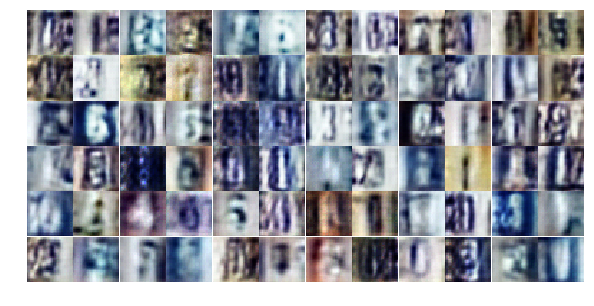

Epoch 5/25... Discriminator Loss: 0.5719... Generator Loss: 2.0300
Epoch 5/25... Discriminator Loss: 0.6602... Generator Loss: 1.7462
Epoch 5/25... Discriminator Loss: 0.9968... Generator Loss: 0.8730
Epoch 5/25... Discriminator Loss: 0.8760... Generator Loss: 2.3240
Epoch 5/25... Discriminator Loss: 1.0639... Generator Loss: 3.0532
Epoch 5/25... Discriminator Loss: 0.9007... Generator Loss: 1.0994
Epoch 5/25... Discriminator Loss: 0.8144... Generator Loss: 2.4983
Epoch 5/25... Discriminator Loss: 0.5979... Generator Loss: 1.7679
Epoch 5/25... Discriminator Loss: 0.8659... Generator Loss: 1.0915
Epoch 5/25... Discriminator Loss: 0.9354... Generator Loss: 2.3205


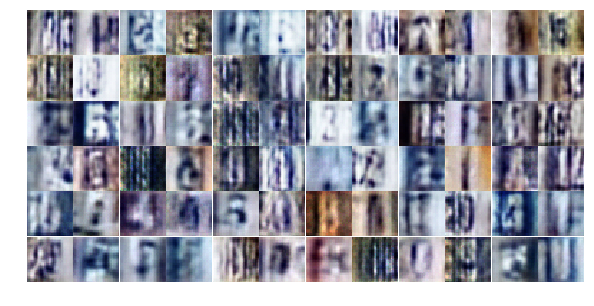

Epoch 5/25... Discriminator Loss: 0.7459... Generator Loss: 1.5114
Epoch 5/25... Discriminator Loss: 0.6985... Generator Loss: 1.5894
Epoch 5/25... Discriminator Loss: 0.7410... Generator Loss: 2.0764
Epoch 5/25... Discriminator Loss: 1.9830... Generator Loss: 0.3134
Epoch 5/25... Discriminator Loss: 0.8298... Generator Loss: 1.7568
Epoch 5/25... Discriminator Loss: 1.0790... Generator Loss: 0.9180
Epoch 5/25... Discriminator Loss: 0.6205... Generator Loss: 1.9030
Epoch 5/25... Discriminator Loss: 0.6890... Generator Loss: 1.6785
Epoch 5/25... Discriminator Loss: 0.6533... Generator Loss: 2.2951
Epoch 5/25... Discriminator Loss: 0.5695... Generator Loss: 2.2252


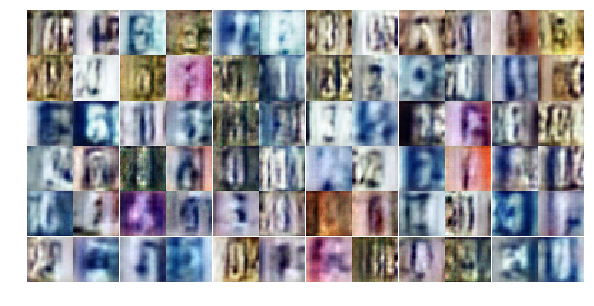

Epoch 5/25... Discriminator Loss: 0.7713... Generator Loss: 1.9819
Epoch 5/25... Discriminator Loss: 0.6889... Generator Loss: 1.6779
Epoch 5/25... Discriminator Loss: 0.7888... Generator Loss: 1.2198
Epoch 5/25... Discriminator Loss: 0.7532... Generator Loss: 1.3756
Epoch 5/25... Discriminator Loss: 0.7313... Generator Loss: 1.5856
Epoch 5/25... Discriminator Loss: 0.7395... Generator Loss: 1.2820
Epoch 5/25... Discriminator Loss: 0.9353... Generator Loss: 0.9103
Epoch 5/25... Discriminator Loss: 0.5964... Generator Loss: 1.8987
Epoch 5/25... Discriminator Loss: 0.9149... Generator Loss: 1.2375
Epoch 5/25... Discriminator Loss: 0.6243... Generator Loss: 2.2801


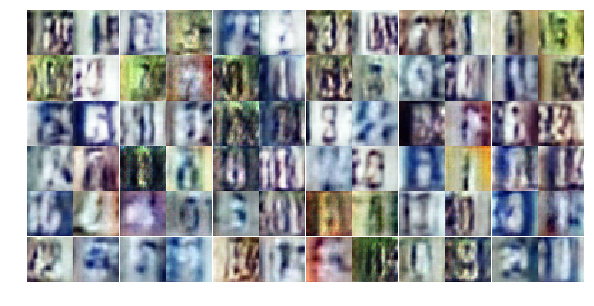

Epoch 5/25... Discriminator Loss: 0.8243... Generator Loss: 1.8450
Epoch 5/25... Discriminator Loss: 0.6995... Generator Loss: 1.5643
Epoch 5/25... Discriminator Loss: 0.8642... Generator Loss: 1.7411
Epoch 5/25... Discriminator Loss: 0.5851... Generator Loss: 2.1349
Epoch 5/25... Discriminator Loss: 0.8345... Generator Loss: 1.3079
Epoch 5/25... Discriminator Loss: 0.6395... Generator Loss: 1.6872
Epoch 5/25... Discriminator Loss: 0.7175... Generator Loss: 1.5377
Epoch 5/25... Discriminator Loss: 0.8666... Generator Loss: 1.0658
Epoch 5/25... Discriminator Loss: 0.9634... Generator Loss: 2.1507
Epoch 5/25... Discriminator Loss: 0.8051... Generator Loss: 1.1877


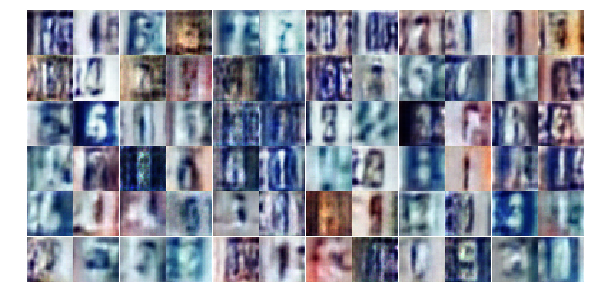

Epoch 5/25... Discriminator Loss: 0.5953... Generator Loss: 2.1248
Epoch 5/25... Discriminator Loss: 0.6243... Generator Loss: 1.6359
Epoch 5/25... Discriminator Loss: 0.9130... Generator Loss: 1.0006
Epoch 5/25... Discriminator Loss: 1.0362... Generator Loss: 1.3489
Epoch 5/25... Discriminator Loss: 0.9029... Generator Loss: 1.2605
Epoch 5/25... Discriminator Loss: 0.9832... Generator Loss: 0.8839
Epoch 5/25... Discriminator Loss: 0.6876... Generator Loss: 1.5741
Epoch 5/25... Discriminator Loss: 0.8466... Generator Loss: 1.1240
Epoch 5/25... Discriminator Loss: 0.6740... Generator Loss: 1.4928
Epoch 5/25... Discriminator Loss: 0.7627... Generator Loss: 1.8135


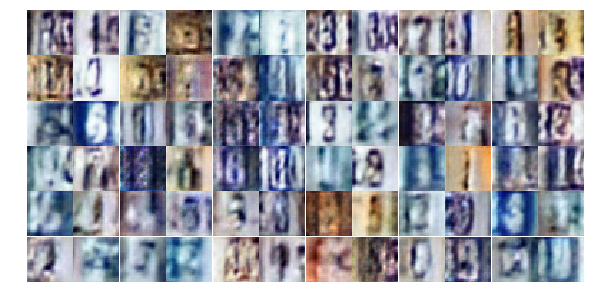

Epoch 5/25... Discriminator Loss: 1.4368... Generator Loss: 0.5025
Epoch 5/25... Discriminator Loss: 1.1036... Generator Loss: 0.7689
Epoch 5/25... Discriminator Loss: 0.8572... Generator Loss: 1.2267
Epoch 5/25... Discriminator Loss: 0.8019... Generator Loss: 1.1882
Epoch 5/25... Discriminator Loss: 0.6768... Generator Loss: 1.4535
Epoch 5/25... Discriminator Loss: 0.8681... Generator Loss: 1.3640
Epoch 6/25... Discriminator Loss: 0.7796... Generator Loss: 1.3978
Epoch 6/25... Discriminator Loss: 0.6116... Generator Loss: 1.6339
Epoch 6/25... Discriminator Loss: 1.4262... Generator Loss: 0.5571
Epoch 6/25... Discriminator Loss: 0.6845... Generator Loss: 1.7780


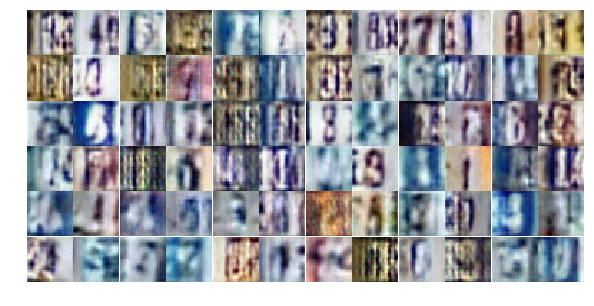

Epoch 6/25... Discriminator Loss: 0.8613... Generator Loss: 1.0909
Epoch 6/25... Discriminator Loss: 0.6545... Generator Loss: 2.0730
Epoch 6/25... Discriminator Loss: 0.7708... Generator Loss: 1.5538
Epoch 6/25... Discriminator Loss: 1.0171... Generator Loss: 1.0099
Epoch 6/25... Discriminator Loss: 1.2505... Generator Loss: 0.5972
Epoch 6/25... Discriminator Loss: 1.4302... Generator Loss: 0.5131
Epoch 6/25... Discriminator Loss: 0.7805... Generator Loss: 1.2598
Epoch 6/25... Discriminator Loss: 0.9009... Generator Loss: 1.2748
Epoch 6/25... Discriminator Loss: 0.8803... Generator Loss: 1.0484
Epoch 6/25... Discriminator Loss: 0.7339... Generator Loss: 1.2896


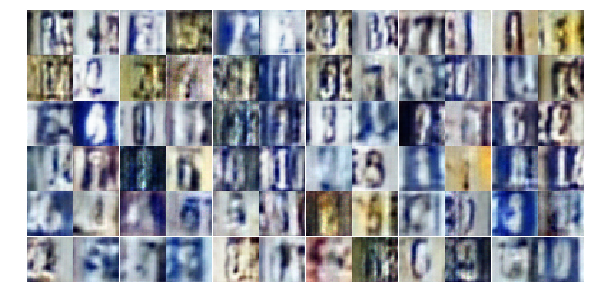

Epoch 6/25... Discriminator Loss: 0.6429... Generator Loss: 1.5623
Epoch 6/25... Discriminator Loss: 1.5446... Generator Loss: 2.2930
Epoch 6/25... Discriminator Loss: 1.3119... Generator Loss: 0.9982
Epoch 6/25... Discriminator Loss: 0.8136... Generator Loss: 1.2158
Epoch 6/25... Discriminator Loss: 0.6604... Generator Loss: 1.7356
Epoch 6/25... Discriminator Loss: 0.7385... Generator Loss: 1.6300
Epoch 6/25... Discriminator Loss: 0.8492... Generator Loss: 1.0425
Epoch 6/25... Discriminator Loss: 0.8512... Generator Loss: 1.0814
Epoch 6/25... Discriminator Loss: 0.7070... Generator Loss: 2.1638
Epoch 6/25... Discriminator Loss: 0.7898... Generator Loss: 1.7085


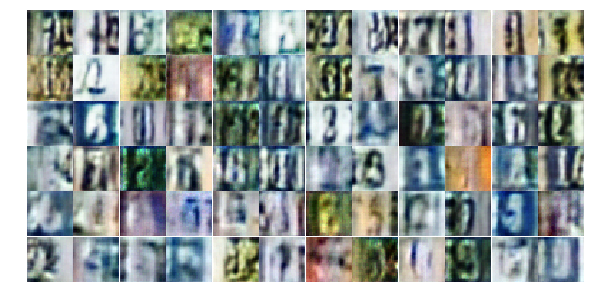

Epoch 6/25... Discriminator Loss: 0.9948... Generator Loss: 0.8346
Epoch 6/25... Discriminator Loss: 1.3667... Generator Loss: 0.5252
Epoch 6/25... Discriminator Loss: 1.0984... Generator Loss: 0.8561
Epoch 6/25... Discriminator Loss: 0.9662... Generator Loss: 0.9466
Epoch 6/25... Discriminator Loss: 0.7131... Generator Loss: 1.7850
Epoch 6/25... Discriminator Loss: 1.0506... Generator Loss: 0.8516
Epoch 6/25... Discriminator Loss: 0.7062... Generator Loss: 1.4172
Epoch 6/25... Discriminator Loss: 0.5319... Generator Loss: 2.2129
Epoch 6/25... Discriminator Loss: 1.3319... Generator Loss: 2.4659
Epoch 6/25... Discriminator Loss: 0.8951... Generator Loss: 2.2406


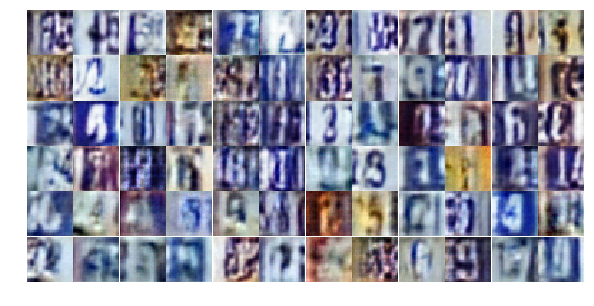

Epoch 6/25... Discriminator Loss: 0.9018... Generator Loss: 1.0910
Epoch 6/25... Discriminator Loss: 0.7645... Generator Loss: 1.3905
Epoch 6/25... Discriminator Loss: 1.7705... Generator Loss: 0.3722
Epoch 6/25... Discriminator Loss: 0.8522... Generator Loss: 1.1315
Epoch 6/25... Discriminator Loss: 0.9426... Generator Loss: 0.8918
Epoch 6/25... Discriminator Loss: 0.8367... Generator Loss: 1.3566
Epoch 6/25... Discriminator Loss: 0.6537... Generator Loss: 1.6914
Epoch 6/25... Discriminator Loss: 0.6665... Generator Loss: 1.5570
Epoch 6/25... Discriminator Loss: 0.7852... Generator Loss: 1.2984
Epoch 6/25... Discriminator Loss: 0.8216... Generator Loss: 1.0772


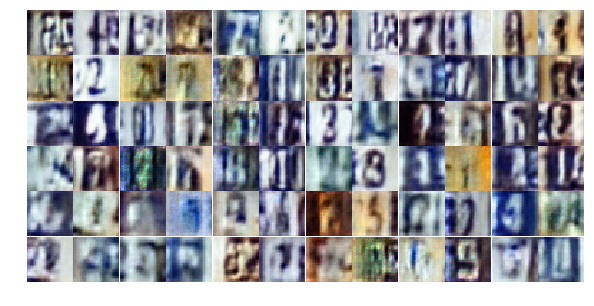

Epoch 6/25... Discriminator Loss: 1.5407... Generator Loss: 3.0375
Epoch 6/25... Discriminator Loss: 1.0134... Generator Loss: 1.0562
Epoch 6/25... Discriminator Loss: 1.3218... Generator Loss: 0.5728
Epoch 6/25... Discriminator Loss: 0.8376... Generator Loss: 1.8947
Epoch 6/25... Discriminator Loss: 0.7511... Generator Loss: 1.7583
Epoch 6/25... Discriminator Loss: 0.6127... Generator Loss: 1.6931
Epoch 6/25... Discriminator Loss: 0.9176... Generator Loss: 1.0015
Epoch 6/25... Discriminator Loss: 1.4456... Generator Loss: 0.5070
Epoch 6/25... Discriminator Loss: 0.7882... Generator Loss: 1.4061
Epoch 6/25... Discriminator Loss: 1.3477... Generator Loss: 0.5478


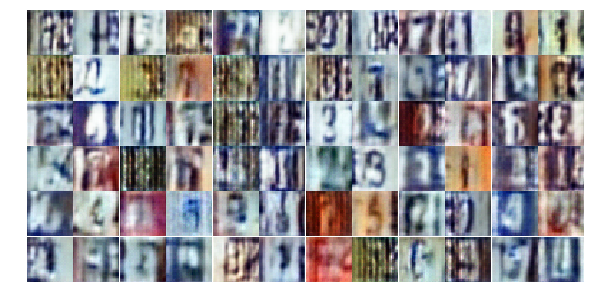

Epoch 6/25... Discriminator Loss: 0.7418... Generator Loss: 1.9168
Epoch 6/25... Discriminator Loss: 0.6981... Generator Loss: 1.7238
Epoch 6/25... Discriminator Loss: 0.9674... Generator Loss: 0.9344
Epoch 7/25... Discriminator Loss: 0.7755... Generator Loss: 1.4385
Epoch 7/25... Discriminator Loss: 0.9075... Generator Loss: 1.0774
Epoch 7/25... Discriminator Loss: 0.6589... Generator Loss: 1.5768
Epoch 7/25... Discriminator Loss: 0.5997... Generator Loss: 1.7700
Epoch 7/25... Discriminator Loss: 0.8477... Generator Loss: 1.2470
Epoch 7/25... Discriminator Loss: 0.8579... Generator Loss: 1.7630
Epoch 7/25... Discriminator Loss: 1.2523... Generator Loss: 0.6696


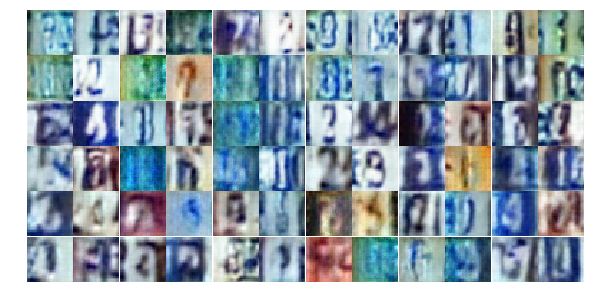

Epoch 7/25... Discriminator Loss: 0.8790... Generator Loss: 1.1172
Epoch 7/25... Discriminator Loss: 0.9364... Generator Loss: 0.9822
Epoch 7/25... Discriminator Loss: 1.2035... Generator Loss: 0.6707
Epoch 7/25... Discriminator Loss: 1.4209... Generator Loss: 2.8829
Epoch 7/25... Discriminator Loss: 0.6988... Generator Loss: 1.5299
Epoch 7/25... Discriminator Loss: 0.9385... Generator Loss: 0.9701
Epoch 7/25... Discriminator Loss: 0.8956... Generator Loss: 2.4236
Epoch 7/25... Discriminator Loss: 0.7787... Generator Loss: 1.5282
Epoch 7/25... Discriminator Loss: 1.4843... Generator Loss: 3.2068
Epoch 7/25... Discriminator Loss: 0.7762... Generator Loss: 1.2239


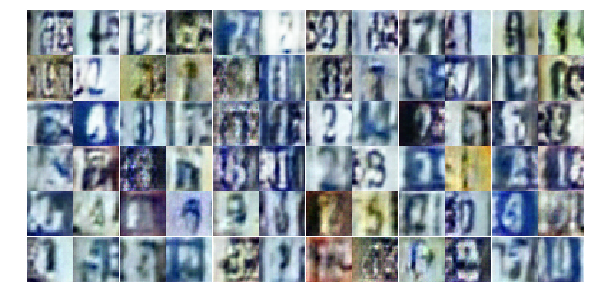

Epoch 7/25... Discriminator Loss: 0.6567... Generator Loss: 1.6303
Epoch 7/25... Discriminator Loss: 0.8144... Generator Loss: 1.3849
Epoch 7/25... Discriminator Loss: 0.9508... Generator Loss: 0.9428
Epoch 7/25... Discriminator Loss: 0.8008... Generator Loss: 1.8423
Epoch 7/25... Discriminator Loss: 0.8350... Generator Loss: 1.1209
Epoch 7/25... Discriminator Loss: 0.7763... Generator Loss: 1.2689
Epoch 7/25... Discriminator Loss: 0.7799... Generator Loss: 1.1765
Epoch 7/25... Discriminator Loss: 1.1451... Generator Loss: 0.7089
Epoch 7/25... Discriminator Loss: 0.6188... Generator Loss: 1.9313
Epoch 7/25... Discriminator Loss: 0.6572... Generator Loss: 1.8629


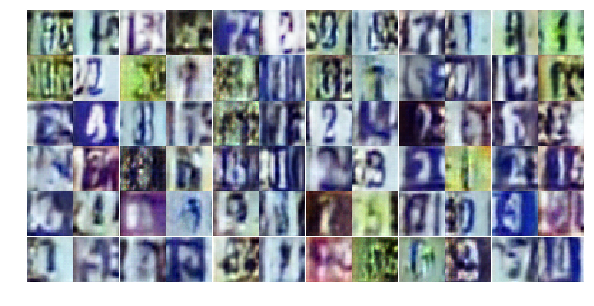

Epoch 7/25... Discriminator Loss: 0.8051... Generator Loss: 1.1648
Epoch 7/25... Discriminator Loss: 1.3745... Generator Loss: 0.5374
Epoch 7/25... Discriminator Loss: 0.8009... Generator Loss: 1.2734
Epoch 7/25... Discriminator Loss: 1.1016... Generator Loss: 0.7188
Epoch 7/25... Discriminator Loss: 1.0004... Generator Loss: 0.8469
Epoch 7/25... Discriminator Loss: 0.7185... Generator Loss: 1.6792
Epoch 7/25... Discriminator Loss: 0.7921... Generator Loss: 1.2224
Epoch 7/25... Discriminator Loss: 0.9567... Generator Loss: 0.9334
Epoch 7/25... Discriminator Loss: 0.8400... Generator Loss: 1.1724
Epoch 7/25... Discriminator Loss: 0.8614... Generator Loss: 2.4751


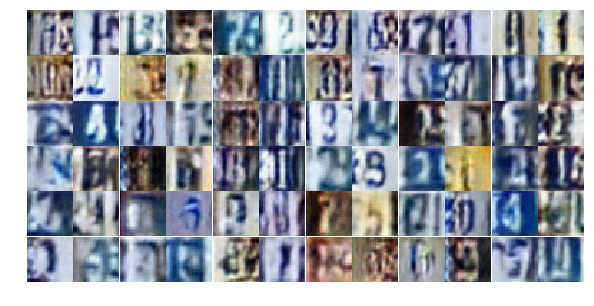

Epoch 7/25... Discriminator Loss: 0.8294... Generator Loss: 1.2449
Epoch 7/25... Discriminator Loss: 0.6291... Generator Loss: 1.6547
Epoch 7/25... Discriminator Loss: 0.5453... Generator Loss: 2.0632
Epoch 7/25... Discriminator Loss: 1.6041... Generator Loss: 0.4373
Epoch 7/25... Discriminator Loss: 0.8996... Generator Loss: 1.8448
Epoch 7/25... Discriminator Loss: 0.6469... Generator Loss: 1.6016
Epoch 7/25... Discriminator Loss: 0.7350... Generator Loss: 1.2529
Epoch 7/25... Discriminator Loss: 1.3766... Generator Loss: 1.9312
Epoch 7/25... Discriminator Loss: 0.7419... Generator Loss: 2.6140
Epoch 7/25... Discriminator Loss: 1.4282... Generator Loss: 1.7983


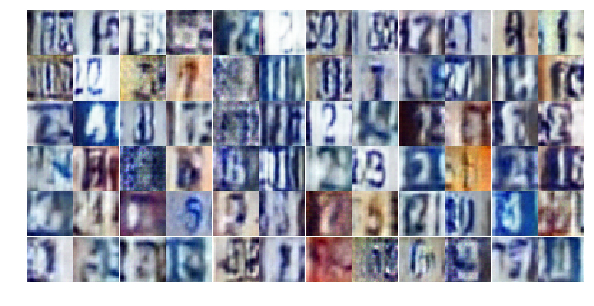

Epoch 7/25... Discriminator Loss: 0.9094... Generator Loss: 2.4584
Epoch 7/25... Discriminator Loss: 0.7753... Generator Loss: 1.6756
Epoch 7/25... Discriminator Loss: 1.0046... Generator Loss: 0.8198
Epoch 7/25... Discriminator Loss: 0.6932... Generator Loss: 1.8201
Epoch 7/25... Discriminator Loss: 0.8817... Generator Loss: 0.9848
Epoch 7/25... Discriminator Loss: 0.8114... Generator Loss: 1.2296
Epoch 7/25... Discriminator Loss: 1.3262... Generator Loss: 0.5578
Epoch 7/25... Discriminator Loss: 0.9856... Generator Loss: 1.5829
Epoch 7/25... Discriminator Loss: 0.9241... Generator Loss: 0.9511
Epoch 7/25... Discriminator Loss: 1.1787... Generator Loss: 0.7230


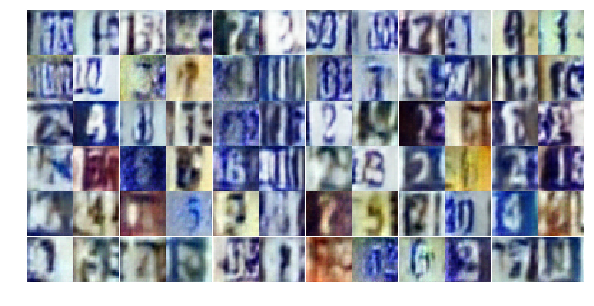

Epoch 7/25... Discriminator Loss: 0.6446... Generator Loss: 2.0308
Epoch 8/25... Discriminator Loss: 0.6970... Generator Loss: 1.3680
Epoch 8/25... Discriminator Loss: 1.0009... Generator Loss: 0.8420
Epoch 8/25... Discriminator Loss: 0.7517... Generator Loss: 1.6660
Epoch 8/25... Discriminator Loss: 1.0045... Generator Loss: 1.0171
Epoch 8/25... Discriminator Loss: 1.2787... Generator Loss: 0.6342
Epoch 8/25... Discriminator Loss: 0.8876... Generator Loss: 1.1376
Epoch 8/25... Discriminator Loss: 0.6797... Generator Loss: 1.6852
Epoch 8/25... Discriminator Loss: 1.1199... Generator Loss: 0.7258
Epoch 8/25... Discriminator Loss: 0.9372... Generator Loss: 1.7919


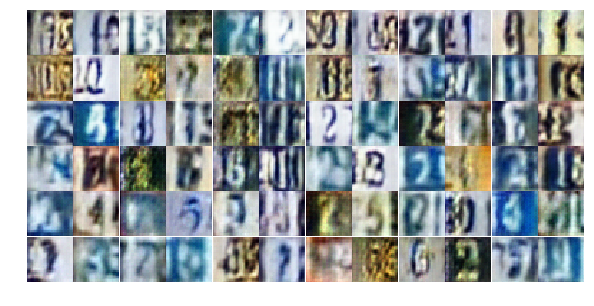

Epoch 8/25... Discriminator Loss: 0.6488... Generator Loss: 1.8807
Epoch 8/25... Discriminator Loss: 0.6798... Generator Loss: 1.7053
Epoch 8/25... Discriminator Loss: 0.9889... Generator Loss: 0.8597
Epoch 8/25... Discriminator Loss: 0.5248... Generator Loss: 2.5298
Epoch 8/25... Discriminator Loss: 0.8728... Generator Loss: 1.0768
Epoch 8/25... Discriminator Loss: 0.8514... Generator Loss: 1.9061
Epoch 8/25... Discriminator Loss: 0.6946... Generator Loss: 1.7477
Epoch 8/25... Discriminator Loss: 1.1189... Generator Loss: 1.0032
Epoch 8/25... Discriminator Loss: 1.0578... Generator Loss: 0.8208
Epoch 8/25... Discriminator Loss: 1.3398... Generator Loss: 0.5240


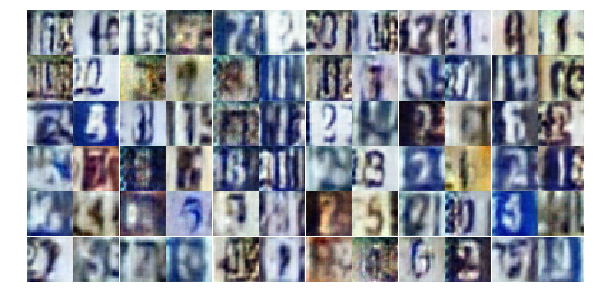

Epoch 8/25... Discriminator Loss: 0.6134... Generator Loss: 1.9268
Epoch 8/25... Discriminator Loss: 0.8113... Generator Loss: 1.1694
Epoch 8/25... Discriminator Loss: 0.7470... Generator Loss: 1.6852
Epoch 8/25... Discriminator Loss: 0.8269... Generator Loss: 1.7825
Epoch 8/25... Discriminator Loss: 0.6916... Generator Loss: 1.7706
Epoch 8/25... Discriminator Loss: 0.6605... Generator Loss: 1.7858
Epoch 8/25... Discriminator Loss: 0.7042... Generator Loss: 1.5852
Epoch 8/25... Discriminator Loss: 0.6575... Generator Loss: 1.5570
Epoch 8/25... Discriminator Loss: 0.7656... Generator Loss: 1.6057
Epoch 8/25... Discriminator Loss: 0.7349... Generator Loss: 1.4177


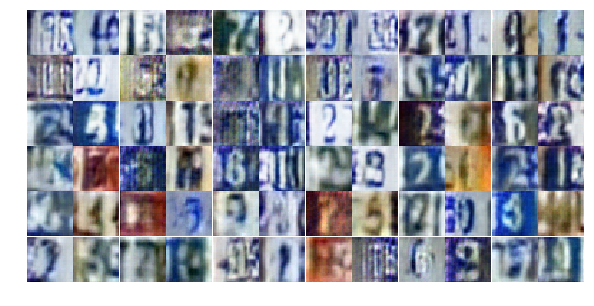

Epoch 8/25... Discriminator Loss: 0.7372... Generator Loss: 1.6152
Epoch 8/25... Discriminator Loss: 1.0563... Generator Loss: 0.7647
Epoch 8/25... Discriminator Loss: 0.6928... Generator Loss: 1.5190
Epoch 8/25... Discriminator Loss: 0.9985... Generator Loss: 0.8552
Epoch 8/25... Discriminator Loss: 1.2899... Generator Loss: 0.7302
Epoch 8/25... Discriminator Loss: 0.7034... Generator Loss: 1.7298
Epoch 8/25... Discriminator Loss: 0.7051... Generator Loss: 1.8588
Epoch 8/25... Discriminator Loss: 0.8609... Generator Loss: 1.0852
Epoch 8/25... Discriminator Loss: 0.8224... Generator Loss: 1.8987
Epoch 8/25... Discriminator Loss: 0.6967... Generator Loss: 1.8226


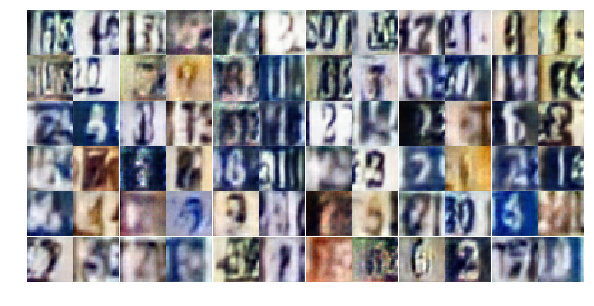

Epoch 8/25... Discriminator Loss: 0.7204... Generator Loss: 2.7402
Epoch 8/25... Discriminator Loss: 1.1194... Generator Loss: 0.7296
Epoch 8/25... Discriminator Loss: 0.8237... Generator Loss: 1.0717
Epoch 8/25... Discriminator Loss: 0.7165... Generator Loss: 1.3778
Epoch 8/25... Discriminator Loss: 1.2818... Generator Loss: 2.1415
Epoch 8/25... Discriminator Loss: 1.3657... Generator Loss: 0.5349
Epoch 8/25... Discriminator Loss: 0.7759... Generator Loss: 1.3739
Epoch 8/25... Discriminator Loss: 0.6626... Generator Loss: 1.8648
Epoch 8/25... Discriminator Loss: 0.7029... Generator Loss: 1.4660
Epoch 8/25... Discriminator Loss: 0.8406... Generator Loss: 1.2354


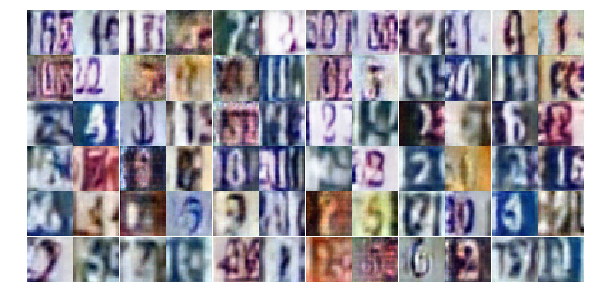

Epoch 8/25... Discriminator Loss: 0.6345... Generator Loss: 1.9106
Epoch 8/25... Discriminator Loss: 0.6421... Generator Loss: 2.0435
Epoch 8/25... Discriminator Loss: 0.5710... Generator Loss: 2.3226
Epoch 8/25... Discriminator Loss: 1.0989... Generator Loss: 0.7708
Epoch 8/25... Discriminator Loss: 0.5929... Generator Loss: 2.0715
Epoch 8/25... Discriminator Loss: 1.0885... Generator Loss: 0.7808
Epoch 8/25... Discriminator Loss: 0.7301... Generator Loss: 1.3602
Epoch 8/25... Discriminator Loss: 0.7320... Generator Loss: 2.2196
Epoch 9/25... Discriminator Loss: 1.0379... Generator Loss: 0.8380
Epoch 9/25... Discriminator Loss: 0.9757... Generator Loss: 0.8636


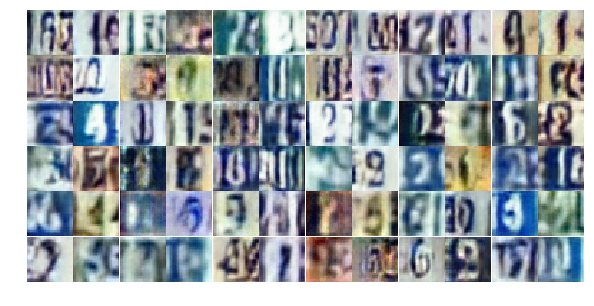

Epoch 9/25... Discriminator Loss: 0.8047... Generator Loss: 1.2272
Epoch 9/25... Discriminator Loss: 0.7551... Generator Loss: 1.2679
Epoch 9/25... Discriminator Loss: 1.0372... Generator Loss: 0.7975
Epoch 9/25... Discriminator Loss: 0.6797... Generator Loss: 2.1783
Epoch 9/25... Discriminator Loss: 1.2495... Generator Loss: 0.6235
Epoch 9/25... Discriminator Loss: 0.7360... Generator Loss: 1.5775
Epoch 9/25... Discriminator Loss: 0.7179... Generator Loss: 1.4976
Epoch 9/25... Discriminator Loss: 0.7694... Generator Loss: 1.1909
Epoch 9/25... Discriminator Loss: 0.6248... Generator Loss: 4.0392
Epoch 9/25... Discriminator Loss: 0.8718... Generator Loss: 1.4053


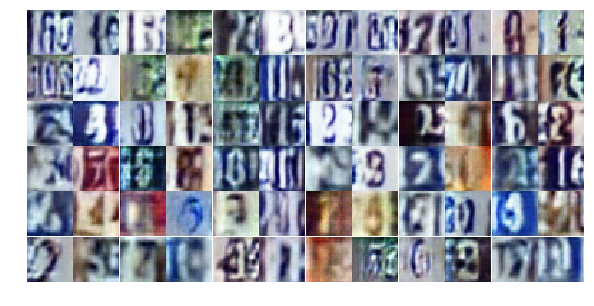

Epoch 9/25... Discriminator Loss: 0.8156... Generator Loss: 1.3111
Epoch 9/25... Discriminator Loss: 1.6004... Generator Loss: 0.3971
Epoch 9/25... Discriminator Loss: 0.8302... Generator Loss: 1.4923
Epoch 9/25... Discriminator Loss: 0.9517... Generator Loss: 0.9965
Epoch 9/25... Discriminator Loss: 0.7433... Generator Loss: 1.8300
Epoch 9/25... Discriminator Loss: 1.0158... Generator Loss: 0.8304
Epoch 9/25... Discriminator Loss: 1.3617... Generator Loss: 0.6042
Epoch 9/25... Discriminator Loss: 0.9393... Generator Loss: 1.0268
Epoch 9/25... Discriminator Loss: 1.0397... Generator Loss: 0.8478
Epoch 9/25... Discriminator Loss: 0.9641... Generator Loss: 0.9069


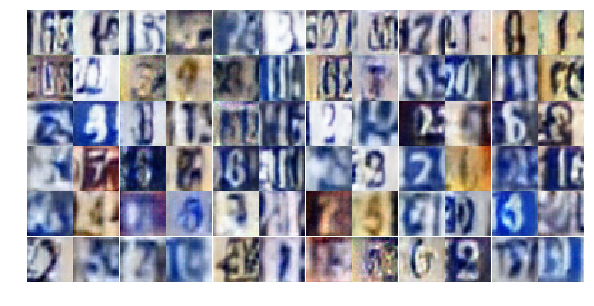

Epoch 9/25... Discriminator Loss: 0.9309... Generator Loss: 0.9872
Epoch 9/25... Discriminator Loss: 0.7512... Generator Loss: 1.3844
Epoch 9/25... Discriminator Loss: 0.7109... Generator Loss: 1.5024
Epoch 9/25... Discriminator Loss: 0.8120... Generator Loss: 1.1356
Epoch 9/25... Discriminator Loss: 0.6625... Generator Loss: 1.6314
Epoch 9/25... Discriminator Loss: 0.6805... Generator Loss: 1.5012
Epoch 9/25... Discriminator Loss: 0.7341... Generator Loss: 1.4120
Epoch 9/25... Discriminator Loss: 1.1512... Generator Loss: 2.8859
Epoch 9/25... Discriminator Loss: 0.8642... Generator Loss: 1.0862
Epoch 9/25... Discriminator Loss: 0.8094... Generator Loss: 1.1249


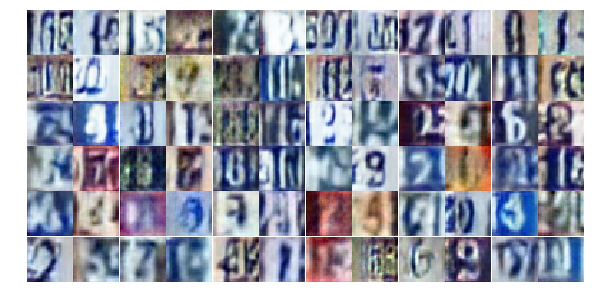

Epoch 9/25... Discriminator Loss: 0.6599... Generator Loss: 1.5149
Epoch 9/25... Discriminator Loss: 0.6819... Generator Loss: 1.8660
Epoch 9/25... Discriminator Loss: 0.9069... Generator Loss: 1.0074
Epoch 9/25... Discriminator Loss: 0.6785... Generator Loss: 1.6397
Epoch 9/25... Discriminator Loss: 0.7485... Generator Loss: 1.2584
Epoch 9/25... Discriminator Loss: 0.6945... Generator Loss: 1.5844
Epoch 9/25... Discriminator Loss: 0.6636... Generator Loss: 1.8804
Epoch 9/25... Discriminator Loss: 0.6008... Generator Loss: 1.7783
Epoch 9/25... Discriminator Loss: 1.1903... Generator Loss: 0.6635
Epoch 9/25... Discriminator Loss: 0.9310... Generator Loss: 0.9636


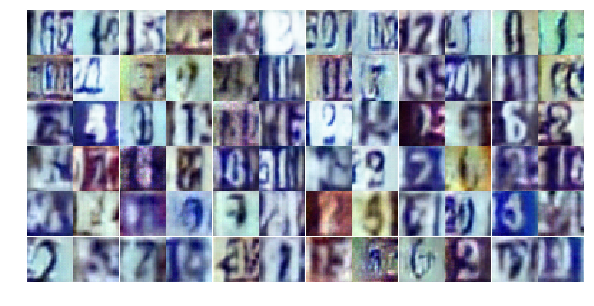

Epoch 9/25... Discriminator Loss: 0.6931... Generator Loss: 1.4429
Epoch 9/25... Discriminator Loss: 0.7340... Generator Loss: 1.3188
Epoch 9/25... Discriminator Loss: 0.8936... Generator Loss: 2.5701
Epoch 9/25... Discriminator Loss: 0.8011... Generator Loss: 1.8695
Epoch 9/25... Discriminator Loss: 0.6574... Generator Loss: 1.9360
Epoch 9/25... Discriminator Loss: 0.6474... Generator Loss: 1.8015
Epoch 9/25... Discriminator Loss: 0.7286... Generator Loss: 1.6288
Epoch 9/25... Discriminator Loss: 0.8946... Generator Loss: 0.9210
Epoch 9/25... Discriminator Loss: 0.8810... Generator Loss: 2.3520
Epoch 9/25... Discriminator Loss: 0.7587... Generator Loss: 1.7484


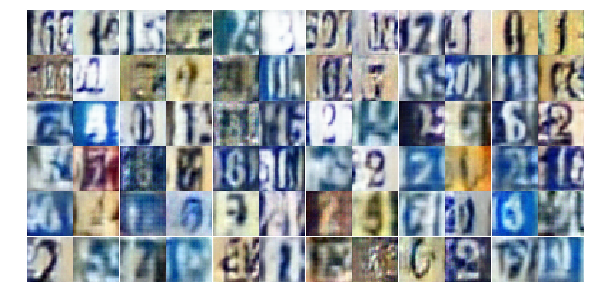

Epoch 9/25... Discriminator Loss: 1.2456... Generator Loss: 0.6245
Epoch 9/25... Discriminator Loss: 1.6513... Generator Loss: 2.9701
Epoch 9/25... Discriminator Loss: 0.7101... Generator Loss: 1.5150
Epoch 9/25... Discriminator Loss: 0.8930... Generator Loss: 1.0109
Epoch 9/25... Discriminator Loss: 0.6510... Generator Loss: 1.8233
Epoch 10/25... Discriminator Loss: 0.8494... Generator Loss: 1.1147
Epoch 10/25... Discriminator Loss: 0.7035... Generator Loss: 1.5521
Epoch 10/25... Discriminator Loss: 0.7144... Generator Loss: 1.2979
Epoch 10/25... Discriminator Loss: 1.1502... Generator Loss: 0.7262
Epoch 10/25... Discriminator Loss: 1.3749... Generator Loss: 0.5216


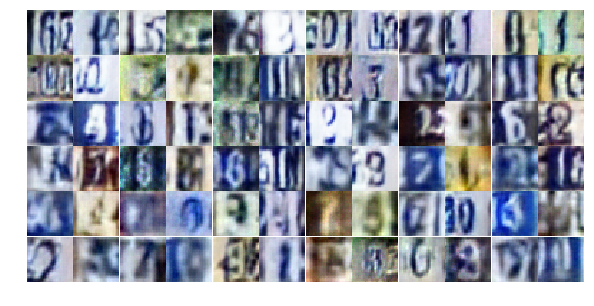

Epoch 10/25... Discriminator Loss: 0.8421... Generator Loss: 1.1684
Epoch 10/25... Discriminator Loss: 2.3782... Generator Loss: 4.2278
Epoch 10/25... Discriminator Loss: 1.2629... Generator Loss: 0.6639
Epoch 10/25... Discriminator Loss: 0.8707... Generator Loss: 1.3693
Epoch 10/25... Discriminator Loss: 0.8311... Generator Loss: 1.7365
Epoch 10/25... Discriminator Loss: 0.8128... Generator Loss: 1.6097
Epoch 10/25... Discriminator Loss: 0.6603... Generator Loss: 1.5054
Epoch 10/25... Discriminator Loss: 1.0807... Generator Loss: 0.7817
Epoch 10/25... Discriminator Loss: 0.9160... Generator Loss: 1.4271
Epoch 10/25... Discriminator Loss: 0.6954... Generator Loss: 1.5405


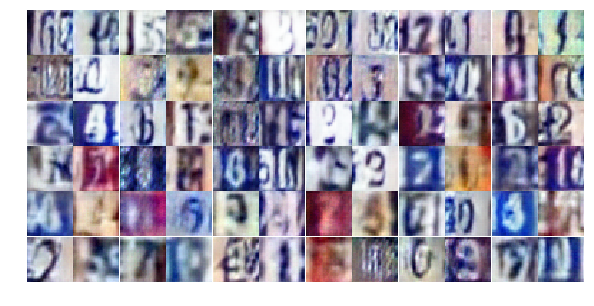

Epoch 10/25... Discriminator Loss: 0.7643... Generator Loss: 1.9655
Epoch 10/25... Discriminator Loss: 0.9787... Generator Loss: 0.8625
Epoch 10/25... Discriminator Loss: 0.8899... Generator Loss: 1.0892
Epoch 10/25... Discriminator Loss: 1.3458... Generator Loss: 0.5384
Epoch 10/25... Discriminator Loss: 0.8129... Generator Loss: 1.8587
Epoch 10/25... Discriminator Loss: 0.9134... Generator Loss: 1.0027
Epoch 10/25... Discriminator Loss: 0.8365... Generator Loss: 1.1346
Epoch 10/25... Discriminator Loss: 0.7051... Generator Loss: 1.5782
Epoch 10/25... Discriminator Loss: 0.7748... Generator Loss: 1.2796
Epoch 10/25... Discriminator Loss: 0.6193... Generator Loss: 2.0206


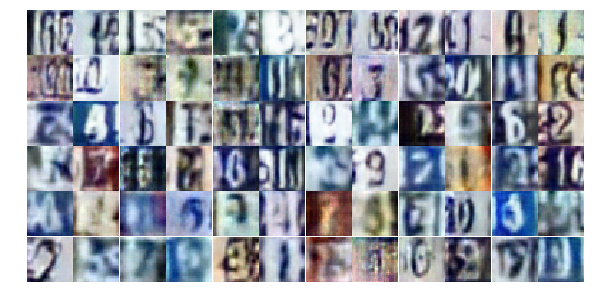

Epoch 10/25... Discriminator Loss: 0.7834... Generator Loss: 1.1353
Epoch 10/25... Discriminator Loss: 0.8398... Generator Loss: 1.2379
Epoch 10/25... Discriminator Loss: 0.6913... Generator Loss: 1.4925
Epoch 10/25... Discriminator Loss: 0.8032... Generator Loss: 2.4312
Epoch 10/25... Discriminator Loss: 1.1333... Generator Loss: 0.7886
Epoch 10/25... Discriminator Loss: 0.8230... Generator Loss: 1.2411
Epoch 10/25... Discriminator Loss: 0.6033... Generator Loss: 1.9047
Epoch 10/25... Discriminator Loss: 0.8406... Generator Loss: 1.2364
Epoch 10/25... Discriminator Loss: 0.7591... Generator Loss: 1.2327
Epoch 10/25... Discriminator Loss: 0.9138... Generator Loss: 0.9365


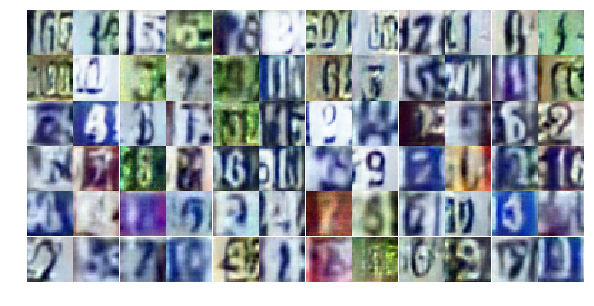

Epoch 10/25... Discriminator Loss: 0.7777... Generator Loss: 1.8673
Epoch 10/25... Discriminator Loss: 0.7283... Generator Loss: 1.4100
Epoch 10/25... Discriminator Loss: 0.7362... Generator Loss: 1.9041
Epoch 10/25... Discriminator Loss: 0.9293... Generator Loss: 2.1011
Epoch 10/25... Discriminator Loss: 0.9014... Generator Loss: 1.1012
Epoch 10/25... Discriminator Loss: 0.8286... Generator Loss: 1.1791
Epoch 10/25... Discriminator Loss: 0.8770... Generator Loss: 1.0578
Epoch 10/25... Discriminator Loss: 0.8966... Generator Loss: 1.0212
Epoch 10/25... Discriminator Loss: 0.6963... Generator Loss: 1.5406
Epoch 10/25... Discriminator Loss: 1.4893... Generator Loss: 1.9529


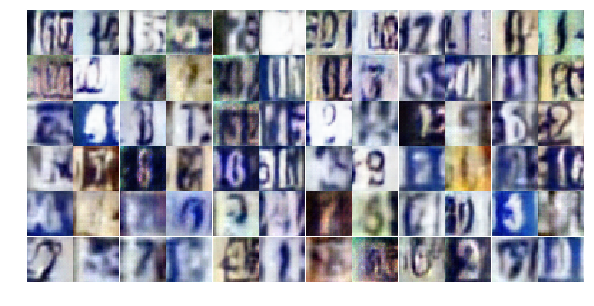

Epoch 10/25... Discriminator Loss: 1.5834... Generator Loss: 0.5065
Epoch 10/25... Discriminator Loss: 0.8672... Generator Loss: 1.7410
Epoch 10/25... Discriminator Loss: 0.9943... Generator Loss: 0.9248
Epoch 10/25... Discriminator Loss: 0.8356... Generator Loss: 1.4628
Epoch 10/25... Discriminator Loss: 0.7211... Generator Loss: 1.6194
Epoch 10/25... Discriminator Loss: 0.8824... Generator Loss: 0.9766
Epoch 10/25... Discriminator Loss: 0.8128... Generator Loss: 1.1727
Epoch 10/25... Discriminator Loss: 0.7068... Generator Loss: 1.5726
Epoch 10/25... Discriminator Loss: 0.8978... Generator Loss: 1.2197
Epoch 10/25... Discriminator Loss: 0.7947... Generator Loss: 1.3178


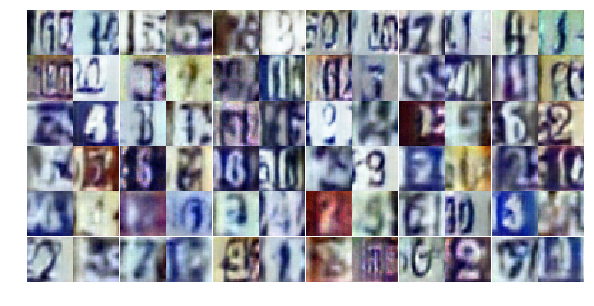

Epoch 10/25... Discriminator Loss: 0.8907... Generator Loss: 1.2949
Epoch 10/25... Discriminator Loss: 0.6173... Generator Loss: 1.6783
Epoch 10/25... Discriminator Loss: 0.7189... Generator Loss: 1.3672
Epoch 11/25... Discriminator Loss: 0.9518... Generator Loss: 0.9370
Epoch 11/25... Discriminator Loss: 0.8458... Generator Loss: 1.0548
Epoch 11/25... Discriminator Loss: 1.6590... Generator Loss: 0.3672
Epoch 11/25... Discriminator Loss: 1.0987... Generator Loss: 0.7278
Epoch 11/25... Discriminator Loss: 0.8195... Generator Loss: 1.5117
Epoch 11/25... Discriminator Loss: 1.5816... Generator Loss: 0.4897
Epoch 11/25... Discriminator Loss: 0.7318... Generator Loss: 2.0759


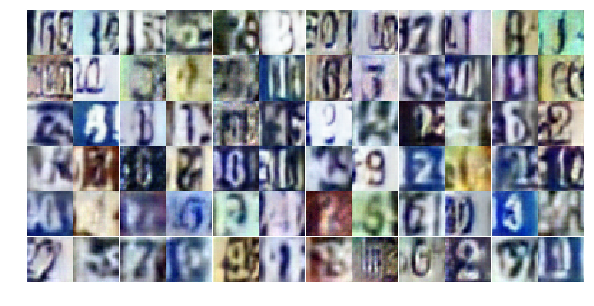

Epoch 11/25... Discriminator Loss: 0.6283... Generator Loss: 2.0134
Epoch 11/25... Discriminator Loss: 0.7890... Generator Loss: 1.6435
Epoch 11/25... Discriminator Loss: 0.6732... Generator Loss: 1.4329
Epoch 11/25... Discriminator Loss: 0.6981... Generator Loss: 1.4245
Epoch 11/25... Discriminator Loss: 0.8542... Generator Loss: 1.0416
Epoch 11/25... Discriminator Loss: 0.6907... Generator Loss: 1.4602
Epoch 11/25... Discriminator Loss: 0.7077... Generator Loss: 1.7999
Epoch 11/25... Discriminator Loss: 0.6029... Generator Loss: 2.1420
Epoch 11/25... Discriminator Loss: 0.7827... Generator Loss: 1.2104
Epoch 11/25... Discriminator Loss: 1.2472... Generator Loss: 0.6083


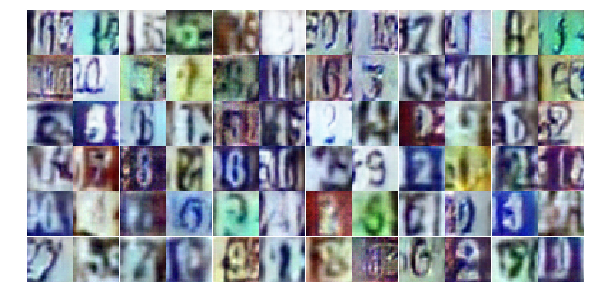

Epoch 11/25... Discriminator Loss: 1.0097... Generator Loss: 0.9015
Epoch 11/25... Discriminator Loss: 0.6733... Generator Loss: 1.6844
Epoch 11/25... Discriminator Loss: 0.8053... Generator Loss: 1.1934
Epoch 11/25... Discriminator Loss: 0.8143... Generator Loss: 1.3133
Epoch 11/25... Discriminator Loss: 0.6521... Generator Loss: 2.2530
Epoch 11/25... Discriminator Loss: 0.7005... Generator Loss: 1.6705
Epoch 11/25... Discriminator Loss: 0.8566... Generator Loss: 1.0509
Epoch 11/25... Discriminator Loss: 1.0953... Generator Loss: 0.7619
Epoch 11/25... Discriminator Loss: 0.6319... Generator Loss: 2.3881
Epoch 11/25... Discriminator Loss: 1.2788... Generator Loss: 0.5713


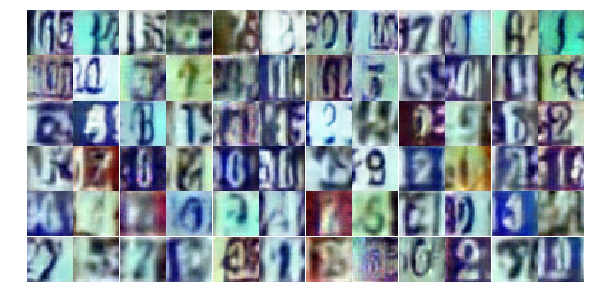

Epoch 11/25... Discriminator Loss: 0.7623... Generator Loss: 1.2953
Epoch 11/25... Discriminator Loss: 0.7754... Generator Loss: 1.4014
Epoch 11/25... Discriminator Loss: 1.0902... Generator Loss: 0.8146
Epoch 11/25... Discriminator Loss: 0.5554... Generator Loss: 1.8724
Epoch 11/25... Discriminator Loss: 0.7681... Generator Loss: 1.2176
Epoch 11/25... Discriminator Loss: 1.0987... Generator Loss: 0.7521
Epoch 11/25... Discriminator Loss: 1.4823... Generator Loss: 3.3599
Epoch 11/25... Discriminator Loss: 1.0930... Generator Loss: 0.7592
Epoch 11/25... Discriminator Loss: 0.6429... Generator Loss: 1.6754
Epoch 11/25... Discriminator Loss: 0.9263... Generator Loss: 0.9051


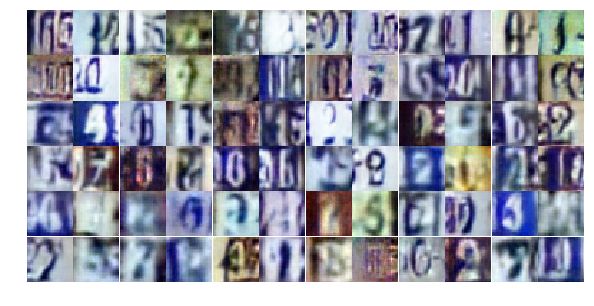

Epoch 11/25... Discriminator Loss: 0.5121... Generator Loss: 2.2507
Epoch 11/25... Discriminator Loss: 0.8944... Generator Loss: 1.0861
Epoch 11/25... Discriminator Loss: 0.7435... Generator Loss: 1.4075
Epoch 11/25... Discriminator Loss: 0.7884... Generator Loss: 1.2232
Epoch 11/25... Discriminator Loss: 0.8515... Generator Loss: 1.0567
Epoch 11/25... Discriminator Loss: 0.8186... Generator Loss: 1.1022
Epoch 11/25... Discriminator Loss: 0.6254... Generator Loss: 1.7166
Epoch 11/25... Discriminator Loss: 0.9105... Generator Loss: 0.9420
Epoch 11/25... Discriminator Loss: 1.6117... Generator Loss: 0.4599
Epoch 11/25... Discriminator Loss: 0.7206... Generator Loss: 1.4994


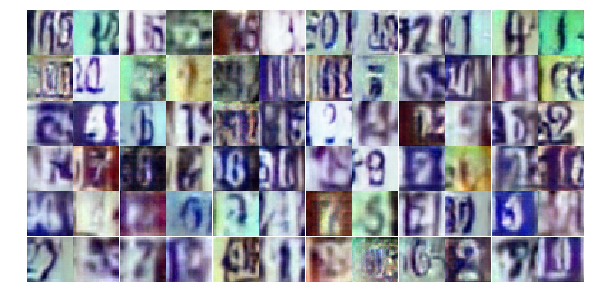

Epoch 11/25... Discriminator Loss: 0.7669... Generator Loss: 1.2640
Epoch 11/25... Discriminator Loss: 0.6281... Generator Loss: 1.9588
Epoch 11/25... Discriminator Loss: 0.7992... Generator Loss: 1.2372
Epoch 11/25... Discriminator Loss: 0.8438... Generator Loss: 1.1189
Epoch 11/25... Discriminator Loss: 1.2654... Generator Loss: 0.6429
Epoch 11/25... Discriminator Loss: 0.7295... Generator Loss: 1.4433
Epoch 11/25... Discriminator Loss: 2.1567... Generator Loss: 3.9807
Epoch 11/25... Discriminator Loss: 0.9923... Generator Loss: 1.1662
Epoch 11/25... Discriminator Loss: 1.2795... Generator Loss: 0.5968
Epoch 11/25... Discriminator Loss: 0.9198... Generator Loss: 1.0308


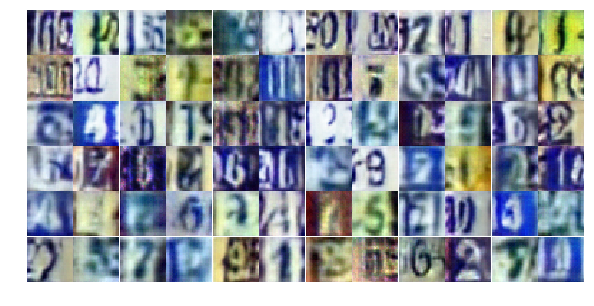

Epoch 12/25... Discriminator Loss: 0.9467... Generator Loss: 1.0920
Epoch 12/25... Discriminator Loss: 0.8793... Generator Loss: 1.1208
Epoch 12/25... Discriminator Loss: 0.9295... Generator Loss: 0.9948
Epoch 12/25... Discriminator Loss: 0.7611... Generator Loss: 1.4241
Epoch 12/25... Discriminator Loss: 0.7691... Generator Loss: 1.2329
Epoch 12/25... Discriminator Loss: 1.1991... Generator Loss: 0.6406
Epoch 12/25... Discriminator Loss: 0.7772... Generator Loss: 1.4667
Epoch 12/25... Discriminator Loss: 0.6822... Generator Loss: 1.7884
Epoch 12/25... Discriminator Loss: 0.8271... Generator Loss: 1.6735
Epoch 12/25... Discriminator Loss: 1.1710... Generator Loss: 0.6778


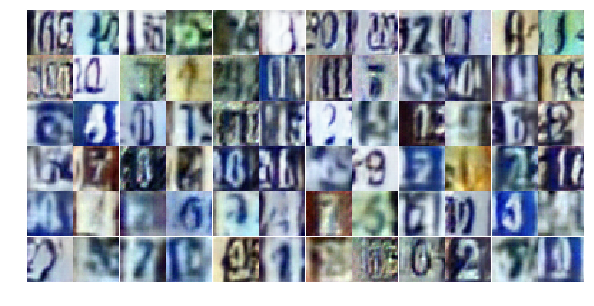

Epoch 12/25... Discriminator Loss: 0.6690... Generator Loss: 1.5241
Epoch 12/25... Discriminator Loss: 0.9999... Generator Loss: 0.8540
Epoch 12/25... Discriminator Loss: 0.6930... Generator Loss: 1.5419
Epoch 12/25... Discriminator Loss: 0.9768... Generator Loss: 1.9957
Epoch 12/25... Discriminator Loss: 0.6630... Generator Loss: 2.5023
Epoch 12/25... Discriminator Loss: 1.1562... Generator Loss: 0.7002
Epoch 12/25... Discriminator Loss: 1.5245... Generator Loss: 0.4445
Epoch 12/25... Discriminator Loss: 0.6145... Generator Loss: 2.0122
Epoch 12/25... Discriminator Loss: 0.7816... Generator Loss: 1.2306
Epoch 12/25... Discriminator Loss: 0.9506... Generator Loss: 0.9274


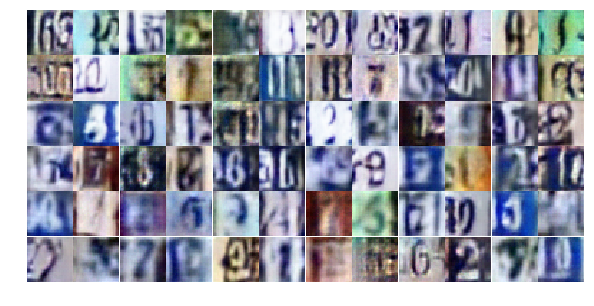

Epoch 12/25... Discriminator Loss: 0.6119... Generator Loss: 2.1826
Epoch 12/25... Discriminator Loss: 0.6122... Generator Loss: 1.8760
Epoch 12/25... Discriminator Loss: 0.7565... Generator Loss: 1.3335
Epoch 12/25... Discriminator Loss: 0.6111... Generator Loss: 1.7873
Epoch 12/25... Discriminator Loss: 0.6342... Generator Loss: 1.8966
Epoch 12/25... Discriminator Loss: 0.6420... Generator Loss: 1.5648
Epoch 12/25... Discriminator Loss: 0.8199... Generator Loss: 1.0998
Epoch 12/25... Discriminator Loss: 0.5477... Generator Loss: 2.0134
Epoch 12/25... Discriminator Loss: 0.7358... Generator Loss: 1.3308
Epoch 12/25... Discriminator Loss: 0.6551... Generator Loss: 1.5029


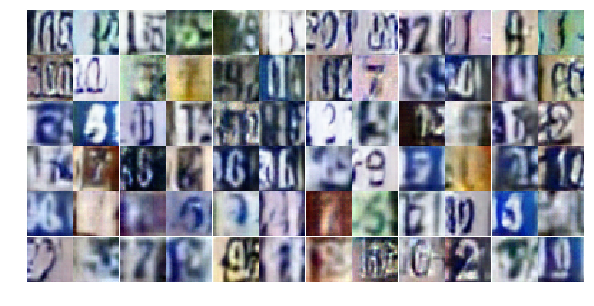

Epoch 12/25... Discriminator Loss: 0.6936... Generator Loss: 1.4682
Epoch 12/25... Discriminator Loss: 0.8000... Generator Loss: 1.1715
Epoch 12/25... Discriminator Loss: 0.8480... Generator Loss: 1.0428
Epoch 12/25... Discriminator Loss: 1.8580... Generator Loss: 0.3159
Epoch 12/25... Discriminator Loss: 0.8528... Generator Loss: 1.8051
Epoch 12/25... Discriminator Loss: 1.2878... Generator Loss: 0.6352
Epoch 12/25... Discriminator Loss: 1.0778... Generator Loss: 0.7800
Epoch 12/25... Discriminator Loss: 0.7862... Generator Loss: 1.2309
Epoch 12/25... Discriminator Loss: 0.6536... Generator Loss: 1.9314
Epoch 12/25... Discriminator Loss: 0.5552... Generator Loss: 2.1343


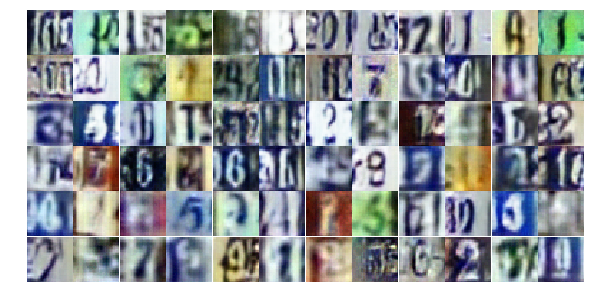

Epoch 12/25... Discriminator Loss: 0.6369... Generator Loss: 1.9675
Epoch 12/25... Discriminator Loss: 0.6574... Generator Loss: 2.2208
Epoch 12/25... Discriminator Loss: 0.6294... Generator Loss: 1.7292
Epoch 12/25... Discriminator Loss: 1.0330... Generator Loss: 0.8198
Epoch 12/25... Discriminator Loss: 0.9635... Generator Loss: 0.9346
Epoch 12/25... Discriminator Loss: 1.3202... Generator Loss: 0.5969
Epoch 12/25... Discriminator Loss: 1.1303... Generator Loss: 0.8365
Epoch 12/25... Discriminator Loss: 0.9038... Generator Loss: 1.0082
Epoch 12/25... Discriminator Loss: 0.7599... Generator Loss: 1.3099
Epoch 12/25... Discriminator Loss: 0.8794... Generator Loss: 1.1465


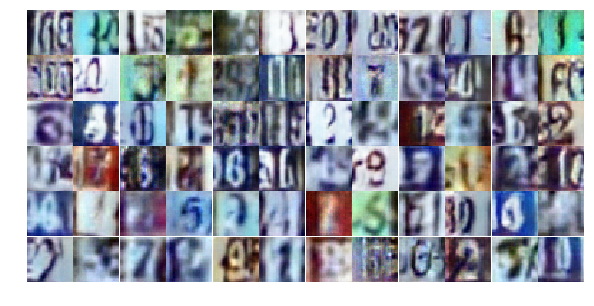

Epoch 12/25... Discriminator Loss: 1.0645... Generator Loss: 0.7965
Epoch 12/25... Discriminator Loss: 1.1654... Generator Loss: 0.7047
Epoch 12/25... Discriminator Loss: 0.8710... Generator Loss: 1.1842
Epoch 12/25... Discriminator Loss: 0.8799... Generator Loss: 1.2785
Epoch 12/25... Discriminator Loss: 0.6274... Generator Loss: 1.6541
Epoch 12/25... Discriminator Loss: 0.8934... Generator Loss: 1.4599
Epoch 12/25... Discriminator Loss: 0.9052... Generator Loss: 1.0065
Epoch 13/25... Discriminator Loss: 0.6946... Generator Loss: 1.4255
Epoch 13/25... Discriminator Loss: 0.6415... Generator Loss: 2.0180
Epoch 13/25... Discriminator Loss: 1.0698... Generator Loss: 0.7613


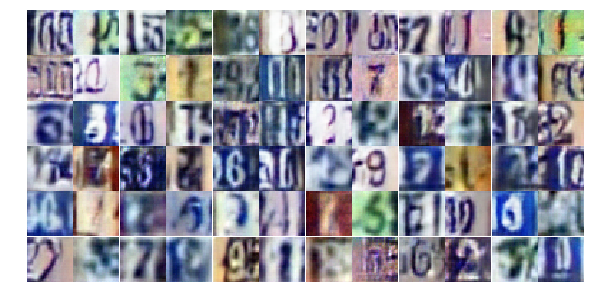

Epoch 13/25... Discriminator Loss: 0.6824... Generator Loss: 1.7263
Epoch 13/25... Discriminator Loss: 0.7819... Generator Loss: 2.3312
Epoch 13/25... Discriminator Loss: 1.3082... Generator Loss: 0.6257
Epoch 13/25... Discriminator Loss: 1.9196... Generator Loss: 0.4333
Epoch 13/25... Discriminator Loss: 0.7998... Generator Loss: 1.5577
Epoch 13/25... Discriminator Loss: 0.6677... Generator Loss: 1.6794
Epoch 13/25... Discriminator Loss: 0.6744... Generator Loss: 1.8153
Epoch 13/25... Discriminator Loss: 0.9997... Generator Loss: 0.9204
Epoch 13/25... Discriminator Loss: 0.6549... Generator Loss: 1.4615
Epoch 13/25... Discriminator Loss: 0.7303... Generator Loss: 1.3661


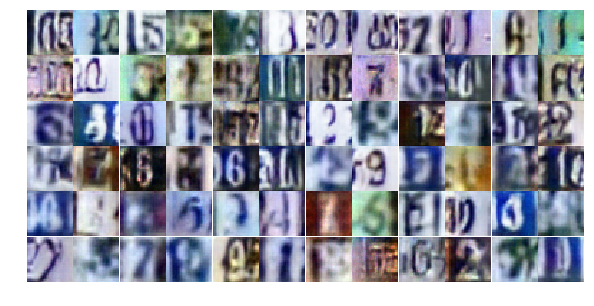

Epoch 13/25... Discriminator Loss: 0.8737... Generator Loss: 1.0861
Epoch 13/25... Discriminator Loss: 0.6467... Generator Loss: 1.8560
Epoch 13/25... Discriminator Loss: 1.1586... Generator Loss: 0.7021
Epoch 13/25... Discriminator Loss: 0.8450... Generator Loss: 1.1724
Epoch 13/25... Discriminator Loss: 0.6859... Generator Loss: 2.1187
Epoch 13/25... Discriminator Loss: 0.9001... Generator Loss: 1.1130
Epoch 13/25... Discriminator Loss: 0.7340... Generator Loss: 1.4389
Epoch 13/25... Discriminator Loss: 1.0409... Generator Loss: 0.8145
Epoch 13/25... Discriminator Loss: 0.7772... Generator Loss: 1.2040
Epoch 13/25... Discriminator Loss: 1.1063... Generator Loss: 0.7425


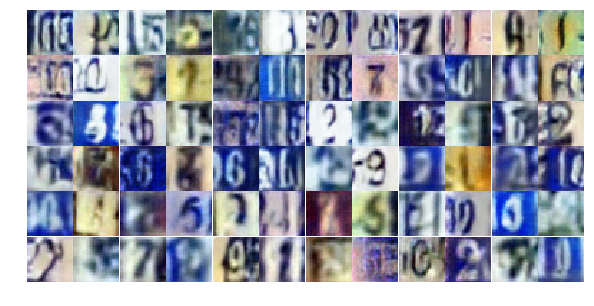

Epoch 13/25... Discriminator Loss: 0.7084... Generator Loss: 1.3434
Epoch 13/25... Discriminator Loss: 0.6899... Generator Loss: 1.4360
Epoch 13/25... Discriminator Loss: 0.7625... Generator Loss: 1.6304
Epoch 13/25... Discriminator Loss: 0.8586... Generator Loss: 1.0415
Epoch 13/25... Discriminator Loss: 0.9054... Generator Loss: 0.9419
Epoch 13/25... Discriminator Loss: 0.9379... Generator Loss: 0.9653
Epoch 13/25... Discriminator Loss: 0.9101... Generator Loss: 1.8217
Epoch 13/25... Discriminator Loss: 0.6883... Generator Loss: 1.5947
Epoch 13/25... Discriminator Loss: 0.9060... Generator Loss: 1.0433
Epoch 13/25... Discriminator Loss: 0.6839... Generator Loss: 1.6927


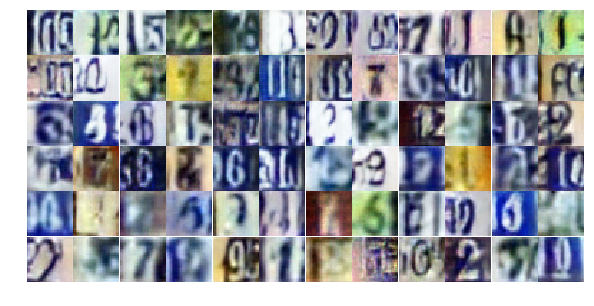

Epoch 13/25... Discriminator Loss: 1.2090... Generator Loss: 0.6446
Epoch 13/25... Discriminator Loss: 0.8445... Generator Loss: 1.7415
Epoch 13/25... Discriminator Loss: 1.0067... Generator Loss: 0.8589
Epoch 13/25... Discriminator Loss: 1.4298... Generator Loss: 0.5074
Epoch 13/25... Discriminator Loss: 0.8072... Generator Loss: 1.2535
Epoch 13/25... Discriminator Loss: 0.6493... Generator Loss: 1.8044
Epoch 13/25... Discriminator Loss: 0.6606... Generator Loss: 1.5428
Epoch 13/25... Discriminator Loss: 0.9380... Generator Loss: 0.9930
Epoch 13/25... Discriminator Loss: 0.7312... Generator Loss: 1.8225
Epoch 13/25... Discriminator Loss: 0.8494... Generator Loss: 1.1174


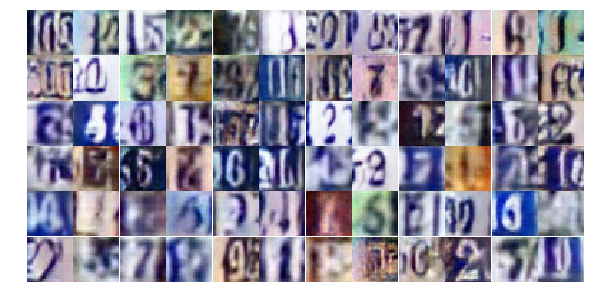

Epoch 13/25... Discriminator Loss: 0.6604... Generator Loss: 2.0643
Epoch 13/25... Discriminator Loss: 1.5430... Generator Loss: 0.4659
Epoch 13/25... Discriminator Loss: 1.2550... Generator Loss: 0.6363
Epoch 13/25... Discriminator Loss: 0.6507... Generator Loss: 2.1645
Epoch 13/25... Discriminator Loss: 1.0487... Generator Loss: 0.7869
Epoch 13/25... Discriminator Loss: 0.8014... Generator Loss: 1.2471
Epoch 13/25... Discriminator Loss: 0.8268... Generator Loss: 1.1465
Epoch 13/25... Discriminator Loss: 1.0401... Generator Loss: 0.8216
Epoch 13/25... Discriminator Loss: 0.8754... Generator Loss: 1.1352
Epoch 13/25... Discriminator Loss: 1.8229... Generator Loss: 0.7041


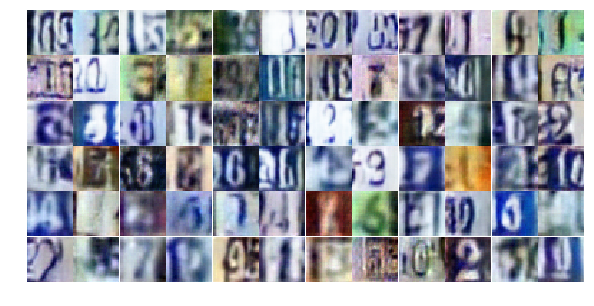

Epoch 13/25... Discriminator Loss: 0.8972... Generator Loss: 1.3225
Epoch 13/25... Discriminator Loss: 1.2626... Generator Loss: 0.6168
Epoch 13/25... Discriminator Loss: 0.8430... Generator Loss: 1.1727
Epoch 13/25... Discriminator Loss: 1.0528... Generator Loss: 0.7975
Epoch 14/25... Discriminator Loss: 1.0048... Generator Loss: 0.8897
Epoch 14/25... Discriminator Loss: 0.7595... Generator Loss: 1.3590
Epoch 14/25... Discriminator Loss: 0.9061... Generator Loss: 1.3028
Epoch 14/25... Discriminator Loss: 0.6991... Generator Loss: 1.8400
Epoch 14/25... Discriminator Loss: 0.7462... Generator Loss: 1.5129
Epoch 14/25... Discriminator Loss: 0.9188... Generator Loss: 0.9431


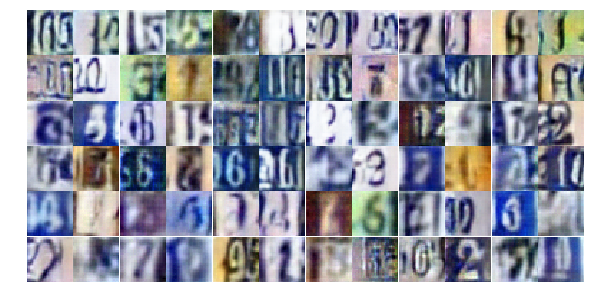

Epoch 14/25... Discriminator Loss: 0.8643... Generator Loss: 1.4097
Epoch 14/25... Discriminator Loss: 1.2164... Generator Loss: 0.7202
Epoch 14/25... Discriminator Loss: 0.9333... Generator Loss: 0.9999
Epoch 14/25... Discriminator Loss: 0.7675... Generator Loss: 1.6522
Epoch 14/25... Discriminator Loss: 1.1702... Generator Loss: 0.6917
Epoch 14/25... Discriminator Loss: 0.5595... Generator Loss: 1.8274
Epoch 14/25... Discriminator Loss: 0.6742... Generator Loss: 2.0736
Epoch 14/25... Discriminator Loss: 1.4911... Generator Loss: 0.4688
Epoch 14/25... Discriminator Loss: 1.0486... Generator Loss: 0.7843
Epoch 14/25... Discriminator Loss: 1.2877... Generator Loss: 0.6429


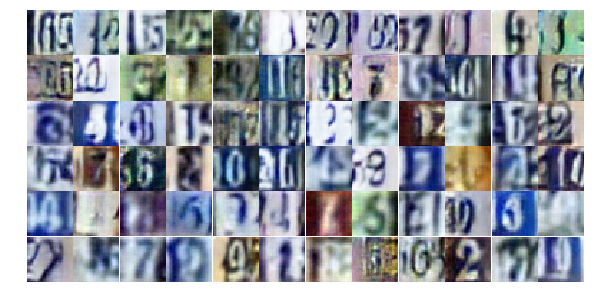

Epoch 14/25... Discriminator Loss: 0.7581... Generator Loss: 1.2581
Epoch 14/25... Discriminator Loss: 0.8369... Generator Loss: 2.4333
Epoch 14/25... Discriminator Loss: 1.1020... Generator Loss: 0.7358
Epoch 14/25... Discriminator Loss: 0.6693... Generator Loss: 1.7687
Epoch 14/25... Discriminator Loss: 1.0225... Generator Loss: 0.8532
Epoch 14/25... Discriminator Loss: 0.7101... Generator Loss: 1.7027
Epoch 14/25... Discriminator Loss: 1.1739... Generator Loss: 0.6721
Epoch 14/25... Discriminator Loss: 0.9877... Generator Loss: 0.9111
Epoch 14/25... Discriminator Loss: 0.7020... Generator Loss: 1.5281
Epoch 14/25... Discriminator Loss: 0.6875... Generator Loss: 1.8968


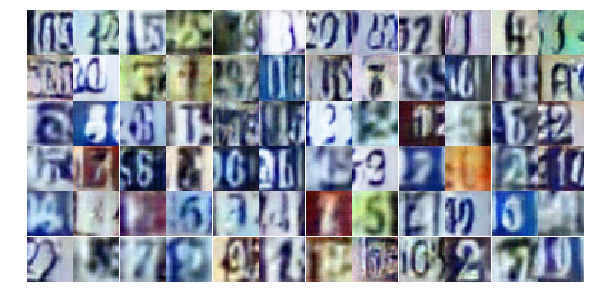

Epoch 14/25... Discriminator Loss: 1.1472... Generator Loss: 0.7502
Epoch 14/25... Discriminator Loss: 0.6881... Generator Loss: 1.6713
Epoch 14/25... Discriminator Loss: 0.6925... Generator Loss: 2.1594
Epoch 14/25... Discriminator Loss: 0.6636... Generator Loss: 1.6686
Epoch 14/25... Discriminator Loss: 0.7807... Generator Loss: 1.4490
Epoch 14/25... Discriminator Loss: 0.8411... Generator Loss: 1.0725
Epoch 14/25... Discriminator Loss: 0.9960... Generator Loss: 0.8396
Epoch 14/25... Discriminator Loss: 0.6615... Generator Loss: 1.6683
Epoch 14/25... Discriminator Loss: 0.7450... Generator Loss: 2.4456
Epoch 14/25... Discriminator Loss: 0.8967... Generator Loss: 0.9985


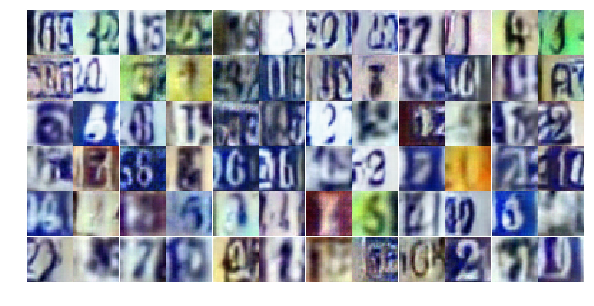

Epoch 14/25... Discriminator Loss: 1.2535... Generator Loss: 0.6286
Epoch 14/25... Discriminator Loss: 0.8876... Generator Loss: 1.3774
Epoch 14/25... Discriminator Loss: 1.2047... Generator Loss: 0.6747
Epoch 14/25... Discriminator Loss: 1.2606... Generator Loss: 0.6160
Epoch 14/25... Discriminator Loss: 1.2508... Generator Loss: 0.6366
Epoch 14/25... Discriminator Loss: 0.8799... Generator Loss: 1.0950
Epoch 14/25... Discriminator Loss: 0.8295... Generator Loss: 1.2125
Epoch 14/25... Discriminator Loss: 0.7776... Generator Loss: 1.3230
Epoch 14/25... Discriminator Loss: 0.9965... Generator Loss: 0.8745
Epoch 14/25... Discriminator Loss: 1.4544... Generator Loss: 0.4923


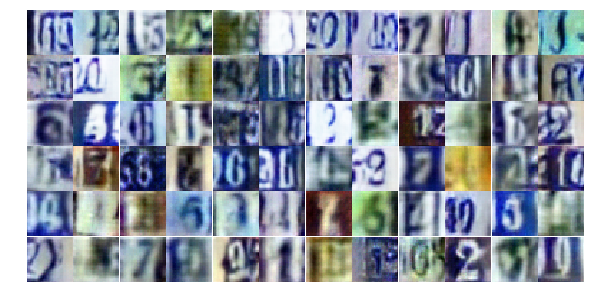

Epoch 14/25... Discriminator Loss: 0.9251... Generator Loss: 1.5591
Epoch 14/25... Discriminator Loss: 0.9299... Generator Loss: 0.9497
Epoch 14/25... Discriminator Loss: 0.7770... Generator Loss: 1.2699
Epoch 14/25... Discriminator Loss: 0.8742... Generator Loss: 1.0881
Epoch 14/25... Discriminator Loss: 0.8699... Generator Loss: 1.1172
Epoch 14/25... Discriminator Loss: 0.6713... Generator Loss: 1.5458
Epoch 14/25... Discriminator Loss: 0.8056... Generator Loss: 1.9283
Epoch 14/25... Discriminator Loss: 0.6141... Generator Loss: 1.9021
Epoch 14/25... Discriminator Loss: 0.8909... Generator Loss: 1.8998
Epoch 14/25... Discriminator Loss: 1.3793... Generator Loss: 0.5169


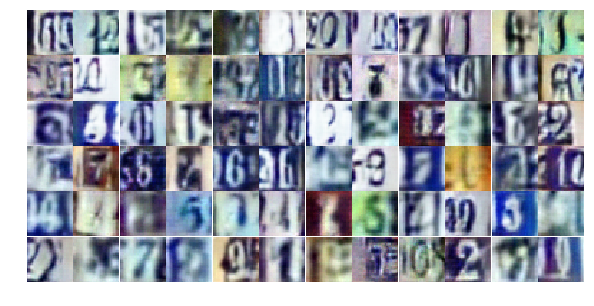

Epoch 14/25... Discriminator Loss: 0.8332... Generator Loss: 1.1819
Epoch 14/25... Discriminator Loss: 0.9511... Generator Loss: 0.9261
Epoch 15/25... Discriminator Loss: 0.7427... Generator Loss: 1.3417
Epoch 15/25... Discriminator Loss: 0.6229... Generator Loss: 2.0195
Epoch 15/25... Discriminator Loss: 0.6738... Generator Loss: 1.5912
Epoch 15/25... Discriminator Loss: 0.9192... Generator Loss: 0.9372
Epoch 15/25... Discriminator Loss: 1.2465... Generator Loss: 0.6920
Epoch 15/25... Discriminator Loss: 0.7736... Generator Loss: 1.4316
Epoch 15/25... Discriminator Loss: 1.4669... Generator Loss: 0.4958
Epoch 15/25... Discriminator Loss: 0.9111... Generator Loss: 1.0064


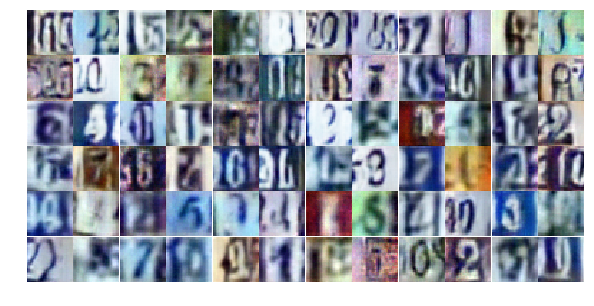

Epoch 15/25... Discriminator Loss: 0.8074... Generator Loss: 1.2491
Epoch 15/25... Discriminator Loss: 0.9009... Generator Loss: 1.3422
Epoch 15/25... Discriminator Loss: 1.1580... Generator Loss: 0.7591
Epoch 15/25... Discriminator Loss: 0.6470... Generator Loss: 1.7005
Epoch 15/25... Discriminator Loss: 1.1623... Generator Loss: 0.7157
Epoch 15/25... Discriminator Loss: 0.6702... Generator Loss: 1.9152
Epoch 15/25... Discriminator Loss: 1.3775... Generator Loss: 0.5266
Epoch 15/25... Discriminator Loss: 1.1904... Generator Loss: 1.9878
Epoch 15/25... Discriminator Loss: 0.7455... Generator Loss: 2.5682
Epoch 15/25... Discriminator Loss: 0.9294... Generator Loss: 1.1126


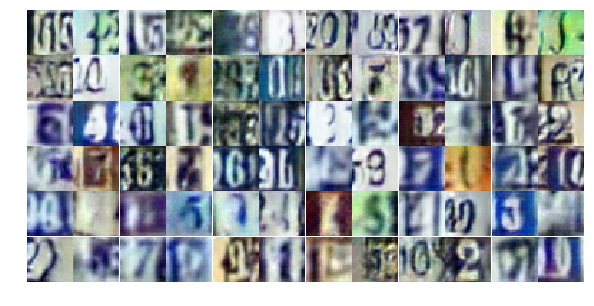

Epoch 15/25... Discriminator Loss: 0.8855... Generator Loss: 1.0196
Epoch 15/25... Discriminator Loss: 0.7171... Generator Loss: 1.3883
Epoch 15/25... Discriminator Loss: 0.6423... Generator Loss: 1.7617
Epoch 15/25... Discriminator Loss: 1.2544... Generator Loss: 0.6413
Epoch 15/25... Discriminator Loss: 0.9156... Generator Loss: 1.0358
Epoch 15/25... Discriminator Loss: 0.6041... Generator Loss: 1.7856
Epoch 15/25... Discriminator Loss: 0.7863... Generator Loss: 1.2540
Epoch 15/25... Discriminator Loss: 0.8667... Generator Loss: 1.0687
Epoch 15/25... Discriminator Loss: 0.7491... Generator Loss: 1.3765
Epoch 15/25... Discriminator Loss: 1.4561... Generator Loss: 0.5145


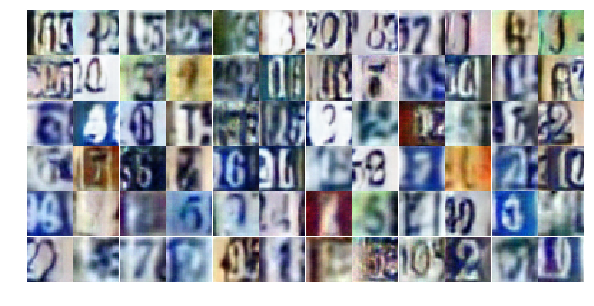

Epoch 15/25... Discriminator Loss: 1.6219... Generator Loss: 0.4854
Epoch 15/25... Discriminator Loss: 0.7902... Generator Loss: 1.2724
Epoch 15/25... Discriminator Loss: 0.6636... Generator Loss: 1.5272
Epoch 15/25... Discriminator Loss: 0.8033... Generator Loss: 1.1920
Epoch 15/25... Discriminator Loss: 0.7513... Generator Loss: 1.3538
Epoch 15/25... Discriminator Loss: 0.8760... Generator Loss: 1.4977
Epoch 15/25... Discriminator Loss: 0.6421... Generator Loss: 1.5908
Epoch 15/25... Discriminator Loss: 0.7547... Generator Loss: 1.4169
Epoch 15/25... Discriminator Loss: 0.7394... Generator Loss: 1.3588
Epoch 15/25... Discriminator Loss: 0.7808... Generator Loss: 1.2100


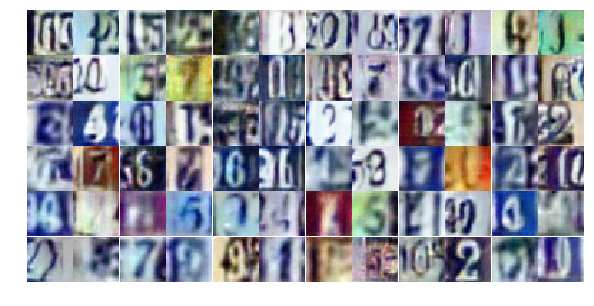

Epoch 15/25... Discriminator Loss: 0.8766... Generator Loss: 1.0713
Epoch 15/25... Discriminator Loss: 0.9515... Generator Loss: 1.0015
Epoch 15/25... Discriminator Loss: 0.6779... Generator Loss: 1.5443
Epoch 15/25... Discriminator Loss: 0.6854... Generator Loss: 1.7917
Epoch 15/25... Discriminator Loss: 0.7355... Generator Loss: 1.2906
Epoch 15/25... Discriminator Loss: 2.2204... Generator Loss: 0.2291
Epoch 15/25... Discriminator Loss: 0.9089... Generator Loss: 1.2423
Epoch 15/25... Discriminator Loss: 1.0345... Generator Loss: 1.4024
Epoch 15/25... Discriminator Loss: 1.0287... Generator Loss: 0.8601
Epoch 15/25... Discriminator Loss: 1.0165... Generator Loss: 0.8513


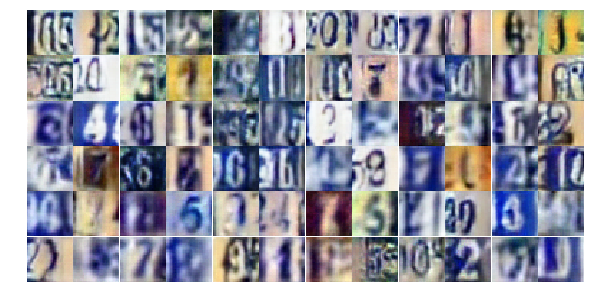

Epoch 15/25... Discriminator Loss: 0.8258... Generator Loss: 1.2479
Epoch 15/25... Discriminator Loss: 1.0020... Generator Loss: 0.8666
Epoch 15/25... Discriminator Loss: 0.7001... Generator Loss: 1.4392
Epoch 15/25... Discriminator Loss: 1.0271... Generator Loss: 0.8375
Epoch 15/25... Discriminator Loss: 0.7375... Generator Loss: 1.7887
Epoch 15/25... Discriminator Loss: 0.8225... Generator Loss: 1.2132
Epoch 15/25... Discriminator Loss: 1.1136... Generator Loss: 0.7659
Epoch 15/25... Discriminator Loss: 0.8562... Generator Loss: 1.1189
Epoch 15/25... Discriminator Loss: 1.2090... Generator Loss: 0.7223
Epoch 16/25... Discriminator Loss: 1.0791... Generator Loss: 0.7668


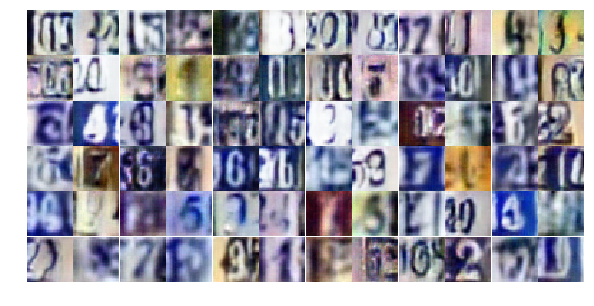

Epoch 16/25... Discriminator Loss: 0.7038... Generator Loss: 1.4245
Epoch 16/25... Discriminator Loss: 0.8431... Generator Loss: 1.1962
Epoch 16/25... Discriminator Loss: 0.8880... Generator Loss: 1.1947
Epoch 16/25... Discriminator Loss: 0.8685... Generator Loss: 1.1204
Epoch 16/25... Discriminator Loss: 0.7816... Generator Loss: 2.9658
Epoch 16/25... Discriminator Loss: 0.7936... Generator Loss: 1.2868
Epoch 16/25... Discriminator Loss: 1.4036... Generator Loss: 0.5048
Epoch 16/25... Discriminator Loss: 1.0226... Generator Loss: 0.8475
Epoch 16/25... Discriminator Loss: 0.7645... Generator Loss: 1.2654
Epoch 16/25... Discriminator Loss: 0.7040... Generator Loss: 1.6289


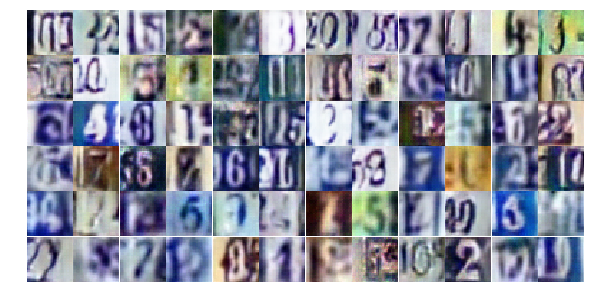

Epoch 16/25... Discriminator Loss: 1.3817... Generator Loss: 0.5064
Epoch 16/25... Discriminator Loss: 0.6774... Generator Loss: 1.5608
Epoch 16/25... Discriminator Loss: 0.7902... Generator Loss: 1.2627
Epoch 16/25... Discriminator Loss: 1.5123... Generator Loss: 0.4645
Epoch 16/25... Discriminator Loss: 2.7165... Generator Loss: 0.2243
Epoch 16/25... Discriminator Loss: 1.4238... Generator Loss: 0.7848
Epoch 16/25... Discriminator Loss: 1.3677... Generator Loss: 0.6384
Epoch 16/25... Discriminator Loss: 0.7090... Generator Loss: 1.6124
Epoch 16/25... Discriminator Loss: 0.7326... Generator Loss: 1.3777
Epoch 16/25... Discriminator Loss: 0.8676... Generator Loss: 1.2384


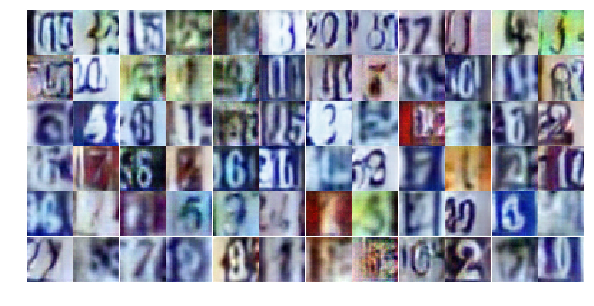

Epoch 16/25... Discriminator Loss: 0.8158... Generator Loss: 1.3601
Epoch 16/25... Discriminator Loss: 0.8838... Generator Loss: 1.6339
Epoch 16/25... Discriminator Loss: 0.8700... Generator Loss: 1.1471
Epoch 16/25... Discriminator Loss: 0.9693... Generator Loss: 0.8841
Epoch 16/25... Discriminator Loss: 0.8619... Generator Loss: 1.0927
Epoch 16/25... Discriminator Loss: 1.1805... Generator Loss: 0.6742
Epoch 16/25... Discriminator Loss: 0.7351... Generator Loss: 1.3227
Epoch 16/25... Discriminator Loss: 0.8129... Generator Loss: 1.2437
Epoch 16/25... Discriminator Loss: 0.8043... Generator Loss: 1.3919
Epoch 16/25... Discriminator Loss: 0.9704... Generator Loss: 0.8929


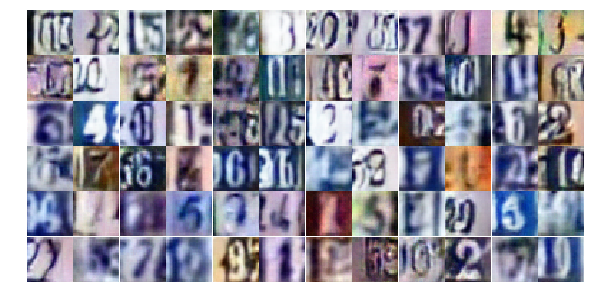

Epoch 16/25... Discriminator Loss: 0.7975... Generator Loss: 1.2450
Epoch 16/25... Discriminator Loss: 0.6693... Generator Loss: 1.5019
Epoch 16/25... Discriminator Loss: 0.8416... Generator Loss: 1.4826
Epoch 16/25... Discriminator Loss: 0.7292... Generator Loss: 1.4848
Epoch 16/25... Discriminator Loss: 1.0457... Generator Loss: 0.8407
Epoch 16/25... Discriminator Loss: 1.0343... Generator Loss: 1.9767
Epoch 16/25... Discriminator Loss: 0.9522... Generator Loss: 0.9380
Epoch 16/25... Discriminator Loss: 0.9132... Generator Loss: 0.9877
Epoch 16/25... Discriminator Loss: 0.9668... Generator Loss: 0.9543
Epoch 16/25... Discriminator Loss: 0.6623... Generator Loss: 1.7476


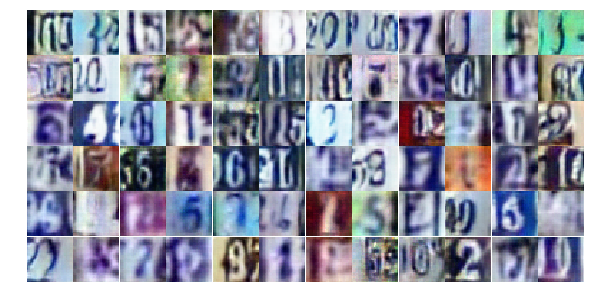

Epoch 16/25... Discriminator Loss: 0.7890... Generator Loss: 1.5617
Epoch 16/25... Discriminator Loss: 0.7788... Generator Loss: 1.2218
Epoch 16/25... Discriminator Loss: 1.1859... Generator Loss: 0.7557
Epoch 16/25... Discriminator Loss: 0.9015... Generator Loss: 1.9335
Epoch 16/25... Discriminator Loss: 0.8472... Generator Loss: 1.2874
Epoch 16/25... Discriminator Loss: 0.9572... Generator Loss: 1.0273
Epoch 16/25... Discriminator Loss: 0.7973... Generator Loss: 2.2712
Epoch 16/25... Discriminator Loss: 0.9277... Generator Loss: 0.9360
Epoch 16/25... Discriminator Loss: 0.6057... Generator Loss: 1.7241
Epoch 16/25... Discriminator Loss: 0.8528... Generator Loss: 1.0703


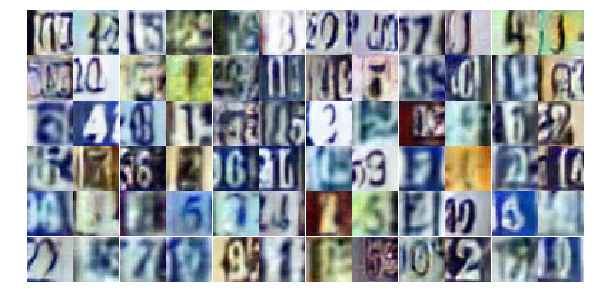

Epoch 16/25... Discriminator Loss: 0.9163... Generator Loss: 1.7148
Epoch 16/25... Discriminator Loss: 0.8420... Generator Loss: 1.1422
Epoch 16/25... Discriminator Loss: 1.8564... Generator Loss: 0.3799
Epoch 16/25... Discriminator Loss: 0.6113... Generator Loss: 1.8496
Epoch 16/25... Discriminator Loss: 0.7380... Generator Loss: 1.4928
Epoch 16/25... Discriminator Loss: 0.8724... Generator Loss: 1.0634
Epoch 17/25... Discriminator Loss: 0.7868... Generator Loss: 1.4133
Epoch 17/25... Discriminator Loss: 0.9562... Generator Loss: 0.8961
Epoch 17/25... Discriminator Loss: 0.7774... Generator Loss: 1.5815
Epoch 17/25... Discriminator Loss: 0.6580... Generator Loss: 1.5766


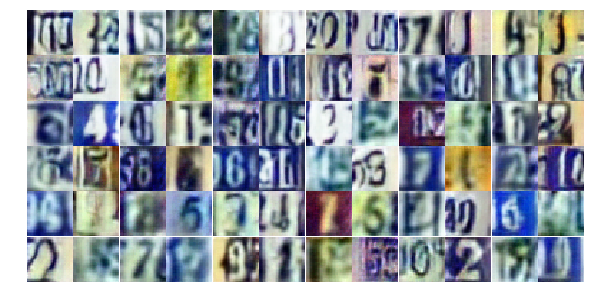

Epoch 17/25... Discriminator Loss: 0.6194... Generator Loss: 2.1906
Epoch 17/25... Discriminator Loss: 0.7354... Generator Loss: 1.5320
Epoch 17/25... Discriminator Loss: 0.8141... Generator Loss: 1.2867
Epoch 17/25... Discriminator Loss: 0.8568... Generator Loss: 1.0850
Epoch 17/25... Discriminator Loss: 1.8871... Generator Loss: 0.3323
Epoch 17/25... Discriminator Loss: 0.8716... Generator Loss: 1.3606
Epoch 17/25... Discriminator Loss: 0.8520... Generator Loss: 1.2136
Epoch 17/25... Discriminator Loss: 0.7978... Generator Loss: 1.1864
Epoch 17/25... Discriminator Loss: 0.5720... Generator Loss: 1.9209
Epoch 17/25... Discriminator Loss: 0.9081... Generator Loss: 1.6805


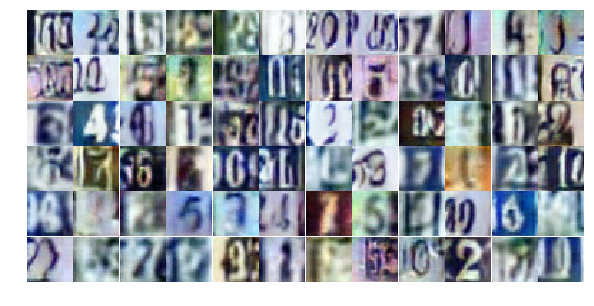

Epoch 17/25... Discriminator Loss: 0.9270... Generator Loss: 1.5463
Epoch 17/25... Discriminator Loss: 1.1738... Generator Loss: 0.6759
Epoch 17/25... Discriminator Loss: 0.6887... Generator Loss: 1.4977
Epoch 17/25... Discriminator Loss: 1.1354... Generator Loss: 0.7858
Epoch 17/25... Discriminator Loss: 0.7996... Generator Loss: 1.5452
Epoch 17/25... Discriminator Loss: 1.4129... Generator Loss: 0.5473
Epoch 17/25... Discriminator Loss: 0.8207... Generator Loss: 1.8190
Epoch 17/25... Discriminator Loss: 0.7496... Generator Loss: 1.3053
Epoch 17/25... Discriminator Loss: 0.8044... Generator Loss: 1.2444
Epoch 17/25... Discriminator Loss: 0.8452... Generator Loss: 1.1234


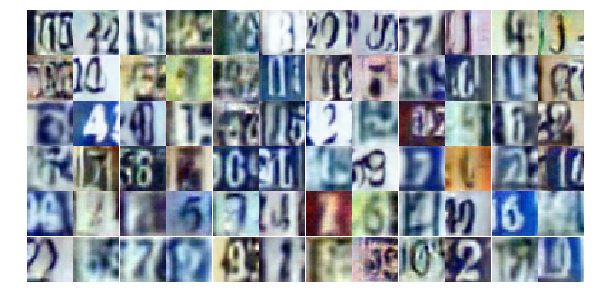

Epoch 17/25... Discriminator Loss: 1.5894... Generator Loss: 0.4822
Epoch 17/25... Discriminator Loss: 0.5771... Generator Loss: 1.9849
Epoch 17/25... Discriminator Loss: 0.6168... Generator Loss: 1.6328
Epoch 17/25... Discriminator Loss: 1.0506... Generator Loss: 0.8257
Epoch 17/25... Discriminator Loss: 1.6030... Generator Loss: 0.4506
Epoch 17/25... Discriminator Loss: 0.7834... Generator Loss: 1.2754
Epoch 17/25... Discriminator Loss: 0.6822... Generator Loss: 1.4591
Epoch 17/25... Discriminator Loss: 1.1090... Generator Loss: 0.7793
Epoch 17/25... Discriminator Loss: 1.2068... Generator Loss: 0.6474
Epoch 17/25... Discriminator Loss: 0.6863... Generator Loss: 1.4747


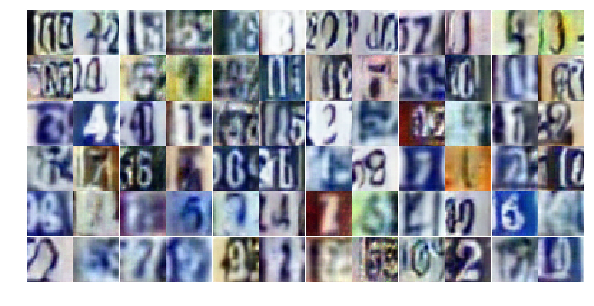

Epoch 17/25... Discriminator Loss: 0.8984... Generator Loss: 1.1977
Epoch 17/25... Discriminator Loss: 1.0628... Generator Loss: 1.3065
Epoch 17/25... Discriminator Loss: 0.8507... Generator Loss: 1.8020
Epoch 17/25... Discriminator Loss: 0.9639... Generator Loss: 1.7673
Epoch 17/25... Discriminator Loss: 1.0693... Generator Loss: 0.8494
Epoch 17/25... Discriminator Loss: 0.8208... Generator Loss: 1.2098
Epoch 17/25... Discriminator Loss: 0.9039... Generator Loss: 1.1303
Epoch 17/25... Discriminator Loss: 0.6016... Generator Loss: 1.8139
Epoch 17/25... Discriminator Loss: 0.6339... Generator Loss: 1.8625
Epoch 17/25... Discriminator Loss: 1.1789... Generator Loss: 0.6889


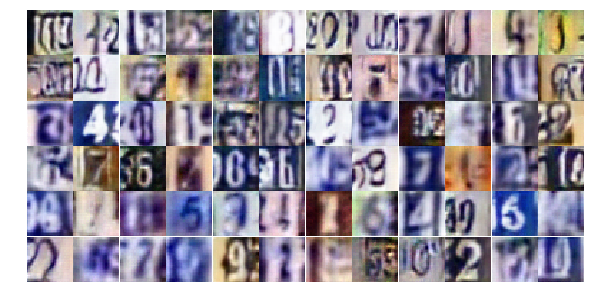

Epoch 17/25... Discriminator Loss: 1.6049... Generator Loss: 0.4739
Epoch 17/25... Discriminator Loss: 0.5693... Generator Loss: 2.1262
Epoch 17/25... Discriminator Loss: 0.9374... Generator Loss: 1.3120
Epoch 17/25... Discriminator Loss: 0.7057... Generator Loss: 1.3730
Epoch 17/25... Discriminator Loss: 0.8066... Generator Loss: 1.1376
Epoch 17/25... Discriminator Loss: 1.0296... Generator Loss: 0.8147
Epoch 17/25... Discriminator Loss: 1.3212... Generator Loss: 0.5692
Epoch 17/25... Discriminator Loss: 0.7347... Generator Loss: 1.3353
Epoch 17/25... Discriminator Loss: 0.7453... Generator Loss: 1.7662
Epoch 17/25... Discriminator Loss: 1.5372... Generator Loss: 0.4613


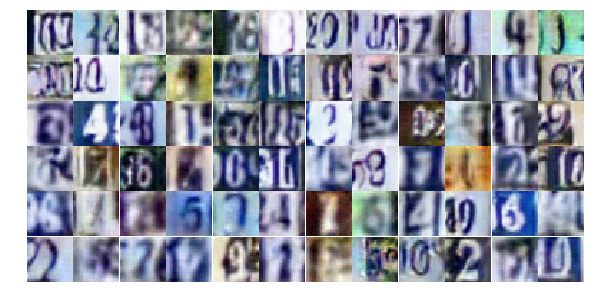

Epoch 17/25... Discriminator Loss: 0.8876... Generator Loss: 1.3738
Epoch 17/25... Discriminator Loss: 1.3165... Generator Loss: 0.5882
Epoch 17/25... Discriminator Loss: 0.7055... Generator Loss: 1.4359
Epoch 17/25... Discriminator Loss: 1.5368... Generator Loss: 3.7134
Epoch 18/25... Discriminator Loss: 1.0052... Generator Loss: 0.9198
Epoch 18/25... Discriminator Loss: 1.1968... Generator Loss: 0.6734
Epoch 18/25... Discriminator Loss: 0.9140... Generator Loss: 1.0293
Epoch 18/25... Discriminator Loss: 0.8572... Generator Loss: 1.0486
Epoch 18/25... Discriminator Loss: 1.2690... Generator Loss: 0.5775
Epoch 18/25... Discriminator Loss: 0.8569... Generator Loss: 1.1045


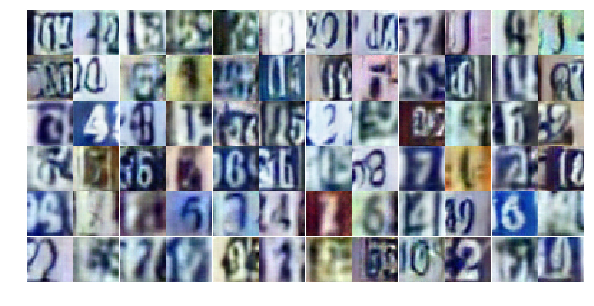

Epoch 18/25... Discriminator Loss: 0.7063... Generator Loss: 1.9495
Epoch 18/25... Discriminator Loss: 1.2076... Generator Loss: 0.6800
Epoch 18/25... Discriminator Loss: 1.1059... Generator Loss: 0.7809
Epoch 18/25... Discriminator Loss: 0.6310... Generator Loss: 1.9215
Epoch 18/25... Discriminator Loss: 0.8358... Generator Loss: 1.1201
Epoch 18/25... Discriminator Loss: 1.0322... Generator Loss: 0.8316
Epoch 18/25... Discriminator Loss: 0.8485... Generator Loss: 1.1477
Epoch 18/25... Discriminator Loss: 0.8591... Generator Loss: 1.1325
Epoch 18/25... Discriminator Loss: 0.8981... Generator Loss: 1.0336
Epoch 18/25... Discriminator Loss: 0.5906... Generator Loss: 1.7892


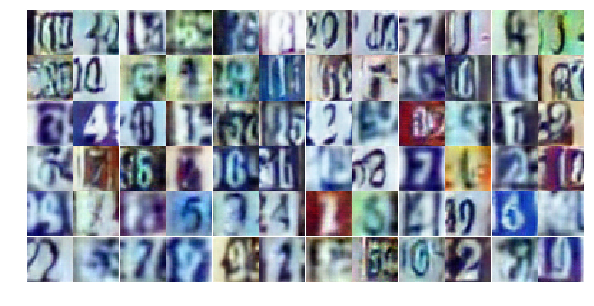

Epoch 18/25... Discriminator Loss: 0.9786... Generator Loss: 1.0772
Epoch 18/25... Discriminator Loss: 1.0763... Generator Loss: 0.8026
Epoch 18/25... Discriminator Loss: 1.1800... Generator Loss: 0.6893
Epoch 18/25... Discriminator Loss: 0.7307... Generator Loss: 1.3186
Epoch 18/25... Discriminator Loss: 0.7832... Generator Loss: 1.2850
Epoch 18/25... Discriminator Loss: 0.9357... Generator Loss: 0.9940
Epoch 18/25... Discriminator Loss: 1.0362... Generator Loss: 1.8803
Epoch 18/25... Discriminator Loss: 1.0550... Generator Loss: 0.7844
Epoch 18/25... Discriminator Loss: 0.8815... Generator Loss: 1.0277
Epoch 18/25... Discriminator Loss: 0.6995... Generator Loss: 1.5470


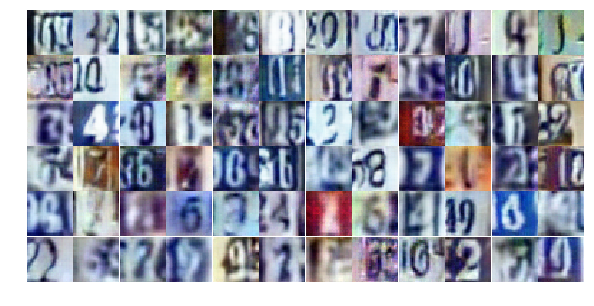

Epoch 18/25... Discriminator Loss: 0.6447... Generator Loss: 1.7625
Epoch 18/25... Discriminator Loss: 1.1036... Generator Loss: 2.2574
Epoch 18/25... Discriminator Loss: 0.9241... Generator Loss: 0.9877
Epoch 18/25... Discriminator Loss: 0.7620... Generator Loss: 1.4898
Epoch 18/25... Discriminator Loss: 1.1721... Generator Loss: 0.7107
Epoch 18/25... Discriminator Loss: 0.7259... Generator Loss: 1.4808
Epoch 18/25... Discriminator Loss: 0.8395... Generator Loss: 1.1403
Epoch 18/25... Discriminator Loss: 0.6856... Generator Loss: 1.5989
Epoch 18/25... Discriminator Loss: 0.7558... Generator Loss: 1.3097
Epoch 18/25... Discriminator Loss: 0.7329... Generator Loss: 1.3882


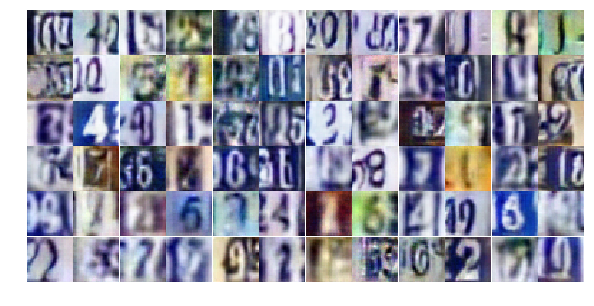

Epoch 18/25... Discriminator Loss: 0.6636... Generator Loss: 1.5554
Epoch 18/25... Discriminator Loss: 0.7839... Generator Loss: 1.2737
Epoch 18/25... Discriminator Loss: 0.6152... Generator Loss: 1.6174
Epoch 18/25... Discriminator Loss: 0.7419... Generator Loss: 1.3898
Epoch 18/25... Discriminator Loss: 0.8353... Generator Loss: 1.1780
Epoch 18/25... Discriminator Loss: 0.5700... Generator Loss: 1.8898
Epoch 18/25... Discriminator Loss: 1.0660... Generator Loss: 0.8335
Epoch 18/25... Discriminator Loss: 0.9114... Generator Loss: 1.5487
Epoch 18/25... Discriminator Loss: 1.0990... Generator Loss: 0.8595
Epoch 18/25... Discriminator Loss: 0.5923... Generator Loss: 1.8691


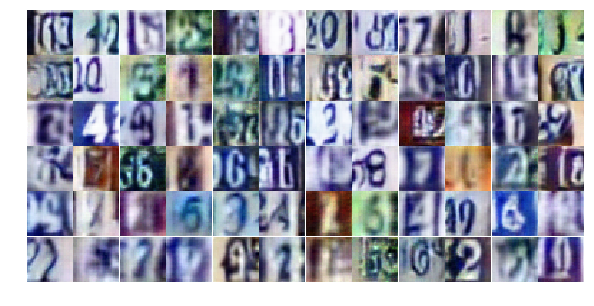

Epoch 18/25... Discriminator Loss: 0.7254... Generator Loss: 1.3264
Epoch 18/25... Discriminator Loss: 0.8156... Generator Loss: 1.1845
Epoch 18/25... Discriminator Loss: 0.8583... Generator Loss: 1.1117
Epoch 18/25... Discriminator Loss: 1.0652... Generator Loss: 0.8230
Epoch 18/25... Discriminator Loss: 1.1690... Generator Loss: 0.7417
Epoch 18/25... Discriminator Loss: 1.4558... Generator Loss: 0.5183
Epoch 18/25... Discriminator Loss: 0.7152... Generator Loss: 1.4704
Epoch 18/25... Discriminator Loss: 0.7414... Generator Loss: 1.4723
Epoch 18/25... Discriminator Loss: 0.9949... Generator Loss: 0.8938
Epoch 18/25... Discriminator Loss: 0.9036... Generator Loss: 1.0137


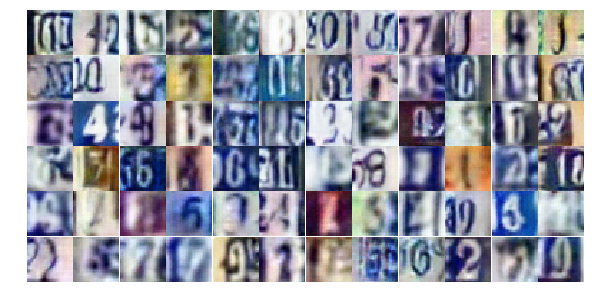

Epoch 18/25... Discriminator Loss: 0.8187... Generator Loss: 1.8356
Epoch 19/25... Discriminator Loss: 1.1885... Generator Loss: 0.6923
Epoch 19/25... Discriminator Loss: 1.3331... Generator Loss: 0.6215
Epoch 19/25... Discriminator Loss: 0.8487... Generator Loss: 1.2551
Epoch 19/25... Discriminator Loss: 0.8359... Generator Loss: 1.5864
Epoch 19/25... Discriminator Loss: 1.0878... Generator Loss: 0.7750
Epoch 19/25... Discriminator Loss: 0.6743... Generator Loss: 2.1504
Epoch 19/25... Discriminator Loss: 0.8946... Generator Loss: 1.2758
Epoch 19/25... Discriminator Loss: 1.1987... Generator Loss: 0.6808
Epoch 19/25... Discriminator Loss: 1.3134... Generator Loss: 0.5874


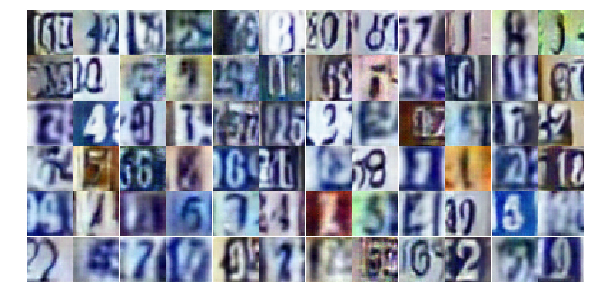

Epoch 19/25... Discriminator Loss: 1.0778... Generator Loss: 0.7834
Epoch 19/25... Discriminator Loss: 1.1055... Generator Loss: 0.7592
Epoch 19/25... Discriminator Loss: 0.9663... Generator Loss: 0.9465
Epoch 19/25... Discriminator Loss: 1.3849... Generator Loss: 0.5209
Epoch 19/25... Discriminator Loss: 1.1793... Generator Loss: 0.6844
Epoch 19/25... Discriminator Loss: 0.7477... Generator Loss: 1.5804
Epoch 19/25... Discriminator Loss: 0.9312... Generator Loss: 0.9915
Epoch 19/25... Discriminator Loss: 0.7921... Generator Loss: 1.2397
Epoch 19/25... Discriminator Loss: 0.9094... Generator Loss: 1.6678
Epoch 19/25... Discriminator Loss: 1.4828... Generator Loss: 0.4779


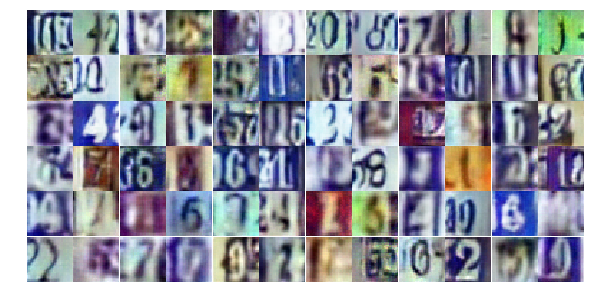

Epoch 19/25... Discriminator Loss: 0.7459... Generator Loss: 1.4575
Epoch 19/25... Discriminator Loss: 1.0769... Generator Loss: 0.8473
Epoch 19/25... Discriminator Loss: 1.2492... Generator Loss: 0.6654
Epoch 19/25... Discriminator Loss: 0.8511... Generator Loss: 1.1808
Epoch 19/25... Discriminator Loss: 1.3065... Generator Loss: 0.5982
Epoch 19/25... Discriminator Loss: 0.9140... Generator Loss: 1.3438
Epoch 19/25... Discriminator Loss: 0.8506... Generator Loss: 1.3975
Epoch 19/25... Discriminator Loss: 0.7615... Generator Loss: 1.6724
Epoch 19/25... Discriminator Loss: 0.6914... Generator Loss: 1.5050
Epoch 19/25... Discriminator Loss: 1.0405... Generator Loss: 0.8995


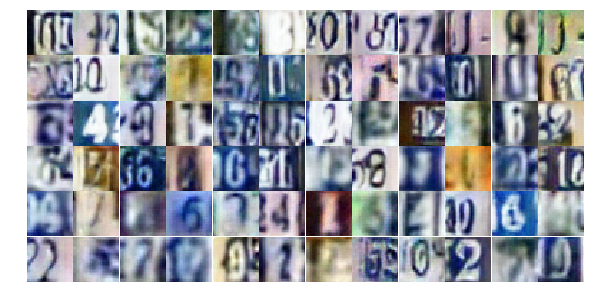

Epoch 19/25... Discriminator Loss: 1.2412... Generator Loss: 0.6265
Epoch 19/25... Discriminator Loss: 0.7621... Generator Loss: 1.2429
Epoch 19/25... Discriminator Loss: 0.9662... Generator Loss: 0.9802
Epoch 19/25... Discriminator Loss: 0.7247... Generator Loss: 1.4373
Epoch 19/25... Discriminator Loss: 0.7010... Generator Loss: 1.6924
Epoch 19/25... Discriminator Loss: 1.4966... Generator Loss: 0.4997
Epoch 19/25... Discriminator Loss: 0.8766... Generator Loss: 2.3990
Epoch 19/25... Discriminator Loss: 0.6263... Generator Loss: 1.8948
Epoch 19/25... Discriminator Loss: 0.9626... Generator Loss: 1.0401
Epoch 19/25... Discriminator Loss: 0.6934... Generator Loss: 1.7885


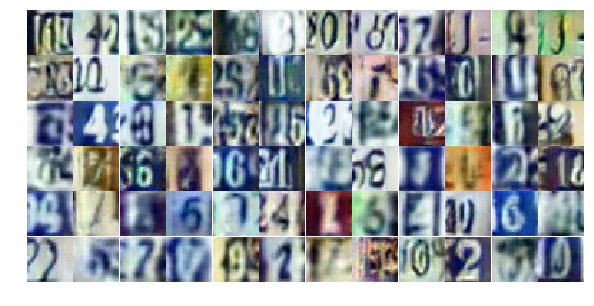

Epoch 19/25... Discriminator Loss: 0.7173... Generator Loss: 1.2991
Epoch 19/25... Discriminator Loss: 0.8320... Generator Loss: 1.1251
Epoch 19/25... Discriminator Loss: 1.3918... Generator Loss: 0.5430
Epoch 19/25... Discriminator Loss: 0.8317... Generator Loss: 1.1035
Epoch 19/25... Discriminator Loss: 0.7547... Generator Loss: 1.4577
Epoch 19/25... Discriminator Loss: 0.9436... Generator Loss: 1.9771
Epoch 19/25... Discriminator Loss: 0.8457... Generator Loss: 1.1769
Epoch 19/25... Discriminator Loss: 0.6307... Generator Loss: 1.8773
Epoch 19/25... Discriminator Loss: 0.7784... Generator Loss: 1.4162
Epoch 19/25... Discriminator Loss: 0.8828... Generator Loss: 1.1630


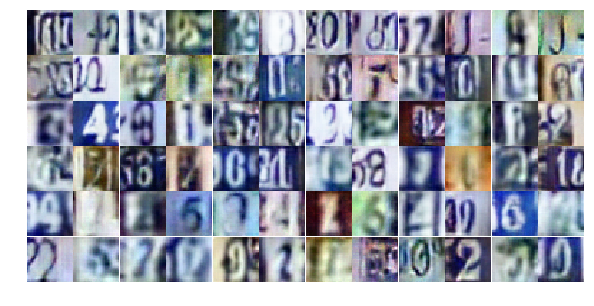

Epoch 19/25... Discriminator Loss: 0.7114... Generator Loss: 1.3733
Epoch 19/25... Discriminator Loss: 1.0737... Generator Loss: 0.8181
Epoch 19/25... Discriminator Loss: 0.8935... Generator Loss: 1.1544
Epoch 19/25... Discriminator Loss: 1.2322... Generator Loss: 0.6994
Epoch 19/25... Discriminator Loss: 0.9376... Generator Loss: 0.9371
Epoch 19/25... Discriminator Loss: 0.9756... Generator Loss: 0.9559
Epoch 19/25... Discriminator Loss: 2.0620... Generator Loss: 0.2787
Epoch 19/25... Discriminator Loss: 0.8877... Generator Loss: 1.0477
Epoch 20/25... Discriminator Loss: 1.1021... Generator Loss: 0.8664
Epoch 20/25... Discriminator Loss: 0.7500... Generator Loss: 1.5634


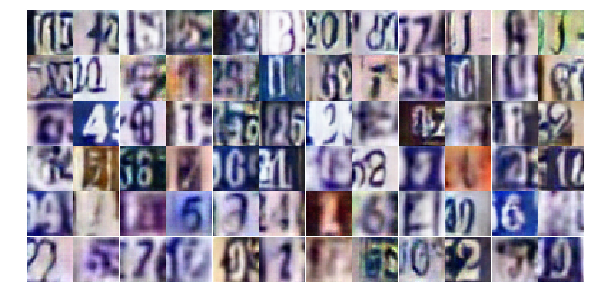

Epoch 20/25... Discriminator Loss: 0.7227... Generator Loss: 1.3689
Epoch 20/25... Discriminator Loss: 0.9513... Generator Loss: 0.9965
Epoch 20/25... Discriminator Loss: 1.4700... Generator Loss: 0.4970
Epoch 20/25... Discriminator Loss: 1.1550... Generator Loss: 0.7266
Epoch 20/25... Discriminator Loss: 0.8004... Generator Loss: 1.2151
Epoch 20/25... Discriminator Loss: 0.7597... Generator Loss: 1.2697
Epoch 20/25... Discriminator Loss: 0.8755... Generator Loss: 1.3034
Epoch 20/25... Discriminator Loss: 0.8256... Generator Loss: 1.3128
Epoch 20/25... Discriminator Loss: 0.8815... Generator Loss: 1.0822
Epoch 20/25... Discriminator Loss: 0.8671... Generator Loss: 1.0873


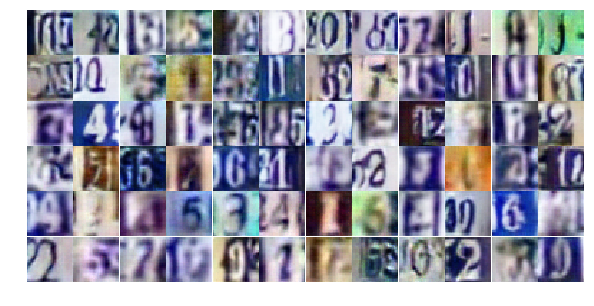

Epoch 20/25... Discriminator Loss: 1.1465... Generator Loss: 0.7262
Epoch 20/25... Discriminator Loss: 1.2543... Generator Loss: 0.6437
Epoch 20/25... Discriminator Loss: 0.8114... Generator Loss: 1.3154
Epoch 20/25... Discriminator Loss: 4.8899... Generator Loss: 0.0745
Epoch 20/25... Discriminator Loss: 1.3346... Generator Loss: 1.4158
Epoch 20/25... Discriminator Loss: 1.1601... Generator Loss: 1.1629
Epoch 20/25... Discriminator Loss: 1.3597... Generator Loss: 0.5928
Epoch 20/25... Discriminator Loss: 0.9238... Generator Loss: 1.2309
Epoch 20/25... Discriminator Loss: 0.9507... Generator Loss: 0.9814
Epoch 20/25... Discriminator Loss: 1.0886... Generator Loss: 0.8678


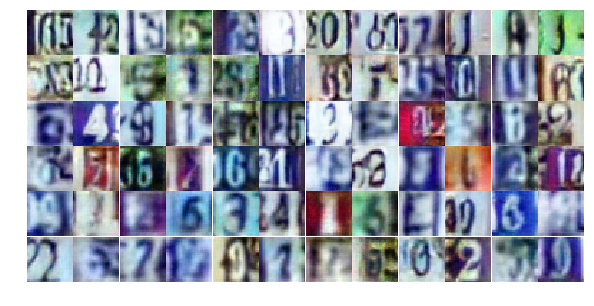

Epoch 20/25... Discriminator Loss: 0.7309... Generator Loss: 1.3838
Epoch 20/25... Discriminator Loss: 1.0722... Generator Loss: 0.8026
Epoch 20/25... Discriminator Loss: 0.7121... Generator Loss: 1.8602
Epoch 20/25... Discriminator Loss: 1.4767... Generator Loss: 0.4995
Epoch 20/25... Discriminator Loss: 0.9352... Generator Loss: 1.1325
Epoch 20/25... Discriminator Loss: 0.8389... Generator Loss: 1.2977
Epoch 20/25... Discriminator Loss: 0.8058... Generator Loss: 1.3609
Epoch 20/25... Discriminator Loss: 1.7745... Generator Loss: 0.3419
Epoch 20/25... Discriminator Loss: 0.9760... Generator Loss: 0.9419
Epoch 20/25... Discriminator Loss: 0.7507... Generator Loss: 1.2782


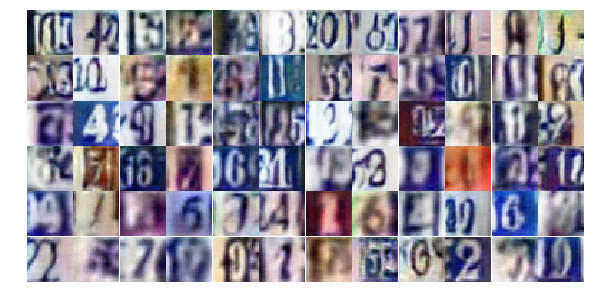

Epoch 20/25... Discriminator Loss: 0.9795... Generator Loss: 0.9252
Epoch 20/25... Discriminator Loss: 0.8271... Generator Loss: 1.1747
Epoch 20/25... Discriminator Loss: 1.0482... Generator Loss: 0.8669
Epoch 20/25... Discriminator Loss: 0.9209... Generator Loss: 1.1745
Epoch 20/25... Discriminator Loss: 0.8590... Generator Loss: 1.4295
Epoch 20/25... Discriminator Loss: 0.7758... Generator Loss: 1.2939
Epoch 20/25... Discriminator Loss: 0.8038... Generator Loss: 1.7422
Epoch 20/25... Discriminator Loss: 1.3445... Generator Loss: 0.5457
Epoch 20/25... Discriminator Loss: 0.9883... Generator Loss: 1.6487
Epoch 20/25... Discriminator Loss: 1.0182... Generator Loss: 0.9000


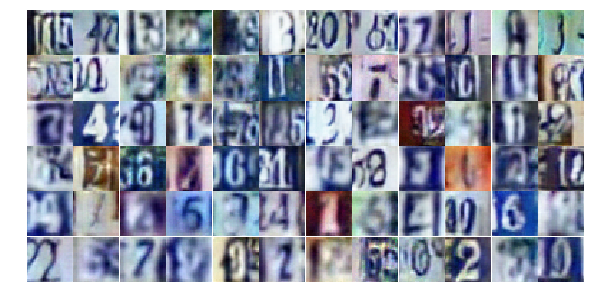

Epoch 20/25... Discriminator Loss: 1.3608... Generator Loss: 0.5972
Epoch 20/25... Discriminator Loss: 1.0384... Generator Loss: 0.9863
Epoch 20/25... Discriminator Loss: 0.8269... Generator Loss: 1.7590
Epoch 20/25... Discriminator Loss: 0.8798... Generator Loss: 1.0993
Epoch 20/25... Discriminator Loss: 0.8355... Generator Loss: 1.4030
Epoch 20/25... Discriminator Loss: 0.9768... Generator Loss: 1.0327
Epoch 20/25... Discriminator Loss: 1.0570... Generator Loss: 0.8340
Epoch 20/25... Discriminator Loss: 0.7744... Generator Loss: 1.4231
Epoch 20/25... Discriminator Loss: 0.8087... Generator Loss: 1.4564
Epoch 20/25... Discriminator Loss: 0.8156... Generator Loss: 1.1193


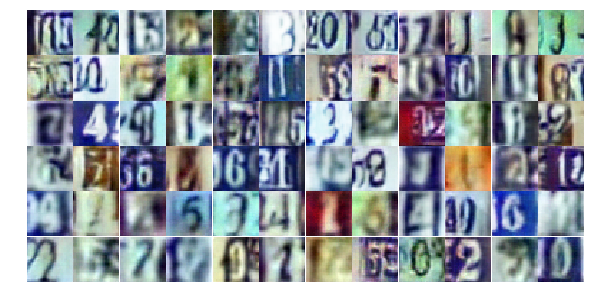

Epoch 20/25... Discriminator Loss: 0.6813... Generator Loss: 1.5890
Epoch 20/25... Discriminator Loss: 1.1607... Generator Loss: 0.7399
Epoch 20/25... Discriminator Loss: 0.7482... Generator Loss: 1.9564
Epoch 20/25... Discriminator Loss: 0.9544... Generator Loss: 1.2145
Epoch 20/25... Discriminator Loss: 1.1202... Generator Loss: 0.7772
Epoch 20/25... Discriminator Loss: 0.7149... Generator Loss: 1.4436
Epoch 21/25... Discriminator Loss: 1.0519... Generator Loss: 0.8807
Epoch 21/25... Discriminator Loss: 1.5708... Generator Loss: 0.4327
Epoch 21/25... Discriminator Loss: 1.3723... Generator Loss: 0.5564
Epoch 21/25... Discriminator Loss: 1.0324... Generator Loss: 0.8226


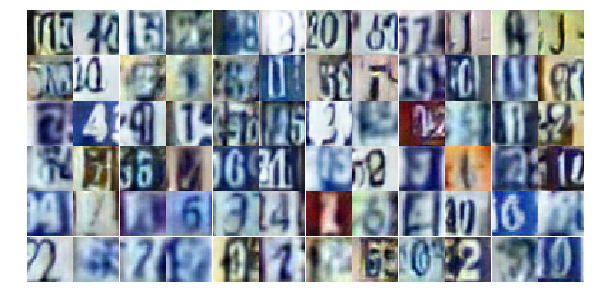

Epoch 21/25... Discriminator Loss: 1.1294... Generator Loss: 0.7298
Epoch 21/25... Discriminator Loss: 1.2686... Generator Loss: 0.6286
Epoch 21/25... Discriminator Loss: 0.6964... Generator Loss: 1.5990
Epoch 21/25... Discriminator Loss: 0.6849... Generator Loss: 1.4870
Epoch 21/25... Discriminator Loss: 0.7914... Generator Loss: 1.3297
Epoch 21/25... Discriminator Loss: 0.6002... Generator Loss: 1.7645
Epoch 21/25... Discriminator Loss: 0.9543... Generator Loss: 0.9114
Epoch 21/25... Discriminator Loss: 0.9372... Generator Loss: 1.7403
Epoch 21/25... Discriminator Loss: 0.7819... Generator Loss: 1.2222
Epoch 21/25... Discriminator Loss: 1.1769... Generator Loss: 0.6829


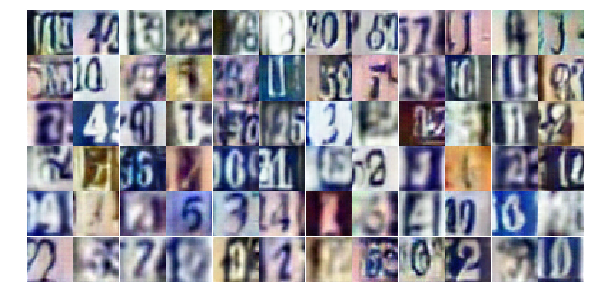

Epoch 21/25... Discriminator Loss: 0.5875... Generator Loss: 2.0642
Epoch 21/25... Discriminator Loss: 1.1439... Generator Loss: 0.7276
Epoch 21/25... Discriminator Loss: 1.8757... Generator Loss: 0.3789
Epoch 21/25... Discriminator Loss: 0.9283... Generator Loss: 1.0444
Epoch 21/25... Discriminator Loss: 0.7128... Generator Loss: 1.7382
Epoch 21/25... Discriminator Loss: 1.2526... Generator Loss: 0.6890
Epoch 21/25... Discriminator Loss: 1.0748... Generator Loss: 0.8181
Epoch 21/25... Discriminator Loss: 0.7140... Generator Loss: 1.4266
Epoch 21/25... Discriminator Loss: 0.7031... Generator Loss: 1.5326
Epoch 21/25... Discriminator Loss: 0.8190... Generator Loss: 1.3252


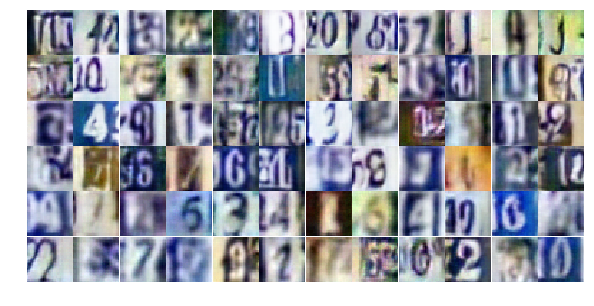

Epoch 21/25... Discriminator Loss: 1.0220... Generator Loss: 0.9163
Epoch 21/25... Discriminator Loss: 0.6337... Generator Loss: 1.8362
Epoch 21/25... Discriminator Loss: 1.0763... Generator Loss: 1.1895
Epoch 21/25... Discriminator Loss: 0.7642... Generator Loss: 1.3771
Epoch 21/25... Discriminator Loss: 0.7862... Generator Loss: 1.2992
Epoch 21/25... Discriminator Loss: 1.0892... Generator Loss: 0.8207
Epoch 21/25... Discriminator Loss: 0.8269... Generator Loss: 1.2100
Epoch 21/25... Discriminator Loss: 0.8616... Generator Loss: 1.1169
Epoch 21/25... Discriminator Loss: 1.0834... Generator Loss: 0.7967
Epoch 21/25... Discriminator Loss: 1.3957... Generator Loss: 0.5481


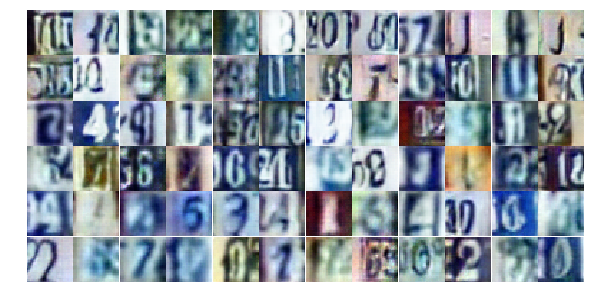

Epoch 21/25... Discriminator Loss: 1.5592... Generator Loss: 0.4620
Epoch 21/25... Discriminator Loss: 0.7597... Generator Loss: 1.5248
Epoch 21/25... Discriminator Loss: 0.9246... Generator Loss: 1.0299
Epoch 21/25... Discriminator Loss: 0.6577... Generator Loss: 1.5907
Epoch 21/25... Discriminator Loss: 0.8635... Generator Loss: 1.0333
Epoch 21/25... Discriminator Loss: 0.8415... Generator Loss: 1.2235
Epoch 21/25... Discriminator Loss: 0.9596... Generator Loss: 0.9516
Epoch 21/25... Discriminator Loss: 1.7381... Generator Loss: 0.4003
Epoch 21/25... Discriminator Loss: 1.0136... Generator Loss: 0.8772
Epoch 21/25... Discriminator Loss: 0.6895... Generator Loss: 2.5421


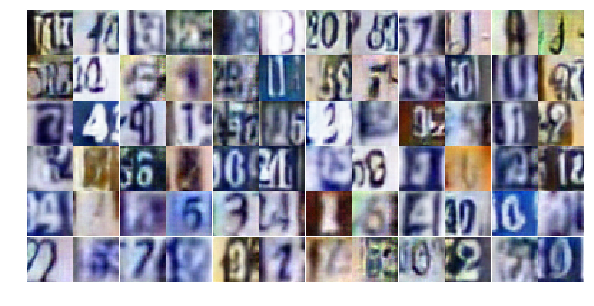

Epoch 21/25... Discriminator Loss: 0.9027... Generator Loss: 1.0984
Epoch 21/25... Discriminator Loss: 1.0527... Generator Loss: 0.8607
Epoch 21/25... Discriminator Loss: 0.7366... Generator Loss: 1.3487
Epoch 21/25... Discriminator Loss: 0.8141... Generator Loss: 1.2689
Epoch 21/25... Discriminator Loss: 0.6999... Generator Loss: 1.5943
Epoch 21/25... Discriminator Loss: 0.7634... Generator Loss: 1.4914
Epoch 21/25... Discriminator Loss: 0.8572... Generator Loss: 1.2086
Epoch 21/25... Discriminator Loss: 1.2618... Generator Loss: 0.6137
Epoch 21/25... Discriminator Loss: 1.3696... Generator Loss: 0.6038
Epoch 21/25... Discriminator Loss: 0.9525... Generator Loss: 0.9495


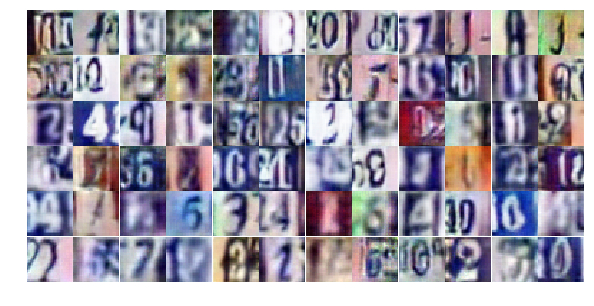

Epoch 21/25... Discriminator Loss: 0.7832... Generator Loss: 1.7430
Epoch 21/25... Discriminator Loss: 1.1482... Generator Loss: 0.7809
Epoch 21/25... Discriminator Loss: 1.4221... Generator Loss: 0.5070
Epoch 22/25... Discriminator Loss: 1.0398... Generator Loss: 0.8939
Epoch 22/25... Discriminator Loss: 1.0797... Generator Loss: 0.7973
Epoch 22/25... Discriminator Loss: 0.8821... Generator Loss: 1.1557
Epoch 22/25... Discriminator Loss: 0.6639... Generator Loss: 1.6769
Epoch 22/25... Discriminator Loss: 0.8355... Generator Loss: 1.1040
Epoch 22/25... Discriminator Loss: 0.9906... Generator Loss: 0.9407
Epoch 22/25... Discriminator Loss: 1.0153... Generator Loss: 0.8707


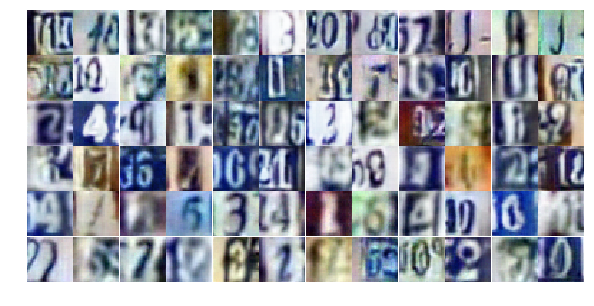

Epoch 22/25... Discriminator Loss: 0.7230... Generator Loss: 1.7360
Epoch 22/25... Discriminator Loss: 0.8493... Generator Loss: 1.1621
Epoch 22/25... Discriminator Loss: 1.2594... Generator Loss: 0.6265
Epoch 22/25... Discriminator Loss: 1.1546... Generator Loss: 0.7001
Epoch 22/25... Discriminator Loss: 0.8625... Generator Loss: 1.2954
Epoch 22/25... Discriminator Loss: 0.9024... Generator Loss: 1.1490
Epoch 22/25... Discriminator Loss: 0.8749... Generator Loss: 1.0830
Epoch 22/25... Discriminator Loss: 0.6868... Generator Loss: 1.4246
Epoch 22/25... Discriminator Loss: 1.0361... Generator Loss: 0.9624
Epoch 22/25... Discriminator Loss: 2.0051... Generator Loss: 0.2690


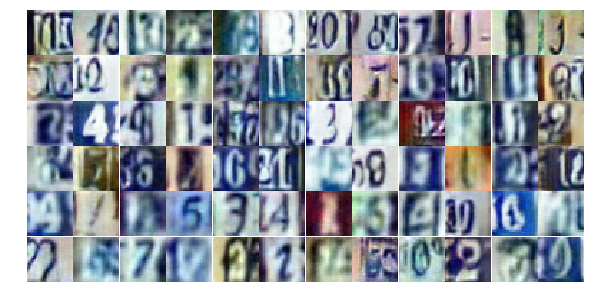

Epoch 22/25... Discriminator Loss: 0.7976... Generator Loss: 1.2579
Epoch 22/25... Discriminator Loss: 0.8704... Generator Loss: 1.0899
Epoch 22/25... Discriminator Loss: 0.9605... Generator Loss: 0.9350
Epoch 22/25... Discriminator Loss: 0.6316... Generator Loss: 1.6945
Epoch 22/25... Discriminator Loss: 0.7340... Generator Loss: 1.3794
Epoch 22/25... Discriminator Loss: 1.0081... Generator Loss: 0.8508
Epoch 22/25... Discriminator Loss: 0.7408... Generator Loss: 1.4706
Epoch 22/25... Discriminator Loss: 0.6439... Generator Loss: 1.6680
Epoch 22/25... Discriminator Loss: 0.7668... Generator Loss: 1.5573
Epoch 22/25... Discriminator Loss: 0.9364... Generator Loss: 0.9536


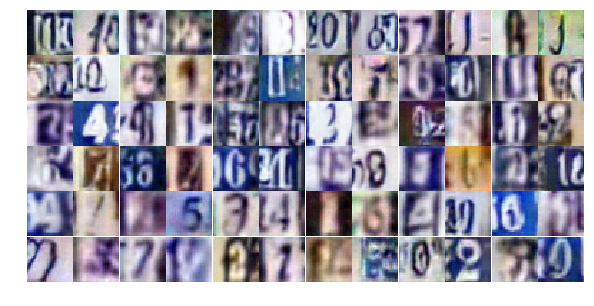

Epoch 22/25... Discriminator Loss: 0.7001... Generator Loss: 2.0127
Epoch 22/25... Discriminator Loss: 0.7260... Generator Loss: 1.4538
Epoch 22/25... Discriminator Loss: 1.6879... Generator Loss: 0.4001
Epoch 22/25... Discriminator Loss: 0.7620... Generator Loss: 1.4315
Epoch 22/25... Discriminator Loss: 0.9141... Generator Loss: 1.1316
Epoch 22/25... Discriminator Loss: 0.9527... Generator Loss: 0.9946
Epoch 22/25... Discriminator Loss: 1.3831... Generator Loss: 0.5437
Epoch 22/25... Discriminator Loss: 1.0139... Generator Loss: 2.3735
Epoch 22/25... Discriminator Loss: 0.9221... Generator Loss: 1.3364
Epoch 22/25... Discriminator Loss: 1.3592... Generator Loss: 0.5689


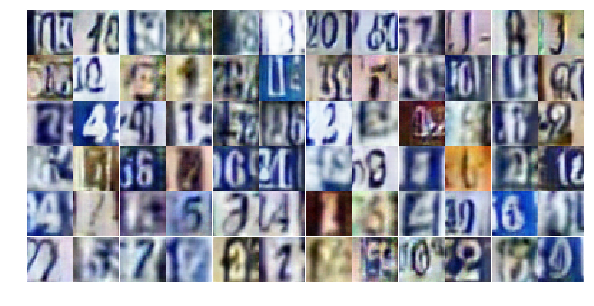

Epoch 22/25... Discriminator Loss: 0.9575... Generator Loss: 1.0429
Epoch 22/25... Discriminator Loss: 0.7093... Generator Loss: 1.4129
Epoch 22/25... Discriminator Loss: 0.6414... Generator Loss: 1.6505
Epoch 22/25... Discriminator Loss: 0.9198... Generator Loss: 1.0234
Epoch 22/25... Discriminator Loss: 0.8713... Generator Loss: 1.0072
Epoch 22/25... Discriminator Loss: 0.7961... Generator Loss: 1.1979
Epoch 22/25... Discriminator Loss: 0.7244... Generator Loss: 1.5827
Epoch 22/25... Discriminator Loss: 1.1346... Generator Loss: 0.7445
Epoch 22/25... Discriminator Loss: 0.9919... Generator Loss: 0.9706
Epoch 22/25... Discriminator Loss: 0.8200... Generator Loss: 1.1901


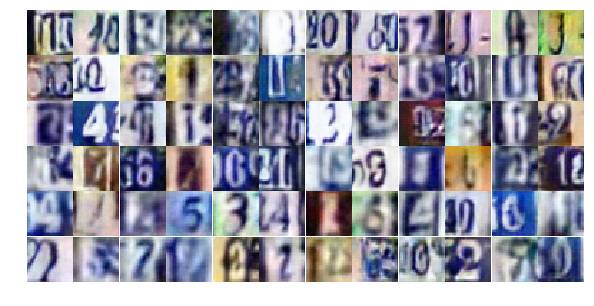

Epoch 22/25... Discriminator Loss: 1.0677... Generator Loss: 0.7771
Epoch 22/25... Discriminator Loss: 0.7270... Generator Loss: 1.4628
Epoch 22/25... Discriminator Loss: 1.0936... Generator Loss: 0.7756
Epoch 22/25... Discriminator Loss: 1.2378... Generator Loss: 0.6676
Epoch 22/25... Discriminator Loss: 1.0814... Generator Loss: 0.8417
Epoch 22/25... Discriminator Loss: 1.0434... Generator Loss: 0.8889
Epoch 22/25... Discriminator Loss: 0.9410... Generator Loss: 1.6366
Epoch 22/25... Discriminator Loss: 0.8132... Generator Loss: 1.5503
Epoch 22/25... Discriminator Loss: 0.9507... Generator Loss: 1.7960
Epoch 22/25... Discriminator Loss: 1.2260... Generator Loss: 0.6497


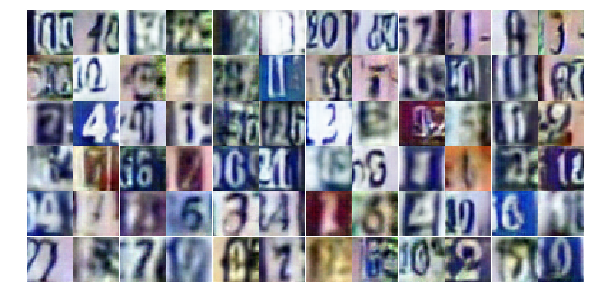

Epoch 23/25... Discriminator Loss: 0.7224... Generator Loss: 1.4768
Epoch 23/25... Discriminator Loss: 0.7233... Generator Loss: 1.5554
Epoch 23/25... Discriminator Loss: 1.2589... Generator Loss: 0.5985
Epoch 23/25... Discriminator Loss: 0.9498... Generator Loss: 0.9419
Epoch 23/25... Discriminator Loss: 0.9831... Generator Loss: 0.9043
Epoch 23/25... Discriminator Loss: 1.4271... Generator Loss: 0.5224
Epoch 23/25... Discriminator Loss: 1.1979... Generator Loss: 0.6937
Epoch 23/25... Discriminator Loss: 0.9133... Generator Loss: 0.9681
Epoch 23/25... Discriminator Loss: 0.8345... Generator Loss: 1.1671
Epoch 23/25... Discriminator Loss: 0.5968... Generator Loss: 1.9077


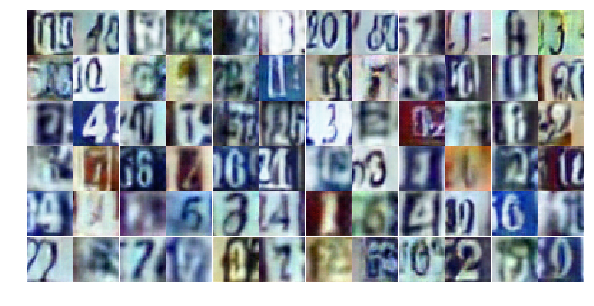

Epoch 23/25... Discriminator Loss: 0.9577... Generator Loss: 2.3853
Epoch 23/25... Discriminator Loss: 0.8372... Generator Loss: 1.1063
Epoch 23/25... Discriminator Loss: 1.1525... Generator Loss: 0.7145
Epoch 23/25... Discriminator Loss: 0.8093... Generator Loss: 1.2167
Epoch 23/25... Discriminator Loss: 0.6683... Generator Loss: 1.5717
Epoch 23/25... Discriminator Loss: 0.8931... Generator Loss: 1.0831
Epoch 23/25... Discriminator Loss: 0.8741... Generator Loss: 1.0915
Epoch 23/25... Discriminator Loss: 0.7097... Generator Loss: 1.6686
Epoch 23/25... Discriminator Loss: 1.0945... Generator Loss: 0.7448
Epoch 23/25... Discriminator Loss: 0.9034... Generator Loss: 1.0748


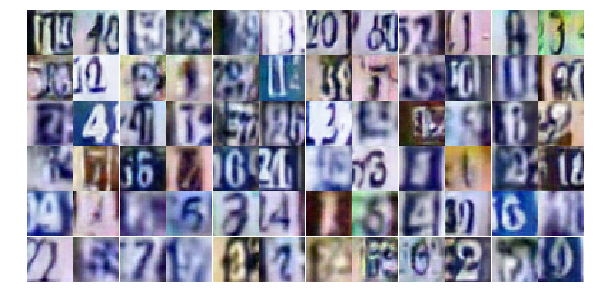

Epoch 23/25... Discriminator Loss: 1.5676... Generator Loss: 0.4894
Epoch 23/25... Discriminator Loss: 0.7968... Generator Loss: 1.4797
Epoch 23/25... Discriminator Loss: 1.2015... Generator Loss: 0.6595
Epoch 23/25... Discriminator Loss: 0.7476... Generator Loss: 1.3706
Epoch 23/25... Discriminator Loss: 0.8149... Generator Loss: 1.2809
Epoch 23/25... Discriminator Loss: 0.9285... Generator Loss: 1.1289
Epoch 23/25... Discriminator Loss: 0.8244... Generator Loss: 1.1075
Epoch 23/25... Discriminator Loss: 0.7701... Generator Loss: 1.3692
Epoch 23/25... Discriminator Loss: 0.7135... Generator Loss: 1.3755
Epoch 23/25... Discriminator Loss: 1.1565... Generator Loss: 2.1700


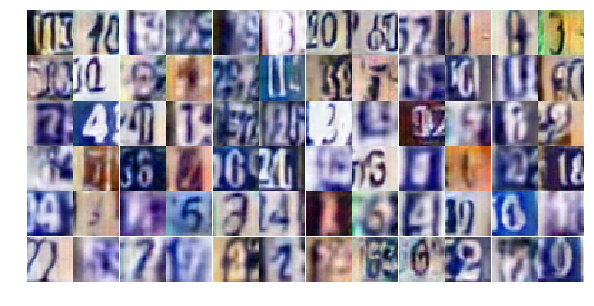

Epoch 23/25... Discriminator Loss: 0.6000... Generator Loss: 2.0655
Epoch 23/25... Discriminator Loss: 0.9349... Generator Loss: 0.9756
Epoch 23/25... Discriminator Loss: 0.7983... Generator Loss: 1.3476
Epoch 23/25... Discriminator Loss: 1.6031... Generator Loss: 0.4707
Epoch 23/25... Discriminator Loss: 1.0599... Generator Loss: 0.8115
Epoch 23/25... Discriminator Loss: 0.8447... Generator Loss: 1.2148
Epoch 23/25... Discriminator Loss: 1.4923... Generator Loss: 0.5105
Epoch 23/25... Discriminator Loss: 0.8284... Generator Loss: 1.1746
Epoch 23/25... Discriminator Loss: 0.7391... Generator Loss: 1.4314
Epoch 23/25... Discriminator Loss: 0.8020... Generator Loss: 1.2304


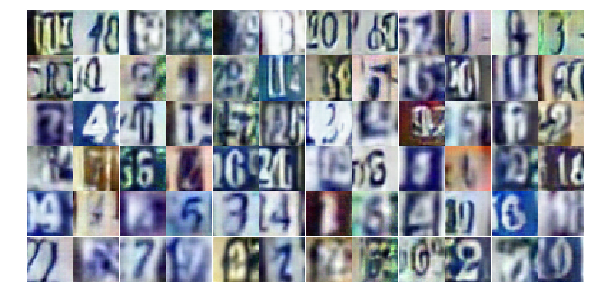

Epoch 23/25... Discriminator Loss: 0.8647... Generator Loss: 1.1753
Epoch 23/25... Discriminator Loss: 0.9203... Generator Loss: 1.1002
Epoch 23/25... Discriminator Loss: 1.7716... Generator Loss: 0.3841
Epoch 23/25... Discriminator Loss: 0.8224... Generator Loss: 1.3820
Epoch 23/25... Discriminator Loss: 0.8963... Generator Loss: 1.2224
Epoch 23/25... Discriminator Loss: 1.0983... Generator Loss: 0.8132
Epoch 23/25... Discriminator Loss: 0.9821... Generator Loss: 0.9411
Epoch 23/25... Discriminator Loss: 1.3054... Generator Loss: 0.6360
Epoch 23/25... Discriminator Loss: 0.7661... Generator Loss: 1.3936
Epoch 23/25... Discriminator Loss: 0.8703... Generator Loss: 1.0936


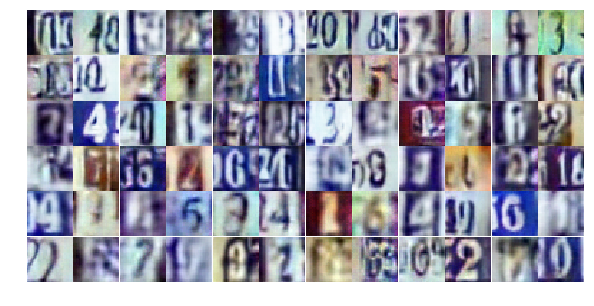

Epoch 23/25... Discriminator Loss: 0.7795... Generator Loss: 1.2605
Epoch 23/25... Discriminator Loss: 1.1009... Generator Loss: 0.7607
Epoch 23/25... Discriminator Loss: 1.2279... Generator Loss: 0.6578
Epoch 23/25... Discriminator Loss: 0.7582... Generator Loss: 2.3852
Epoch 23/25... Discriminator Loss: 1.3233... Generator Loss: 0.7151
Epoch 23/25... Discriminator Loss: 0.9447... Generator Loss: 0.9866
Epoch 23/25... Discriminator Loss: 1.0319... Generator Loss: 0.8882
Epoch 24/25... Discriminator Loss: 0.9423... Generator Loss: 1.0570
Epoch 24/25... Discriminator Loss: 0.8445... Generator Loss: 1.5606
Epoch 24/25... Discriminator Loss: 1.0966... Generator Loss: 0.7573


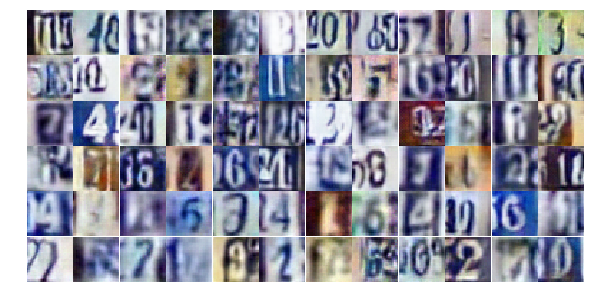

Epoch 24/25... Discriminator Loss: 0.6886... Generator Loss: 2.2549
Epoch 24/25... Discriminator Loss: 0.8278... Generator Loss: 1.1799
Epoch 24/25... Discriminator Loss: 0.7261... Generator Loss: 1.6388
Epoch 24/25... Discriminator Loss: 1.1203... Generator Loss: 0.7870
Epoch 24/25... Discriminator Loss: 0.7807... Generator Loss: 1.2370
Epoch 24/25... Discriminator Loss: 0.9003... Generator Loss: 1.0545
Epoch 24/25... Discriminator Loss: 1.0187... Generator Loss: 0.8851
Epoch 24/25... Discriminator Loss: 1.5356... Generator Loss: 0.5308
Epoch 24/25... Discriminator Loss: 0.6136... Generator Loss: 1.7247
Epoch 24/25... Discriminator Loss: 0.7550... Generator Loss: 1.7573


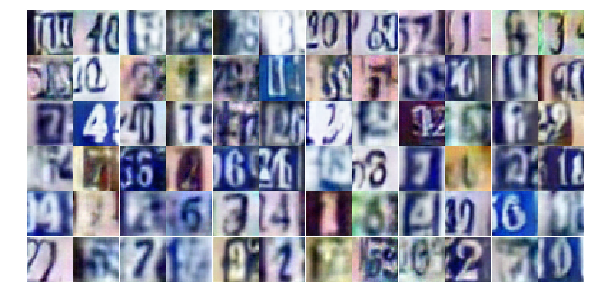

Epoch 24/25... Discriminator Loss: 1.4141... Generator Loss: 0.5536
Epoch 24/25... Discriminator Loss: 0.9668... Generator Loss: 1.0209
Epoch 24/25... Discriminator Loss: 0.9889... Generator Loss: 0.9592
Epoch 24/25... Discriminator Loss: 0.8485... Generator Loss: 1.0480
Epoch 24/25... Discriminator Loss: 1.1137... Generator Loss: 2.5187
Epoch 24/25... Discriminator Loss: 2.2007... Generator Loss: 1.2996
Epoch 24/25... Discriminator Loss: 0.9461... Generator Loss: 0.9846
Epoch 24/25... Discriminator Loss: 1.1304... Generator Loss: 1.1442
Epoch 24/25... Discriminator Loss: 0.8467... Generator Loss: 1.1843
Epoch 24/25... Discriminator Loss: 0.9123... Generator Loss: 1.0623


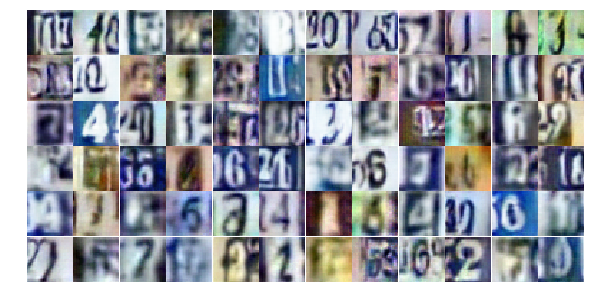

Epoch 24/25... Discriminator Loss: 1.0564... Generator Loss: 0.8146
Epoch 24/25... Discriminator Loss: 0.8764... Generator Loss: 1.0934
Epoch 24/25... Discriminator Loss: 0.7864... Generator Loss: 1.3787
Epoch 24/25... Discriminator Loss: 1.0526... Generator Loss: 0.9245
Epoch 24/25... Discriminator Loss: 0.7995... Generator Loss: 1.3115
Epoch 24/25... Discriminator Loss: 0.7622... Generator Loss: 1.4929
Epoch 24/25... Discriminator Loss: 0.7124... Generator Loss: 1.3634
Epoch 24/25... Discriminator Loss: 0.8433... Generator Loss: 1.2818
Epoch 24/25... Discriminator Loss: 0.8922... Generator Loss: 1.0504
Epoch 24/25... Discriminator Loss: 0.7947... Generator Loss: 1.1987


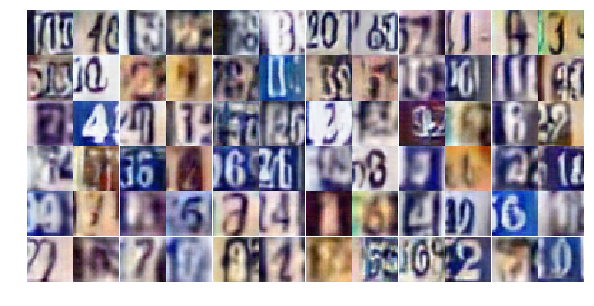

Epoch 24/25... Discriminator Loss: 0.6351... Generator Loss: 1.7118
Epoch 24/25... Discriminator Loss: 0.6509... Generator Loss: 1.7781
Epoch 24/25... Discriminator Loss: 0.9503... Generator Loss: 1.0031
Epoch 24/25... Discriminator Loss: 1.4566... Generator Loss: 0.5330
Epoch 24/25... Discriminator Loss: 0.9582... Generator Loss: 0.9263
Epoch 24/25... Discriminator Loss: 0.8558... Generator Loss: 1.0648
Epoch 24/25... Discriminator Loss: 1.3720... Generator Loss: 0.5372
Epoch 24/25... Discriminator Loss: 0.8124... Generator Loss: 1.4611
Epoch 24/25... Discriminator Loss: 0.9072... Generator Loss: 1.0797
Epoch 24/25... Discriminator Loss: 1.2866... Generator Loss: 2.7362


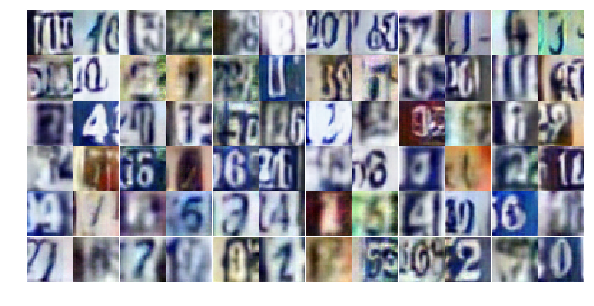

Epoch 24/25... Discriminator Loss: 0.7677... Generator Loss: 1.4486
Epoch 24/25... Discriminator Loss: 1.2402... Generator Loss: 0.8089
Epoch 24/25... Discriminator Loss: 1.5800... Generator Loss: 0.4409
Epoch 24/25... Discriminator Loss: 1.7028... Generator Loss: 0.3839
Epoch 24/25... Discriminator Loss: 1.4480... Generator Loss: 0.5182
Epoch 24/25... Discriminator Loss: 0.8678... Generator Loss: 1.2386
Epoch 24/25... Discriminator Loss: 0.9837... Generator Loss: 0.8962
Epoch 24/25... Discriminator Loss: 0.9421... Generator Loss: 0.9985
Epoch 24/25... Discriminator Loss: 0.9858... Generator Loss: 0.9284
Epoch 24/25... Discriminator Loss: 1.1604... Generator Loss: 1.1588


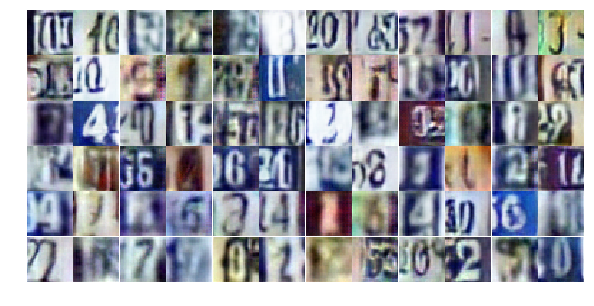

Epoch 24/25... Discriminator Loss: 2.3069... Generator Loss: 3.5131
Epoch 24/25... Discriminator Loss: 1.5591... Generator Loss: 0.4999
Epoch 24/25... Discriminator Loss: 1.2531... Generator Loss: 0.7589
Epoch 24/25... Discriminator Loss: 1.0587... Generator Loss: 0.9054
Epoch 24/25... Discriminator Loss: 1.4261... Generator Loss: 0.5320
Epoch 25/25... Discriminator Loss: 0.8060... Generator Loss: 1.2963
Epoch 25/25... Discriminator Loss: 0.8683... Generator Loss: 1.6549
Epoch 25/25... Discriminator Loss: 0.9479... Generator Loss: 0.9664
Epoch 25/25... Discriminator Loss: 1.0130... Generator Loss: 0.8956
Epoch 25/25... Discriminator Loss: 1.3069... Generator Loss: 0.6167


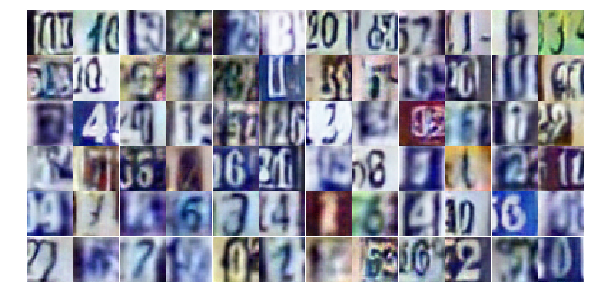

Epoch 25/25... Discriminator Loss: 0.9516... Generator Loss: 0.9562
Epoch 25/25... Discriminator Loss: 1.3690... Generator Loss: 0.5376
Epoch 25/25... Discriminator Loss: 0.8533... Generator Loss: 1.1463
Epoch 25/25... Discriminator Loss: 0.7534... Generator Loss: 1.3064
Epoch 25/25... Discriminator Loss: 0.9297... Generator Loss: 1.5108
Epoch 25/25... Discriminator Loss: 0.9604... Generator Loss: 0.9672
Epoch 25/25... Discriminator Loss: 0.9525... Generator Loss: 1.0080
Epoch 25/25... Discriminator Loss: 0.7927... Generator Loss: 1.2198
Epoch 25/25... Discriminator Loss: 0.7723... Generator Loss: 1.3964
Epoch 25/25... Discriminator Loss: 0.7333... Generator Loss: 1.3283


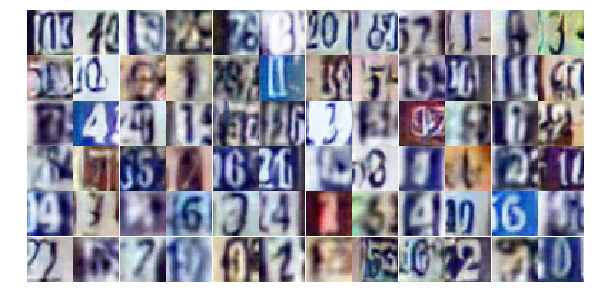

Epoch 25/25... Discriminator Loss: 1.0853... Generator Loss: 2.5047
Epoch 25/25... Discriminator Loss: 0.9749... Generator Loss: 2.6497
Epoch 25/25... Discriminator Loss: 1.2677... Generator Loss: 0.6634
Epoch 25/25... Discriminator Loss: 0.9190... Generator Loss: 1.0645
Epoch 25/25... Discriminator Loss: 0.8446... Generator Loss: 1.1613
Epoch 25/25... Discriminator Loss: 0.7825... Generator Loss: 1.2618
Epoch 25/25... Discriminator Loss: 1.1591... Generator Loss: 0.7353
Epoch 25/25... Discriminator Loss: 1.1542... Generator Loss: 0.7144
Epoch 25/25... Discriminator Loss: 0.6985... Generator Loss: 1.5269
Epoch 25/25... Discriminator Loss: 1.4294... Generator Loss: 0.5749


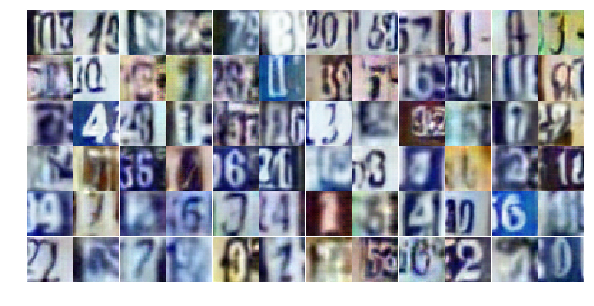

Epoch 25/25... Discriminator Loss: 0.8014... Generator Loss: 1.2117
Epoch 25/25... Discriminator Loss: 0.8194... Generator Loss: 1.1399
Epoch 25/25... Discriminator Loss: 1.0863... Generator Loss: 0.8483
Epoch 25/25... Discriminator Loss: 0.6681... Generator Loss: 1.6236
Epoch 25/25... Discriminator Loss: 0.9472... Generator Loss: 1.0632
Epoch 25/25... Discriminator Loss: 0.7702... Generator Loss: 1.2545
Epoch 25/25... Discriminator Loss: 0.8301... Generator Loss: 1.3883
Epoch 25/25... Discriminator Loss: 1.0107... Generator Loss: 0.8707
Epoch 25/25... Discriminator Loss: 1.2047... Generator Loss: 2.1309
Epoch 25/25... Discriminator Loss: 0.7197... Generator Loss: 1.3606


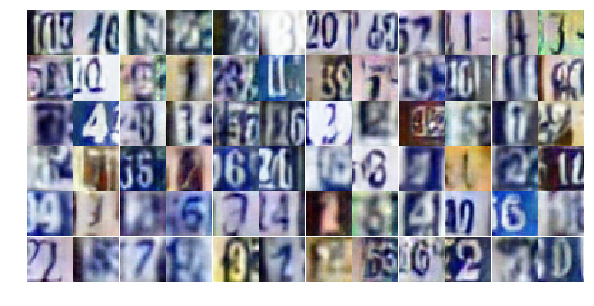

Epoch 25/25... Discriminator Loss: 0.8250... Generator Loss: 1.1749
Epoch 25/25... Discriminator Loss: 0.7629... Generator Loss: 1.3392
Epoch 25/25... Discriminator Loss: 0.9251... Generator Loss: 1.0222
Epoch 25/25... Discriminator Loss: 0.8048... Generator Loss: 1.1758
Epoch 25/25... Discriminator Loss: 1.3809... Generator Loss: 0.6078
Epoch 25/25... Discriminator Loss: 1.1773... Generator Loss: 0.6913
Epoch 25/25... Discriminator Loss: 0.7405... Generator Loss: 1.7062
Epoch 25/25... Discriminator Loss: 0.8693... Generator Loss: 1.0634
Epoch 25/25... Discriminator Loss: 1.4594... Generator Loss: 0.5332
Epoch 25/25... Discriminator Loss: 0.7600... Generator Loss: 1.3045


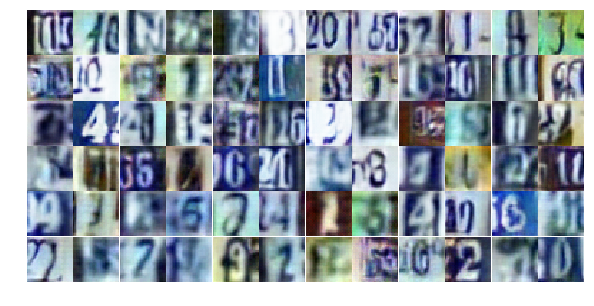

Epoch 25/25... Discriminator Loss: 0.9963... Generator Loss: 1.0281
Epoch 25/25... Discriminator Loss: 1.3082... Generator Loss: 0.6038
Epoch 25/25... Discriminator Loss: 1.0096... Generator Loss: 0.9470
Epoch 25/25... Discriminator Loss: 0.8845... Generator Loss: 1.0638
Epoch 25/25... Discriminator Loss: 1.0792... Generator Loss: 0.9170
Epoch 25/25... Discriminator Loss: 0.6524... Generator Loss: 1.6643
Epoch 25/25... Discriminator Loss: 0.9241... Generator Loss: 1.3535
Epoch 25/25... Discriminator Loss: 0.8262... Generator Loss: 1.2311
Epoch 25/25... Discriminator Loss: 0.8034... Generator Loss: 1.8154
Epoch 25/25... Discriminator Loss: 1.2657... Generator Loss: 0.6899


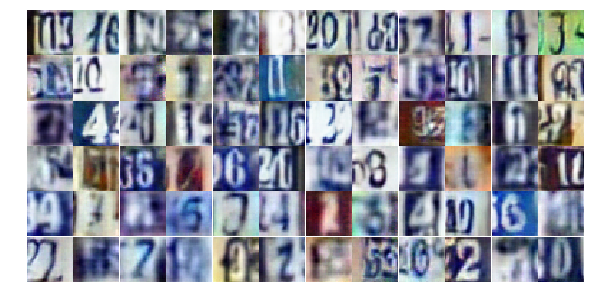

Epoch 25/25... Discriminator Loss: 0.7036... Generator Loss: 2.3382
Epoch 25/25... Discriminator Loss: 1.7719... Generator Loss: 0.4063


In [48]:
# Load the data and train the network here
dataset = Dataset(trainset, testset)
losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

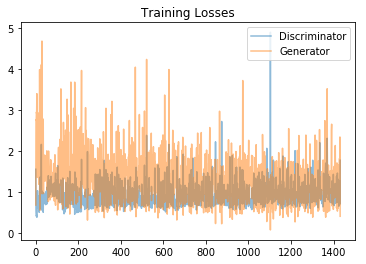

In [49]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

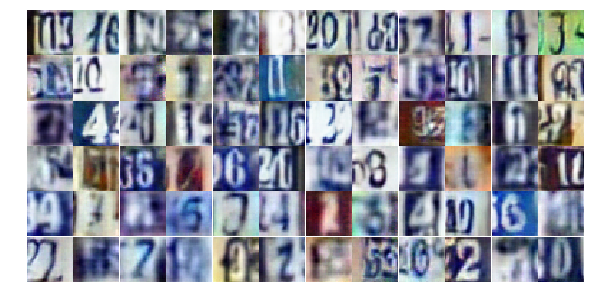

In [50]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))